In [1]:
# Import main librairies
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# For images
from IPython.display import Image

# Ignore warning parts
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Import datasets
sellers = pd.read_csv('olist_sellers_dataset.csv', sep=',')
products = pd.read_csv('olist_products_dataset.csv', sep=',')
orders = pd.read_csv('olist_orders_dataset.csv', sep=',')
order_reviews = pd.read_csv('olist_order_reviews_dataset.csv', sep=',')
order_payments = pd.read_csv('olist_order_payments_dataset.csv', sep=',')
order_items = pd.read_csv('olist_order_items_dataset.csv', sep=',')
geolocation = pd.read_csv('olist_geolocation_dataset.csv', sep=',')
customers = pd.read_csv('olist_customers_dataset.csv', sep=',')
translation = pd.read_csv('product_category_name_translation.csv', sep=',')

In [3]:
# Show all the columns of pandas dataframes
def set_pandas_display_options() -> None:
    display = pd.options.display
    display.max_columns = 50
    display.max_rows = 50
    display.max_colwidth = 100
    display.width = None
    
set_pandas_display_options()

# 1) First view and cleaning of all single datasets

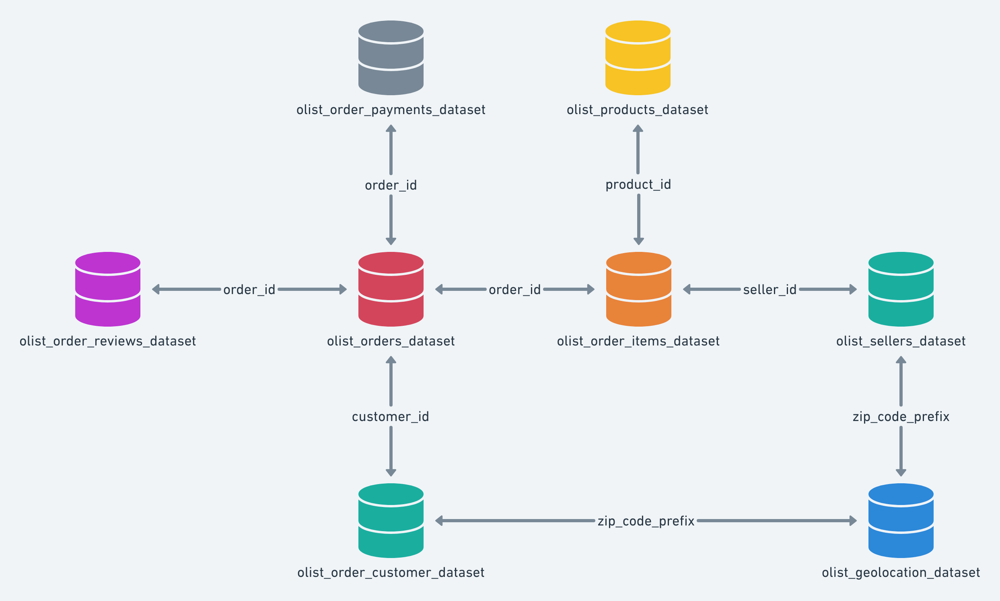

In [4]:
Image(filename = "C:\/Users/33624/Downloads/dataset_scheme_olist.png", width = 800, height = 200)

## 1) a) Dataset 'sellers'

In [5]:
sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [6]:
sellers.shape

(3095, 4)

In [7]:
sellers.isna().sum()

seller_id                 0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
dtype: int64

In [8]:
# Duplicates?
sellers.duplicated().sum()

0

In [9]:
sellers.duplicated('seller_id').sum()

0

In [10]:
# Analysis of different features

# Number of different seller_id
print('number of different seller_id =', 
      len(sellers['seller_id'].unique().tolist()))
print('-------------------------------------------')

# Number of different zip_code_prefix
print('number of different zip_code_prefix =', 
      len(sellers['seller_zip_code_prefix'].unique().tolist()))
print('-------------------------------------------')
      
# Number of different seller_city
print('number of different seller_city =', 
      len(sellers['seller_city'].unique().tolist()))
print('-------------------------------------------')

# Number of different seller_state
print('number of different seller_state =', 
      len(sellers['seller_state'].unique().tolist()))

number of different seller_id = 3095
-------------------------------------------
number of different zip_code_prefix = 2246
-------------------------------------------
number of different seller_city = 611
-------------------------------------------
number of different seller_state = 23


In [11]:
# Number of sellers by seller_zip_code_prefix
sellers['seller_zip_code_prefix'].value_counts().to_dict()

{14940: 49,
 13660: 10,
 16200: 9,
 13920: 9,
 14020: 8,
 87050: 8,
 1026: 8,
 37540: 7,
 13481: 7,
 87015: 6,
 35530: 6,
 18015: 6,
 13560: 5,
 14401: 5,
 12940: 5,
 14075: 5,
 14092: 5,
 82510: 5,
 22790: 5,
 13480: 5,
 81070: 5,
 8710: 5,
 9560: 5,
 14090: 5,
 35501: 4,
 13360: 4,
 9810: 4,
 9230: 4,
 15155: 4,
 14096: 4,
 15025: 4,
 88704: 4,
 14403: 4,
 9111: 4,
 15015: 4,
 36500: 4,
 38400: 4,
 14802: 4,
 37564: 4,
 86010: 4,
 83323: 4,
 18500: 4,
 35570: 4,
 88301: 4,
 31255: 4,
 17400: 4,
 86800: 4,
 80010: 4,
 81350: 4,
 13330: 4,
 13070: 4,
 88330: 4,
 3029: 4,
 87083: 4,
 22793: 4,
 14085: 4,
 80240: 4,
 87025: 4,
 35500: 4,
 35700: 3,
 80710: 3,
 95800: 3,
 88359: 3,
 86706: 3,
 13930: 3,
 13840: 3,
 13043: 3,
 13880: 3,
 83408: 3,
 22775: 3,
 11701: 3,
 13405: 3,
 1123: 3,
 9015: 3,
 14801: 3,
 18040: 3,
 80620: 3,
 8577: 3,
 80220: 3,
 6018: 3,
 9070: 3,
 2310: 3,
 6717: 3,
 86047: 3,
 18550: 3,
 4133: 3,
 8275: 3,
 8223: 3,
 12327: 3,
 14406: 3,
 84010: 3,
 37410: 3,
 85

In [12]:
# Number of sellers by seller_city
sellers['seller_city'].value_counts().to_dict()

{'sao paulo': 694,
 'curitiba': 127,
 'rio de janeiro': 96,
 'belo horizonte': 68,
 'ribeirao preto': 52,
 'guarulhos': 50,
 'ibitinga': 49,
 'santo andre': 45,
 'campinas': 41,
 'maringa': 40,
 'sao jose do rio preto': 33,
 'sorocaba': 32,
 'sao bernardo do campo': 32,
 'osasco': 32,
 'porto alegre': 28,
 'brasilia': 28,
 'londrina': 26,
 'goiania': 23,
 'joinville': 22,
 'blumenau': 21,
 'sao caetano do sul': 20,
 'franca': 20,
 'sao jose dos campos': 18,
 'florianopolis': 18,
 'caxias do sul': 18,
 'limeira': 17,
 'santos': 16,
 'mogi das cruzes': 15,
 'marilia': 15,
 'cascavel': 14,
 'jundiai': 14,
 'bauru': 14,
 'barueri': 13,
 'maua': 13,
 'sao carlos': 13,
 'contagem': 12,
 'piracicaba': 12,
 'presidente prudente': 12,
 'uberlandia': 12,
 'rio claro': 12,
 'araraquara': 11,
 'atibaia': 11,
 'americana': 10,
 'sao jose dos pinhais': 10,
 'carapicuiba': 10,
 'catanduva': 10,
 'itajai': 10,
 'birigui': 10,
 'juiz de fora': 10,
 'praia grande': 10,
 'cotia': 10,
 'brusque': 10,
 'ta

In [13]:
# Show exact values on barplot
def show_values(axs, orient="v", space=.01):
    def _single(ax):
        if orient == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2
                _y = p.get_y() + p.get_height() + (p.get_height()*0.01)
                value = '{:.0f}'.format(p.get_height())
                ax.text(_x, _y, value, ha="center") 
        elif orient == "h":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() + float(space)
                _y = p.get_y() + p.get_height() - (p.get_height()*0.5)
                value = '{:.0f}'.format(p.get_width())
                ax.text(_x, _y, value, ha="left")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _single(ax)
    else:
        _single(axs)

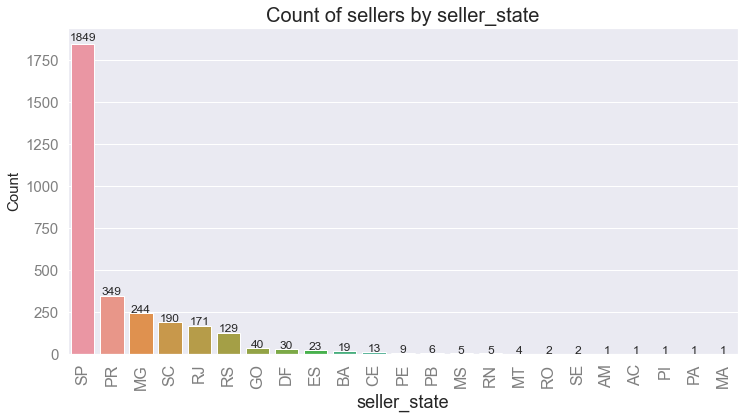

In [14]:
# Count plot of sellers by seller_state

plt.figure(figsize = (12,6))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "seller_state",
                  data = sellers,
                  order = sellers['seller_state'].value_counts().index)
                  # Descending count plot

plt.yticks(fontsize = 15, color = 'grey')
plt.xticks(fontsize = 16, rotation = 90, color = 'grey')

plt.xlabel("seller_state", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of sellers by seller_state", size = 20)

# showing exact values on bars
show_values(g);

### Conclusions for dataset 'sellers' :
- no NaN, no duplicates
- Most of the sellers are from SP state
- Considering this survey concerns e-commerce, the features of this dataset do not seem relevant
- feature 'seller_id" is the key for dataset 'order_items'

## 1) b) Dataset 'products'

In [15]:
products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [16]:
products.shape

(32951, 9)

In [17]:
products.describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,32341.000000,32341.000000,32341.000000,32949.000000,32949.000000,32949.000000,32949.000000
mean,48.476949,771.495285,2.188986,2276.472488,30.815078,16.937661,23.196728
std,10.245741,635.115225,1.736766,4282.038731,16.914458,13.637554,12.079047
min,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000
25%,42.000000,339.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,51.000000,595.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,57.000000,972.000000,3.000000,1900.000000,38.000000,21.000000,30.000000
max,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


In [18]:
products.isna().sum()

product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64

In [19]:
# Duplicates?
products.duplicated().sum()

0

In [20]:
products.duplicated('product_id').sum()

0

In [21]:
# Number of different product_category_name
print('number of different product_category_name =', 
      len(products['product_category_name'].unique().tolist()))

number of different product_category_name = 74


In [22]:
# Number of products by product_category_name
products['product_category_name'].value_counts().to_dict()

{'cama_mesa_banho': 3029,
 'esporte_lazer': 2867,
 'moveis_decoracao': 2657,
 'beleza_saude': 2444,
 'utilidades_domesticas': 2335,
 'automotivo': 1900,
 'informatica_acessorios': 1639,
 'brinquedos': 1411,
 'relogios_presentes': 1329,
 'telefonia': 1134,
 'bebes': 919,
 'perfumaria': 868,
 'fashion_bolsas_e_acessorios': 849,
 'papelaria': 849,
 'cool_stuff': 789,
 'ferramentas_jardim': 753,
 'pet_shop': 719,
 'eletronicos': 517,
 'construcao_ferramentas_construcao': 400,
 'eletrodomesticos': 370,
 'malas_acessorios': 349,
 'consoles_games': 317,
 'moveis_escritorio': 309,
 'instrumentos_musicais': 289,
 'eletroportateis': 231,
 'casa_construcao': 225,
 'livros_interesse_geral': 216,
 'fashion_calcados': 173,
 'moveis_sala': 156,
 'climatizacao': 124,
 'livros_tecnicos': 123,
 'telefonia_fixa': 116,
 'casa_conforto': 111,
 'market_place': 104,
 'alimentos_bebidas': 104,
 'fashion_roupa_masculina': 95,
 'moveis_cozinha_area_de_servico_jantar_e_jardim': 94,
 'sinalizacao_e_seguranca': 93

### Conclusions for dataset 'products':
- 610 NaN for 4 features
- 2 NaN for 4 other features
- except the feature 'product_category_name' (610 NaN - dropna needeed in case this feature is used), the features of this dataset are not relevant for this survey
- feature 'product_id' is the key for dataset 'order_items'

### Cleaning of dataset 'products'

In [23]:
products = products.dropna(subset = ['product_category_name'])

In [24]:
products.isna().sum()

product_id                    0
product_category_name         0
product_name_lenght           0
product_description_lenght    0
product_photos_qty            0
product_weight_g              1
product_length_cm             1
product_height_cm             1
product_width_cm              1
dtype: int64

## 1) c) Dataset 'orders'

In [25]:
orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [26]:
orders.shape

(99441, 8)

In [27]:
orders.isna().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

In [28]:
# Duplicates?
orders.duplicated().sum()

0

In [29]:
orders.duplicated('order_id').sum()

0

In [30]:
orders.duplicated('customer_id').sum()

0

In [31]:
# Number of each order_status
orders['order_status'].value_counts().to_dict()

{'delivered': 96478,
 'shipped': 1107,
 'canceled': 625,
 'unavailable': 609,
 'invoiced': 314,
 'processing': 301,
 'created': 5,
 'approved': 2}

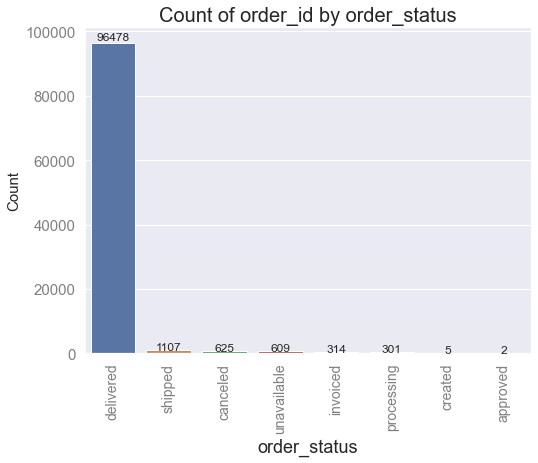

In [32]:
# Count plot of order_id by order_status

plt.figure(figsize = (8,6))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "order_status",
                  data = orders,
                  order = orders['order_status'].value_counts().index)
                  # Descending count plot

plt.yticks(size = 15, color = 'grey')
plt.xticks(size = 14, rotation = 90, color = 'grey')

plt.xlabel("order_status", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of order_id by order_status", size = 20)

# Showing exact values on bars
show_values(g);

In [33]:
# Creating dataframe with only 'delivered' order_status
orders_delivered = orders.loc[orders['order_status'] == 'delivered']

In [34]:
orders_delivered.isna().sum()

order_id                          0
customer_id                       0
order_status                      0
order_purchase_timestamp          0
order_approved_at                14
order_delivered_carrier_date      2
order_delivered_customer_date     8
order_estimated_delivery_date     0
dtype: int64

In [35]:
# Create list of 'order_id' from dataframe 'orders_delivered'
list_order_id_delivered = orders_delivered['order_id'].tolist()

In [36]:
len(list_order_id_delivered)

96478

In [37]:
# Creating dataframe with all order_status except 'delivered'
orders_not_delivered = orders.loc[orders['order_status'] != 'delivered']

In [38]:
orders_not_delivered.isna().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 146
order_delivered_carrier_date     1781
order_delivered_customer_date    2957
order_estimated_delivery_date       0
dtype: int64

In [39]:
# Create list of 'order_id' from dataframe 'orders_not_delivered'
list_order_id_not_delivered = orders_not_delivered['order_id'].tolist()

In [40]:
len(list_order_id_not_delivered)

2963

In [41]:
# Create dataframe to observe count of orders by date
order_time = orders[['order_id','order_purchase_timestamp']]
order_time['order_purchase_timestamp'] = pd.to_datetime(order_time['order_purchase_timestamp'])
order_time['order_purchase_timestamp'] = order_time['order_purchase_timestamp'].dt.date
order_time.sort_values('order_purchase_timestamp', inplace = True)

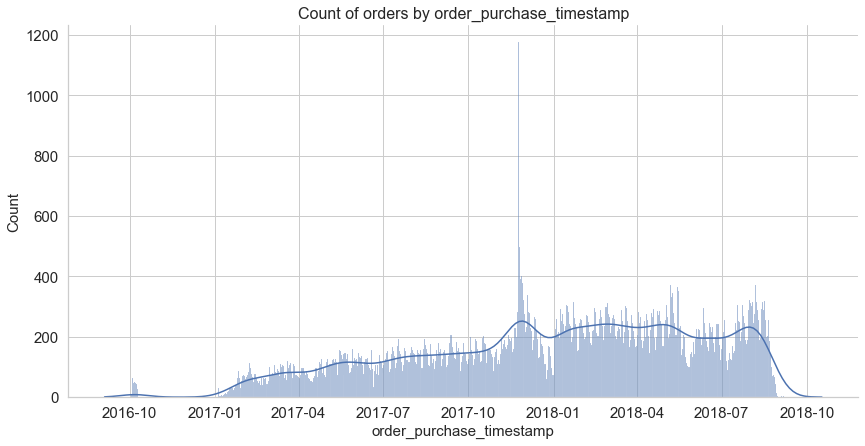

In [42]:
sns.set_theme(style="whitegrid")

g = sns.displot(order_time, x="order_purchase_timestamp", bins=1000, kde = True, height = 6, aspect = 2)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("order_purchase_timestamp", size=15)
plt.ylabel("Count", size=15)

plt.title("Count of orders by order_purchase_timestamp", fontsize=16);

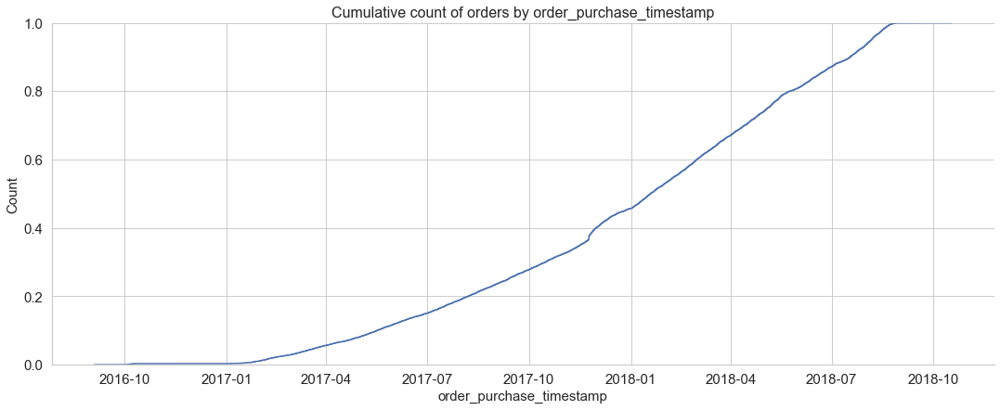

In [43]:
sns.set_theme(style="whitegrid")

g = sns.displot(order_time, x="order_purchase_timestamp", kind = "ecdf", height = 6, aspect = 2.5)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("order_purchase_timestamp", size=15)
plt.ylabel("Count", size=15)

plt.title("Cumulative count of orders by order_purchase_timestamp", fontsize=16);

### Conclusions for dataset 'orders'
- NaN for features 'order_approved_at', 'order_delivered_carrier_date' and 'order_delivered_customer_date', but there is no need to dropna. Indeed 'order_purchase_timestamp' (no NaN) will be used as time feature
- It will be interesting to use the two different datasets 'orders_delivered' and 'orders_not_delivered' as it can impact review scores et and review comment messages

## 1) d) Dataset 'order_reviews'

In [44]:
order_reviews.head(50)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Pá...,2018-03-01 00:00:00,2018-03-02 10:26:53
5,15197aa66ff4d0650b5434f1b46cda19,b18dcdf73be66366873cd26c5724d1dc,1,NaN,NaN,2018-04-13 00:00:00,2018-04-16 00:39:37
6,07f9bee5d1b850860defd761afa7ff16,e48aa0d2dcec3a2e87348811bcfdf22b,5,NaN,NaN,2017-07-16 00:00:00,2017-07-18 19:30:34
7,7c6400515c67679fbee952a7525281ef,c31a859e34e3adac22f376954e19b39d,5,NaN,NaN,2018-08-14 00:00:00,2018-08-14 21:36:06
8,a3f6f7f6f433de0aefbb97da197c554c,9c214ac970e84273583ab523dfafd09b,5,NaN,NaN,2017-05-17 00:00:00,2017-05-18 12:05:37
9,8670d52e15e00043ae7de4c01cc2fe06,b9bf720beb4ab3728760088589c62129,4,recomendo,aparelho eficiente. no site a marca do aparelho esta impresso como 3desinfector e ao chegar esta...,2018-05-22 00:00:00,2018-05-23 16:45:47


In [45]:
order_reviews.shape

(99224, 7)

In [46]:
order_reviews.isna().sum()

review_id                      0
order_id                       0
review_score                   0
review_comment_title       87656
review_comment_message     58247
review_creation_date           0
review_answer_timestamp        0
dtype: int64

In [47]:
# Duplicates ?
order_reviews.duplicated().sum()

0

In [48]:
order_reviews.duplicated('review_id').sum()

814

In [49]:
order_reviews.duplicated('order_id').sum()

551

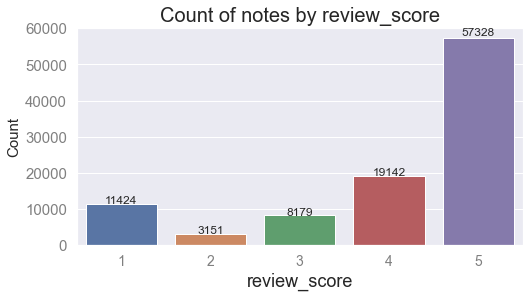

In [50]:
# Countplot of notes by review_score

plt.figure(figsize= (8,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "review_score", 
                  data = order_reviews)

plt.yticks(fontsize = 15, color = 'grey')
plt.xticks(fontsize = 14, color = 'grey')

plt.xlabel("review_score", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of notes by review_score", size = 20)

show_values(g);

In [51]:
# Create dataframe 'orders_order_reviews'
orders_order_reviews = pd.merge(orders[['order_id',
                                        'customer_id',
                                        'order_status',
                                        'order_purchase_timestamp']],
                               order_reviews[['review_id',
                                              'order_id',
                                              'review_score',
                                              'review_comment_message',
                                              'review_creation_date']])

In [52]:
orders_order_reviews.shape

(99224, 8)

In [53]:
# Change Nan by 'None' for features 'review_comment_title' and 'review_comment_message'
orders_order_reviews = orders_order_reviews.fillna(value = {'review_comment_title' : 'None',
                                                            'review_comment_message' : 'None'})

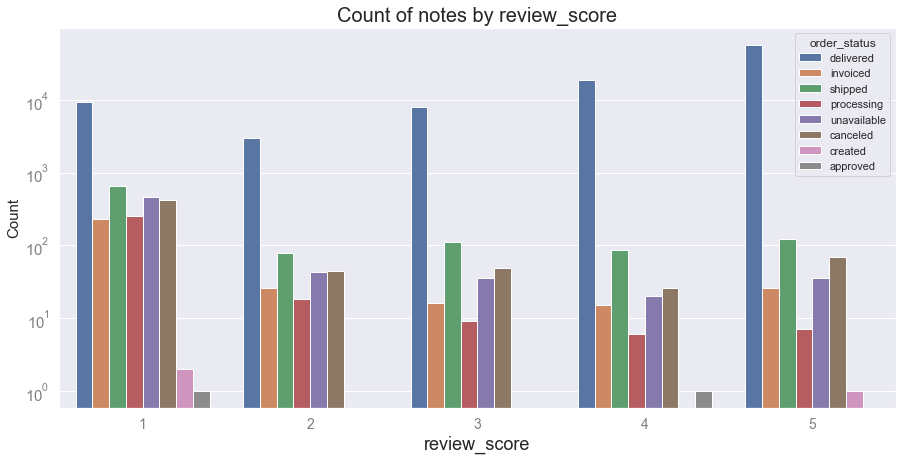

In [54]:
# Countplot of notes by review_score and order_status

plt.figure(figsize= (15,7))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "review_score", 
                  data = orders_order_reviews,
                 hue = 'order_status')

g.set(yscale='log')

plt.yticks(fontsize = 15, color = 'grey')
plt.xticks(fontsize = 14, color = 'grey')

plt.xlabel("review_score", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of notes by review_score", size = 20)

plt.show;

In [55]:
# Change Nan by 'None' for features 'review_comment_title' and 'review_comment_message'
order_reviews = order_reviews.fillna(value = {'review_comment_title' : 'None',
                                              'review_comment_message' : 'None'})

In [56]:
# Number of different review_comment_message
order_reviews['review_comment_message'].value_counts().to_dict()

{'None': 58247,
 'Muito bom': 230,
 'Bom': 189,
 'muito bom': 122,
 'bom': 107,
 'Recomendo': 100,
 'Otimo': 99,
 'otimo': 96,
 'Ótimo': 77,
 'Ótimo ': 74,
 'Ok': 72,
 'Excelente': 71,
 'Muito bom ': 66,
 'recomendo': 65,
 'ok': 55,
 '.': 51,
 'Recomendo ': 50,
 'Boa': 47,
 'Tudo ok': 45,
 'Ótimo produto': 44,
 'Gostei': 37,
 'Não recebi o produto': 37,
 'Muito bom.': 34,
 'Excelente ': 34,
 'excelente': 32,
 'boa': 31,
 'Recomendo.': 27,
 'ótimo': 27,
 'tudo ok': 25,
 'Adorei': 25,
 'Muito bom!': 24,
 'otima': 24,
 'Nota 10': 23,
 'Tudo certo': 23,
 'Gostei muito': 22,
 'Ótimo produto ': 21,
 'Bom produto': 20,
 'Chegou antes do prazo': 20,
 '10': 19,
 'Perfeito': 19,
 'Ótimo produto.': 19,
 'Super recomendo': 18,
 'Bom ': 18,
 'Ótima ': 18,
 'Top': 17,
 'otimo produto': 17,
 'Tudo certo ': 16,
 'Produto muito bom': 16,
 'Satisfeito': 16,
 'Muito bom o produto': 16,
 'bom produto': 15,
 'Produto entregue antes do prazo.': 14,
 'Bom produto.': 14,
 'Não recebi o produto ': 14,
 'super 

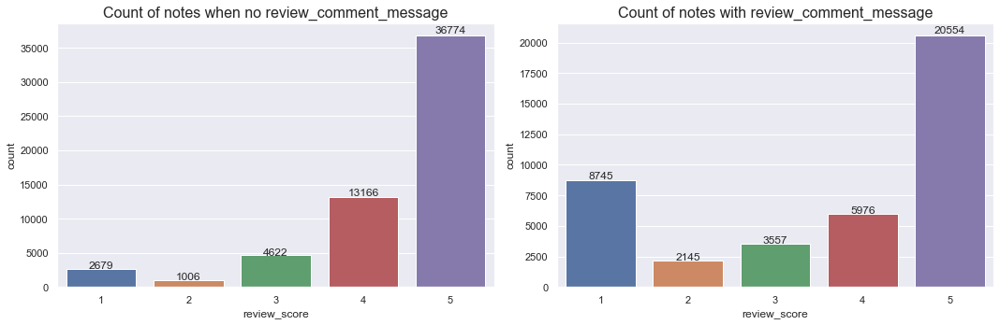

In [57]:
# Count plot for review_score
fig, ax= plt.subplots(ncols=2,figsize=(15,5))

sns.set_theme(style = "darkgrid")

# Create dataframe when 'review_comment_message' == 'None'
no_comment = order_reviews.loc[order_reviews['review_comment_message'] == 'None']

g = sns.countplot(x = 'review_score', 
              data = no_comment, 
              ax=ax[0])

ax[0].set_title("Count of notes when no review_comment_message", size = 16)

show_values(g)

# Create dataframe when 'review_comment_message' != 'None'
comment = order_reviews.loc[order_reviews['review_comment_message'] != 'None']

g = sns.countplot(x = 'review_score', 
              data = comment, 
              ax=ax[1])

ax[1].set_title("Count of notes with review_comment_message", size = 16)

show_values(g)

fig.tight_layout();

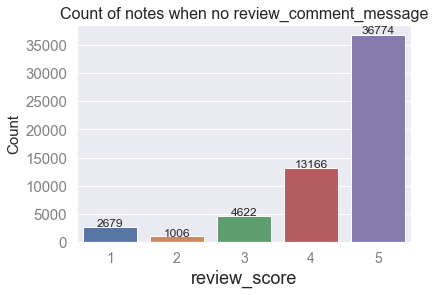

In [58]:
# Count plot of notes by review_score when no 'review_comment_message'

plt.figure(figsize = (6,4))

sns.set_theme(style = "darkgrid")

# Create dataframe when 'review_comment_message' == 'None'
no_comment = order_reviews.loc[order_reviews['review_comment_message'] == 'None']

g = sns.countplot(x = "review_score", 
                  data = no_comment)

plt.yticks(size = 15, color = 'grey')
plt.xticks(size = 14, color = 'grey')

plt.xlabel("review_score", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of notes when no review_comment_message", size = 16)

show_values(g);

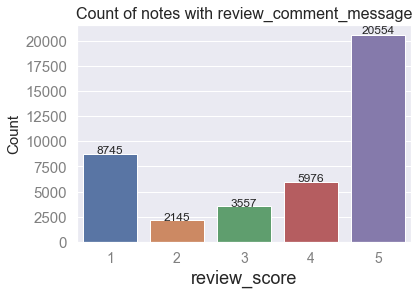

In [59]:
# Count plot of notes by review_score when there is a 'review_comment_message'

plt.figure(figsize = (6,4))

sns.set_theme(style = "darkgrid")

# Create dataframe when 'review_comment_message' != 'None'
comment = order_reviews.loc[order_reviews['review_comment_message'] != 'None']

g = sns.countplot(x = "review_score", 
                  data = comment)

plt.yticks(size = 15, color = 'grey')
plt.xticks(size = 14, color = 'grey')

plt.xlabel("review_score", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of notes with review_comment_message", size = 16)

show_values(g);

In [60]:
# Create 'order_reviews_delivered' dataframe
order_reviews_delivered = order_reviews.loc[order_reviews['order_id'].isin(list_order_id_delivered)]

In [61]:
order_reviews_delivered.shape

(96361, 7)

In [62]:
order_reviews_delivered.isna().sum()

review_id                  0
order_id                   0
review_score               0
review_comment_title       0
review_comment_message     0
review_creation_date       0
review_answer_timestamp    0
dtype: int64

In [63]:
order_reviews_delivered.duplicated('review_id').sum()

714

In [64]:
order_reviews_delivered.duplicated('order_id').sum()

529

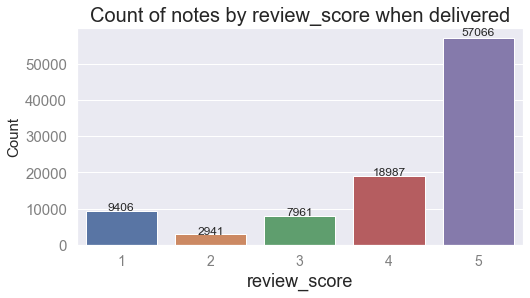

In [65]:
# Countplot of notes by review_score when delivered

plt.figure(figsize= (8,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "review_score", 
                  data = order_reviews_delivered)

plt.yticks(fontsize = 15, color = 'grey')
plt.xticks(fontsize = 14, color = 'grey')

plt.xlabel("review_score", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of notes by review_score when delivered", size = 20)

show_values(g);

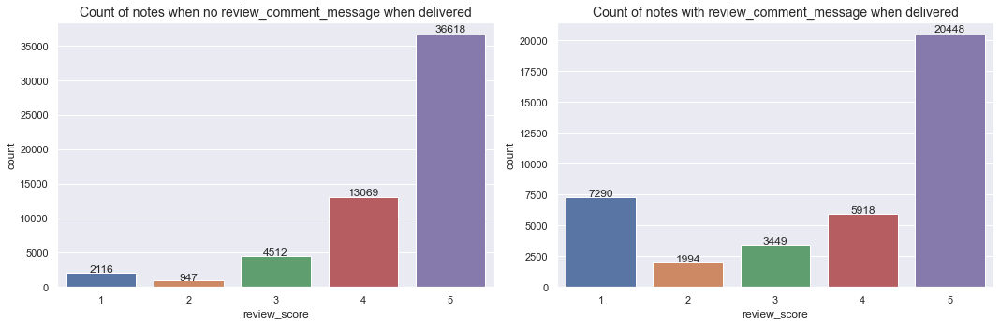

In [66]:
# Count plot for review_score
fig, ax= plt.subplots(ncols=2,figsize=(15,5))

sns.set_theme(style = "darkgrid")

# Create dataframe when 'review_comment_message' == 'None'
no_comment = order_reviews_delivered.loc[order_reviews_delivered['review_comment_message'] == 'None']

g = sns.countplot(x = 'review_score', 
              data = no_comment, 
              ax=ax[0])

ax[0].set_title("Count of notes when no review_comment_message when delivered", size = 14)

show_values(g)

# Create dataframe when 'review_comment_message' != 'None'
comment = order_reviews_delivered.loc[order_reviews_delivered['review_comment_message'] != 'None']

g = sns.countplot(x = 'review_score', 
              data = comment, 
              ax=ax[1])

ax[1].set_title("Count of notes with review_comment_message when delivered", size = 14)

show_values(g)

fig.tight_layout();

In [67]:
# Create 'order_reviews_not_delivered' dataframe
order_reviews_not_delivered = order_reviews.loc[order_reviews['order_id'].isin(list_order_id_not_delivered)]

In [68]:
order_reviews_not_delivered.shape

(2863, 7)

In [69]:
order_reviews_not_delivered.isna().sum()

review_id                  0
order_id                   0
review_score               0
review_comment_title       0
review_comment_message     0
review_creation_date       0
review_answer_timestamp    0
dtype: int64

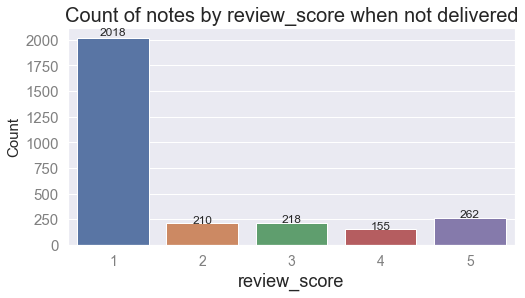

In [70]:
# Countplot of notes by review_score when not delivered

plt.figure(figsize= (8,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "review_score", 
                  data = order_reviews_not_delivered)

plt.yticks(fontsize = 15, color = 'grey')
plt.xticks(fontsize = 14, color = 'grey')

plt.xlabel("review_score", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of notes by review_score when not delivered", size = 20)

show_values(g);

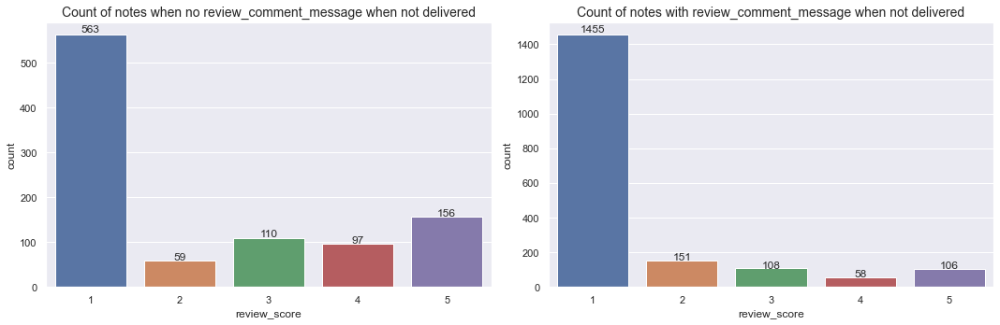

In [71]:
# Count plot for review_score
fig, ax= plt.subplots(ncols=2,figsize=(15,5))

sns.set_theme(style = "darkgrid")

# Create dataframe when 'review_comment_message' == 'None'
no_comment = order_reviews_not_delivered.loc[order_reviews_not_delivered['review_comment_message'] == 'None']

g = sns.countplot(x = 'review_score', 
              data = no_comment, 
              ax=ax[0])

ax[0].set_title("Count of notes when no review_comment_message when not delivered", size = 14)

show_values(g)

# Create dataframe when 'review_comment_message' != 'None'
comment = order_reviews_not_delivered.loc[order_reviews_not_delivered['review_comment_message'] != 'None']

g = sns.countplot(x = 'review_score', 
              data = comment, 
              ax=ax[1])

ax[1].set_title("Count of notes with review_comment_message when not delivered", size = 14)

show_values(g)

fig.tight_layout();

In [72]:
# Creating dataframe reviews only with 'review_id' duplicates
df_reviews_duplicates = order_reviews.loc[order_reviews['review_id'].duplicated(keep = False) == True]
df_reviews_duplicates = df_reviews_duplicates.sort_values(by='review_id')
df_reviews_duplicates.shape

(1603, 7)

In [73]:
df_reviews_duplicates.head(10)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
46678,00130cbe1f9d422698c812ed8ded1919,dfcdfc43867d1c1381bfaf62d6b9c195,1,None,"O cartucho ""original HP"" 60XL não é reconhecido pela impressora, consequentemente não funcionou....",2018-03-07 00:00:00,2018-03-20 18:08:23
29841,00130cbe1f9d422698c812ed8ded1919,04a28263e085d399c97ae49e0b477efa,1,None,"O cartucho ""original HP"" 60XL não é reconhecido pela impressora, consequentemente não funcionou....",2018-03-07 00:00:00,2018-03-20 18:08:23
90677,0115633a9c298b6a98bcbe4eee75345f,78a4201f58af3463bdab842eea4bc801,5,None,None,2017-09-21 00:00:00,2017-09-26 03:27:47
63193,0115633a9c298b6a98bcbe4eee75345f,0c9850b2c179c1ef60d2855e2751d1fa,5,None,None,2017-09-21 00:00:00,2017-09-26 03:27:47
92876,0174caf0ee5964646040cd94e15ac95e,f93a732712407c02dce5dd5088d0f47b,1,None,Produto entregue dentro de embalagem do fornecedor sem os parafusos de fixação das partes.,2018-03-07 00:00:00,2018-03-08 03:00:53
57280,0174caf0ee5964646040cd94e15ac95e,74db91e33b4e1fd865356c89a61abf1f,1,None,Produto entregue dentro de embalagem do fornecedor sem os parafusos de fixação das partes.,2018-03-07 00:00:00,2018-03-08 03:00:53
54832,017808d29fd1f942d97e50184dfb4c13,8daaa9e99d60fbba579cc1c3e3bfae01,5,None,None,2018-03-02 00:00:00,2018-03-05 01:43:30
99167,017808d29fd1f942d97e50184dfb4c13,b1461c8882153b5fe68307c46a506e39,5,None,None,2018-03-02 00:00:00,2018-03-05 01:43:30
20621,0254bd905dc677a6078990aad3331a36,5bf226cf882c5bf4247f89a97c86f273,1,None,"O pedido consta de 2 produtos e até agora recebi apenas 1 produto, e o que me preocupa é que o s...",2017-09-09 00:00:00,2017-09-13 09:52:44
96080,0254bd905dc677a6078990aad3331a36,331b367bdd766f3d1cf518777317b5d9,1,None,"O pedido consta de 2 produtos e até agora recebi apenas 1 produto, e o que me preocupa é que o s...",2017-09-09 00:00:00,2017-09-13 09:52:44


-> It is not logical that there is the same review_id for two different order_id (input error ?)  

-> However we can not drop those duplicates. Indeed it would remove associated order_id that are essential for the survey

In [74]:
# Creating dataframe reviews only with 'order_id' duplicates
df_reviews_duplicates_2 = order_reviews.loc[order_reviews['order_id'].duplicated(keep = False) == True]
df_reviews_duplicates_2 = df_reviews_duplicates_2.sort_values(by='order_id')
df_reviews_duplicates_2.shape

(1098, 7)

In [75]:
df_reviews_duplicates_2.head(20)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
25612,89a02c45c340aeeb1354a24e7d4b2c1e,0035246a40f520710769010f752e7507,5,None,None,2017-08-29 00:00:00,2017-08-30 01:59:12
22423,2a74b0559eb58fc1ff842ecc999594cb,0035246a40f520710769010f752e7507,5,None,"Estou acostumada a comprar produtos pelo baratheon. Super confiável, transparência, qualidade e ...",2017-08-25 00:00:00,2017-08-29 21:45:57
22779,ab30810c29da5da8045216f0f62652a2,013056cfe49763c6f66bda03396c5ee3,5,None,None,2018-02-22 00:00:00,2018-02-23 12:12:30
68633,73413b847f63e02bc752b364f6d05ee9,013056cfe49763c6f66bda03396c5ee3,4,None,None,2018-03-04 00:00:00,2018-03-05 17:02:00
854,830636803620cdf8b6ffaf1b2f6e92b2,0176a6846bcb3b0d3aa3116a9a768597,5,None,None,2017-12-30 00:00:00,2018-01-02 10:54:06
83224,d8e8c42271c8fb67b9dad95d98c8ff80,0176a6846bcb3b0d3aa3116a9a768597,5,None,None,2017-12-30 00:00:00,2018-01-02 10:54:47
17582,017f0e1ea6386de662cbeba299c59ad1,02355020fd0a40a0d56df9f6ff060413,1,None,ja reclamei varias vezes e ate hoje não sei onde foi parar o produto que comprei. quero cancelar...,2018-03-29 00:00:00,2018-03-30 03:16:19
89888,0c8e7347f1cdd2aede37371543e3d163,02355020fd0a40a0d56df9f6ff060413,3,None,UM DOS PRODUTOS (ENTREGA02) COMPRADOS NESTE PEDIDO NAO RECEBI AINDA E OUTRO (ENTREGA01) RECEBI E...,2018-03-21 00:00:00,2018-03-22 01:32:08
55137,61fe4e7d1ae801bbe169eb67b86c6eda,029863af4b968de1e5d6a82782e662f5,4,None,None,2017-07-19 00:00:00,2017-07-20 12:06:11
37911,04d945e95c788a3aa1ffbee42105637b,029863af4b968de1e5d6a82782e662f5,5,None,None,2017-07-14 00:00:00,2017-07-17 13:58:06


-> We keep only the most recent review for each order_id 

In [76]:
# OWe keep only the most recent review for each order_id ('order_id')
orders_order_reviews = orders_order_reviews.sort_values(by = 'review_creation_date', 
                                                        ascending = False)
orders_order_reviews = orders_order_reviews.drop_duplicates(subset = ['order_id'],
                                                            keep ='first')

In [77]:
# Check for all duplicates removed
orders_order_reviews.loc[orders_order_reviews['order_id'].duplicated(keep = False) == True]

,order_id,customer_id,order_status,order_purchase_timestamp,review_id,review_score,review_comment_message,review_creation_date


In [78]:
orders_order_reviews

,order_id,customer_id,order_status,order_purchase_timestamp,review_id,review_score,review_comment_message,review_creation_date
31345,c3a4dcc5c4ae575cb04444cf1b3f0a09,4f24efa07ad431bbb04c7f1eb54a19bf,delivered,2018-08-26 19:56:12,36a152002b9582c0fc15289c844ec53d,5,None,2018-08-31 00:00:00
2549,748db62700c925a0db2c4b00ee25849c,d065739818d474d19dfdb51d54c0a1e9,delivered,2018-08-25 11:24:40,3e8a6b00ddbf02e6dc77b123e46c5573,5,None,2018-08-31 00:00:00
93207,9e49e81744d0890cd05aeb8d8c10d28a,3771914eaea4a652b9eda2ad97add048,delivered,2018-08-21 13:32:24,d647e13487e7f828f9ed6a8e72de0c6a,5,None,2018-08-31 00:00:00
49179,a2e9aa14d517e240f6e7c7243dc1f639,546c4d8cb9e45e600960e1b04f49db65,delivered,2018-08-14 12:28:49,8c9557936286091faaf737133f68d287,4,None,2018-08-31 00:00:00
59300,cd5343ffb012a7157ddbcf5720100c01,c6ae270b58b4692321a73aa741d183af,delivered,2018-08-26 12:38:57,05d3874965dd1ba4330bab86c5fff9aa,1,Fiz o pedido de dois kits de progressiva e só me foi entregue um \r\nO que eu faço agora para pe...,2018-08-31 00:00:00
...,...,...,...,...,...,...,...,...
46389,9aa3197e4887919fde0307fc23601d7a,31a4ecf0bd3ea9436b7132bac1a1bdb3,delivered,2016-10-06 13:16:56,b2d5d8db2a841d27a72e4c06c6212368,4,Só chegou uma parte do pedido ate agora..,2016-10-15 00:00:00
27449,e2144124f98f3bf46939bc5183104041,bd0342f59a3b8ddc416bd048b2b5d0fb,delivered,2016-10-06 20:06:26,743d98b1a4782f0646898fc915ef002a,4,None,2016-10-15 00:00:00
53552,e5215415bb6f76fe3b7cb68103a0d1c0,b6f6cbfc126f1ae6723fe2f9b3751208,canceled,2016-10-22 08:25:27,49f695dffa457eaba90d388a5c37e942,1,"PRODUTO NÃO CHEGOU,E JÁ PASSOU O PRAZO DE ENTREGA",2016-10-09 00:00:00
30661,bfbd0f9bdef84302105ad712db648a6c,86dc2ffce2dfff336de2f386a786e574,delivered,2016-09-15 12:16:38,6916ca4502d6d3bfd39818759d55d536,1,nao recebi o produto e nem resposta da empresa,2016-10-06 00:00:00


### Conclusion for order_reviews dataset :
- the distribution of review_scores depends on : review_score_comment or not, delivered or not
- duplicates for feature 'review_id' are kept
- duplicates for feature 'order_id' are dropped (we keep most recent 'order_id' duplicate)
- merged dataframe 'orders_order_reviews' has been created for the continuation of the survey

## 1) e) Dataset 'order_payments'

In [79]:
order_payments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [80]:
order_payments.shape

(103886, 5)

In [81]:
order_payments.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853349,154.100380
std,0.706584,2.687051,217.494064
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


In [82]:
order_payments.isna().sum()

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64

In [83]:
# Duplicates?
order_payments.duplicated().sum()

0

In [84]:
order_payments.duplicated('order_id').sum()

4446

In [85]:
order_payments.loc[order_payments['payment_installments'] == 1].shape

(52546, 5)

In [86]:
order_payments.loc[order_payments['payment_installments'] == 1].sort_values(by = 'order_id').head(20)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
50570,00048cc3ae777c65dbb7d2a0634bc1ea,1,boleto,1,34.59
35027,00054e8431b9d7675808bcb819fb4a32,1,credit_card,1,31.75
63353,0005f50442cb953dcd1d21e1fb923495,1,credit_card,1,65.39
85982,0008288aa423d2a3f00fcb17cd7d8719,1,boleto,1,126.54
79875,0009792311464db532ff765bf7b182ae,1,boleto,1,127.55
28966,000aed2e25dbad2f9ddb70584c5a2ded,1,credit_card,1,152.77
75938,000c3e6612759851cc3cbb4b83257986,1,boleto,1,112.71
41628,000e63d38ae8c00bbcb5a30573b99628,1,credit_card,1,56.78
97203,000f25f4d72195062c040b12dce9a18a,1,credit_card,1,164.39
103069,0010dedd556712d7bb69a19cb7bbd37a,1,boleto,1,111.12


In [87]:
order_payments.loc[order_payments['payment_installments'] != 1].shape

(51340, 5)

In [88]:
order_payments.loc[order_payments['payment_installments'] != 1].sort_values(by = 'order_id').head(20)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
85283,00010242fe8c5a6d1ba2dd792cb16214,1,credit_card,2,72.19
2499,00018f77f2f0320c557190d7a144bdd3,1,credit_card,3,259.83
12393,000229ec398224ef6ca0657da4fc703e,1,credit_card,5,216.87
32971,00024acbcdf0a6daa1e931b038114c75,1,credit_card,2,25.78
98711,00042b26cf59d7ce69dfabb4e55b4fd9,1,credit_card,3,218.04
22082,000576fe39319847cbb9d288c5617fa6,1,credit_card,10,880.75
100792,0005a1a1728c9d785b8e2b08b904576c,1,credit_card,3,157.60
2851,00061f2a7bc09da83e415a52dc8a4af1,1,credit_card,3,68.87
37403,00063b381e2406b52ad429470734ebd5,1,credit_card,5,57.98
30765,0006ec9db01a64e59a68b2c340bf65a7,1,credit_card,4,97.32


In [89]:
order_payments.loc[order_payments['payment_sequential'] != 1].shape

(4526, 5)

In [90]:
order_payments.loc[order_payments['payment_sequential'] != 1].sort_values(by = 'order_id').head(20)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
80856,0016dfedd97fc2950e388d2971d718c7,2,voucher,1,17.92
98894,002f19a65a2ddd70a090297872e6d64e,2,voucher,1,33.18
30155,0071ee2429bc1efdc43aa3e073a5290e,2,voucher,1,92.44
16459,009ac365164f8e06f59d18a08045f6c4,2,voucher,1,4.50
15298,009ac365164f8e06f59d18a08045f6c4,6,voucher,1,4.17
32058,009ac365164f8e06f59d18a08045f6c4,4,voucher,1,5.45
285,009ac365164f8e06f59d18a08045f6c4,5,voucher,1,8.75
73837,009ac365164f8e06f59d18a08045f6c4,3,voucher,1,8.25
27191,00ac05fe0fc047c54418098eb64e3aaa,2,debit_card,1,123.47
12874,00b4a910f64f24dbcac04fe54088a443,2,voucher,1,48.05


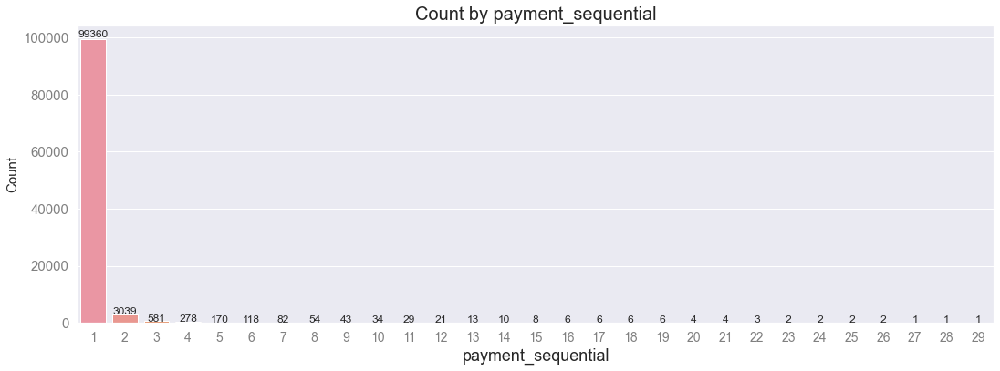

In [91]:
# Répartition du nombre de lignes par payment_sequential
# sous forme de barplot

plt.figure(figsize = (18,6))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "payment_sequential", 
                  data = order_payments)

plt.yticks(size = 15, color = 'grey')
plt.xticks(size = 14, color = 'grey')

plt.xlabel("payment_sequential", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count by payment_sequential", size = 20)

show_values(g);

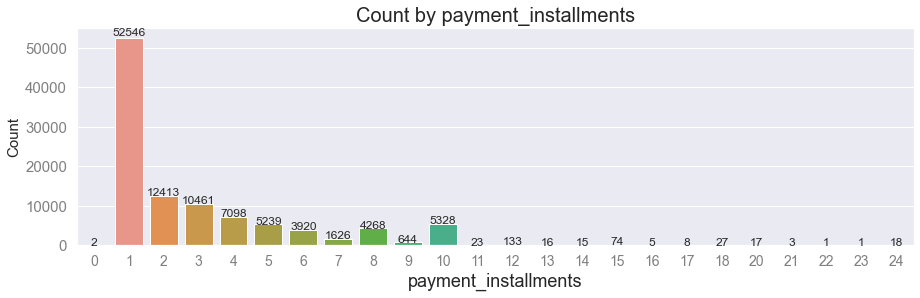

In [92]:
# Répartition du nombre de lignes par payment_installments
# sous forme de barplot

plt.figure(figsize = (15,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "payment_installments", 
                  data = order_payments)

plt.yticks(size = 15, color = 'grey')
plt.xticks(size = 14, color = 'grey')

plt.xlabel("payment_installments",  size = 18)
plt.ylabel("Count",  size = 15)

plt.title("Count by payment_installments", size = 20)

show_values(g);

In [93]:
# Number of payments by payment_type
order_payments['payment_type'].value_counts().to_dict()

{'credit_card': 76795,
 'boleto': 19784,
 'voucher': 5775,
 'debit_card': 1529,
 'not_defined': 3}

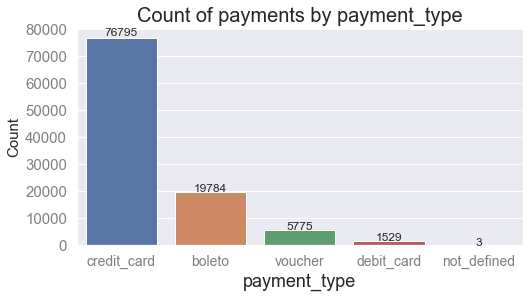

In [94]:
# Count plot of payments by payment_type

plt.figure(figsize = (8,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "payment_type", 
                  data = order_payments)

plt.yticks(size = 15, color = 'grey')
plt.xticks(size = 14, color = 'grey')

plt.xlabel("payment_type",  size = 18)
plt.ylabel("Count",  size = 15)

plt.title("Count of payments by payment_type", size = 20)

show_values(g);

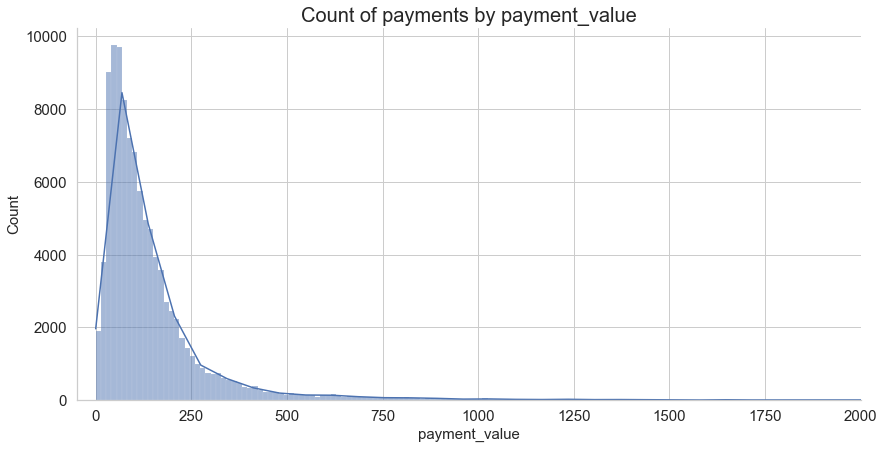

In [95]:
# Displot of payment_value

sns.set_theme(style = "whitegrid")

sns.displot(order_payments, 
            x = "payment_value", 
            bins = 1000, 
            kde = True, 
            height = 6, 
            aspect = 2)

plt.yticks(size = 15)
plt.xticks(size = 15)

plt.xlabel("payment_value", size = 15)
plt.ylabel("Count", size = 15)

plt.xlim(-50, 2000)

plt.title("Count of payments by payment_value", size = 20);

### Conlusions for dataset 'order_payments'
- features do not seem essential for the survey

## 1) f) Dataset 'order_items'

In [96]:
order_items.head(10)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
5,00048cc3ae777c65dbb7d2a0634bc1ea,1,ef92defde845ab8450f9d70c526ef70f,6426d21aca402a131fc0a5d0960a3c90,2017-05-23 03:55:27,21.90,12.69
6,00054e8431b9d7675808bcb819fb4a32,1,8d4f2bb7e93e6710a28f34fa83ee7d28,7040e82f899a04d1b434b795a43b4617,2017-12-14 12:10:31,19.90,11.85
7,000576fe39319847cbb9d288c5617fa6,1,557d850972a7d6f792fd18ae1400d9b6,5996cddab893a4652a15592fb58ab8db,2018-07-10 12:30:45,810.00,70.75
8,0005a1a1728c9d785b8e2b08b904576c,1,310ae3c140ff94b03219ad0adc3c778f,a416b6a846a11724393025641d4edd5e,2018-03-26 18:31:29,145.95,11.65
9,0005f50442cb953dcd1d21e1fb923495,1,4535b0e1091c278dfd193e5a1d63b39f,ba143b05f0110f0dc71ad71b4466ce92,2018-07-06 14:10:56,53.99,11.40


In [97]:
order_items.shape

(112650, 7)

In [98]:
order_items.describe()

,order_item_id,price,freight_value
count,112650.000000,112650.000000,112650.000000
mean,1.197834,120.653739,19.990320
std,0.705124,183.633928,15.806405
min,1.000000,0.850000,0.000000
25%,1.000000,39.900000,13.080000
50%,1.000000,74.990000,16.260000
75%,1.000000,134.900000,21.150000
max,21.000000,6735.000000,409.680000


In [99]:
order_items.isna().sum()

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64

In [100]:
# Duplicates?
order_items.duplicated().sum()

0

In [101]:
order_items.duplicated('order_id').sum()

13984

In [102]:
# Creating dataframe reviews only with duplicates
df_items_duplicates = order_items.loc[order_items['order_id'].duplicated(keep = False) == True]
df_items_duplicates = df_items_duplicates.sort_values(by='order_id')
df_items_duplicates.shape

(23787, 7)

In [103]:
df_items_duplicates.head(10)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
13,0008288aa423d2a3f00fcb17cd7d8719,1,368c6c730842d78016ad823897a372db,1f50f920176fa81dab994f9023523100,2018-02-21 02:55:52,49.90,13.37
14,0008288aa423d2a3f00fcb17cd7d8719,2,368c6c730842d78016ad823897a372db,1f50f920176fa81dab994f9023523100,2018-02-21 02:55:52,49.90,13.37
32,00143d0f86d6fbd9f9b38ab440ac16f5,1,e95ee6822b66ac6058e2e4aff656071a,a17f621c590ea0fab3d5d883e1630ec6,2017-10-20 16:07:52,21.33,15.10
33,00143d0f86d6fbd9f9b38ab440ac16f5,2,e95ee6822b66ac6058e2e4aff656071a,a17f621c590ea0fab3d5d883e1630ec6,2017-10-20 16:07:52,21.33,15.10
34,00143d0f86d6fbd9f9b38ab440ac16f5,3,e95ee6822b66ac6058e2e4aff656071a,a17f621c590ea0fab3d5d883e1630ec6,2017-10-20 16:07:52,21.33,15.10
42,001ab0a7578dd66cd4b0a71f5b6e1e41,1,0b0172eb0fd18479d29c3bc122c058c2,5656537e588803a555b8eb41f07a944b,2018-01-04 02:33:42,24.89,17.63
43,001ab0a7578dd66cd4b0a71f5b6e1e41,2,0b0172eb0fd18479d29c3bc122c058c2,5656537e588803a555b8eb41f07a944b,2018-01-04 02:33:42,24.89,17.63
44,001ab0a7578dd66cd4b0a71f5b6e1e41,3,0b0172eb0fd18479d29c3bc122c058c2,5656537e588803a555b8eb41f07a944b,2018-01-04 02:33:42,24.89,17.63
49,001d8f0e34a38c37f7dba2a37d4eba8b,2,e67307ff0f15ade43fcb6e670be7a74c,f4aba7c0bca51484c30ab7bdc34bcdd1,2017-05-18 17:35:11,18.99,7.78
48,001d8f0e34a38c37f7dba2a37d4eba8b,1,e67307ff0f15ade43fcb6e670be7a74c,f4aba7c0bca51484c30ab7bdc34bcdd1,2017-05-18 17:35:11,18.99,7.78


In [104]:
order_items.duplicated('product_id').sum()

79699

In [105]:
order_items.duplicated('seller_id').sum()

109555

In [106]:
len(order_items['seller_id'].unique().tolist())

3095

In [107]:
# Count number of order_id with several products
len(df_items_duplicates['order_id'].unique().tolist())

9803

### Conclusion for dataset 'order_items'
- feature 'price' will be used to calculate feature 'payments_total'

## 1) g) Dataset 'geolocation'

In [108]:
geolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [109]:
geolocation.shape

(1000163, 5)

In [110]:
geolocation.loc[geolocation['geolocation_state'] != 'SP']

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
22261,2116,-23.515978,-46.582170,são paulo,RN
72852,4011,-23.578707,-46.645779,sao paulo,AC
404270,20010,-22.902472,-43.174059,rio de janeiro,RJ
404271,20011,-22.904813,-43.176236,rio de janeiro,RJ
404272,20021,-22.909710,-43.171322,rio de janeiro,RJ
...,...,...,...,...,...
1000158,99950,-28.068639,-52.010705,tapejara,RS
1000159,99900,-27.877125,-52.224882,getulio vargas,RS
1000160,99950,-28.071855,-52.014716,tapejara,RS
1000161,99980,-28.388932,-51.846871,david canabarro,RS


## 1) h) Dataset 'customers'

In [111]:
customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [112]:
customers.shape

(99441, 5)

In [113]:
customers.isna().sum()

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64

In [114]:
customers.duplicated().sum()

0

In [115]:
customers.duplicated('customer_id').sum()

0

In [116]:
customers.duplicated('customer_unique_id').sum()

3345

In [117]:
number_of_purchases = customers[['customer_id', 'customer_unique_id']].groupby('customer_unique_id').count()
number_of_purchases.sort_values('customer_id')

,customer_id
customer_unique_id,
0000366f3b9a7992bf8c76cfdf3221e2,1
a926cfc9bc7b082335de50450f48eec9,1
a926aae38267e7f54e67de9b5775d0a5,1
a92605ec492805540520d3a73aaeeb6e,1
a925c3e5df82fdc6082f1383d2834998,1
...,...
ca77025e7201e3b30c44b472ff346268,7
6469f99c1f9dfae7733b25662e7f1782,7
1b6c7548a2a1f9037c1fd3ddfed95f33,7


In [118]:
# Number of purchases > 1
(number_of_purchases['customer_id']>1).sum()

2997

In [119]:
# Number of customers by number of purchases
number_of_purchases.value_counts()

customer_id
1              93099
2               2745
3                203
4                 30
5                  8
6                  6
7                  3
9                  1
17                 1
dtype: int64

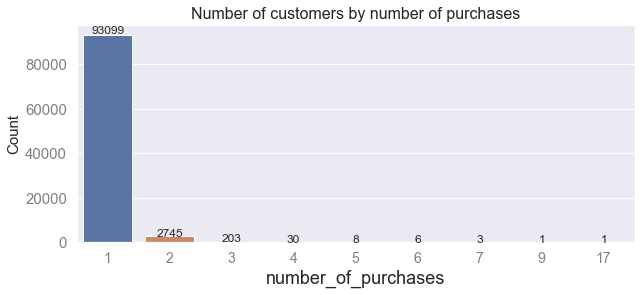

In [120]:
# Number of customers by number of purchases

plt.figure(figsize = (10,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "customer_id", 
                  data = number_of_purchases)

plt.yticks(size = 15, color = 'grey')
plt.xticks(size = 14, color = 'grey')

plt.xlabel("number_of_purchases", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Number of customers by number of purchases", fontsize = 16)

show_values(g);

In [121]:
list_customer_unique_id = customers['customer_unique_id'].unique().tolist()

In [122]:
len(list_customer_unique_id)

96096

In [123]:
# percentage of customers who did several purchases :
(number_of_purchases['customer_id']>1).sum() / len(list_customer_unique_id) * 100

3.1187562437562435

### Conclusions for the dataset 'customers'
- Only 3.1 % of customers ordered more than once

## 1) i) Dataset 'translation'

In [124]:
translation.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [125]:
translation.shape

(71, 2)

In [126]:
orders_order_reviews.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'review_id', 'review_score', 'review_comment_message',
       'review_creation_date'],
      dtype='object')

# 2) Creating dataframe orders_customers containing relevant features :

- customers : customer_id (key), customer_unique_id, customer_state, customer_zip_code_prefix (key)
- orders_order_reviews : order_id (key), customer_id (key), order_status, order_purchase_timestamp, review_id, review_score, review_comment_message
- order_items : order_id (key), order_item_id, product_id (key), seller_id (key), price, freight_value

## 2) a) Merge datasets

In [127]:
orders_customers = pd.merge(orders_order_reviews[['order_id',
                                                  'customer_id',
                                                  'order_status',
                                                  'order_purchase_timestamp',
                                                 'review_id', 
                                                  'review_score', 
                                                  'review_comment_message']],
                           customers[['customer_id',
                                      'customer_unique_id',
                                      'customer_state',
                                      'customer_zip_code_prefix']])

orders_customers = pd.merge(orders_customers,
                            order_items[['order_id',
                                         'order_item_id',
                                         'product_id',
                                         'seller_id',
                                         'price',
                                         'freight_value']])

In [128]:
orders_customers.shape

(111708, 15)

In [129]:
orders_customers.isna().sum()

order_id                    0
customer_id                 0
order_status                0
order_purchase_timestamp    0
review_id                   0
review_score                0
review_comment_message      0
customer_unique_id          0
customer_state              0
customer_zip_code_prefix    0
order_item_id               0
product_id                  0
seller_id                   0
price                       0
freight_value               0
dtype: int64

In [130]:
orders_customers.head()

,order_id,customer_id,order_status,order_purchase_timestamp,review_id,review_score,review_comment_message,customer_unique_id,customer_state,customer_zip_code_prefix,order_item_id,product_id,seller_id,price,freight_value
0,c3a4dcc5c4ae575cb04444cf1b3f0a09,4f24efa07ad431bbb04c7f1eb54a19bf,delivered,2018-08-26 19:56:12,36a152002b9582c0fc15289c844ec53d,5,None,8c446b198f0c92d5db58d3c8eacd3a11,PR,84500,1,391ae69031bcca826279a84f5c4034e8,fffd5413c0700ac820c7069d66d98c89,196.8,42.36
1,748db62700c925a0db2c4b00ee25849c,d065739818d474d19dfdb51d54c0a1e9,delivered,2018-08-25 11:24:40,3e8a6b00ddbf02e6dc77b123e46c5573,5,None,b0df0c28ffa58ea9035f06f993bc717a,MG,37701,1,306b0c58328826c0564cbc520787d508,7ad32824caee82087b3e2e5f33b1bf32,89.0,23.42
2,9e49e81744d0890cd05aeb8d8c10d28a,3771914eaea4a652b9eda2ad97add048,delivered,2018-08-21 13:32:24,d647e13487e7f828f9ed6a8e72de0c6a,5,None,5011569297e6d342cc04f51f923409d6,MG,30535,1,4f00b2fac67879a28298642092faa414,6c177e38df6d3f34182b1f1d427231bf,250.0,19.90
3,a2e9aa14d517e240f6e7c7243dc1f639,546c4d8cb9e45e600960e1b04f49db65,delivered,2018-08-14 12:28:49,8c9557936286091faaf737133f68d287,4,None,0dab841685c250499b36d81dbb570ab8,MA,65302,1,f9b178c9fdc90bbcfbd6c6b49ed47d4c,1025f0e2d44d7041d6cf58b6550e0bfa,70.0,57.26
4,cd5343ffb012a7157ddbcf5720100c01,c6ae270b58b4692321a73aa741d183af,delivered,2018-08-26 12:38:57,05d3874965dd1ba4330bab86c5fff9aa,1,Fiz o pedido de dois kits de progressiva e só me foi entregue um \r\nO que eu faço agora para pe...,4d7b6c39aa3c7b53acb8058e4094a593,SP,5187,1,54f45413afc0d5480c59f5dfeed2d19f,5ab05b6d86d417796c69ffd6774ec832,149.9,18.18


## 2) b) feature engineering

### New feature : review comment

In [131]:
# Creating new feature :
# review_comment = 1 if there is a review_comment_message
# review_comment = 0 if there is not
orders_customers['review_comment'] = (orders_customers['review_comment_message'] != 'None').astype(int)

### New feature : delivery

In [132]:
# Creating new feature :
# delivery = 1 if order_status == delivered
# delivery = 0 if order_status != delivered
orders_customers['delivery'] = (orders_customers['order_status'] == 'delivered').astype(int)

### New feature : last_order_days

In [133]:
orders_customers.dtypes

order_id                     object
customer_id                  object
order_status                 object
order_purchase_timestamp     object
review_id                    object
review_score                  int64
review_comment_message       object
customer_unique_id           object
customer_state               object
customer_zip_code_prefix      int64
order_item_id                 int64
product_id                   object
seller_id                    object
price                       float64
freight_value               float64
review_comment                int32
delivery                      int32
dtype: object

In [134]:
from datetime import datetime, date, time

# Change dtypes 'object' to 'datetime'
orders_customers['order_purchase_timestamp'] = pd.to_datetime(orders_customers['order_purchase_timestamp'])

# Calculate duration between today and order_purchase_timestamp
orders_customers['last_order'] = (datetime.now() - orders_customers['order_purchase_timestamp'])

# Keep number of days only
orders_customers['last_order_days'] = orders_customers['last_order'].astype(str).str[:4].astype(int)

In [135]:
orders_customers.dtypes

order_id                             object
customer_id                          object
order_status                         object
order_purchase_timestamp     datetime64[ns]
review_id                            object
review_score                          int64
review_comment_message               object
customer_unique_id                   object
customer_state                       object
customer_zip_code_prefix              int64
order_item_id                         int64
product_id                           object
seller_id                            object
price                               float64
freight_value                       float64
review_comment                        int32
delivery                              int32
last_order                  timedelta64[ns]
last_order_days                       int32
dtype: object

In [136]:
# Select relevant features for the survey
orders_customers = orders_customers[['order_id',
                                     'customer_id',
                                     'customer_unique_id',
                                     'order_status',
                                     'delivery',
                                     'order_purchase_timestamp',
                                     'last_order',
                                     'last_order_days',
                                     'product_id',
                                     'order_item_id',
                                     'price',
                                     'freight_value',
                                     'review_id',
                                     'review_score',
                                     'review_comment',
                                     'review_comment_message',
                                     'customer_state',
                                     'customer_zip_code_prefix',
                                     'seller_id']]

In [137]:
# Merge with 'sellers' dataset
orders_customers_sellers = pd.merge(orders_customers, sellers)
ocs = orders_customers_sellers

### Splitting dataframe into 3 dataframes :
- customers who ordered just 1 product in 1 purchase
- customers who ordered several products in 1 purchase
- customers with more than 1 purchase

In [138]:
ocs.shape

(111708, 22)

In [139]:
ocs.head()

,order_id,customer_id,customer_unique_id,order_status,delivery,order_purchase_timestamp,last_order,last_order_days,product_id,order_item_id,price,freight_value,review_id,review_score,review_comment,review_comment_message,customer_state,customer_zip_code_prefix,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,c3a4dcc5c4ae575cb04444cf1b3f0a09,4f24efa07ad431bbb04c7f1eb54a19bf,8c446b198f0c92d5db58d3c8eacd3a11,delivered,1,2018-08-26 19:56:12,1270 days 21:06:29.505123,1270,391ae69031bcca826279a84f5c4034e8,1,196.8,42.36,36a152002b9582c0fc15289c844ec53d,5,0,None,PR,84500,fffd5413c0700ac820c7069d66d98c89,13908,amparo,SP
1,f57983ca82e3c9bb09abcdda9139de70,d77129c07a09045897df7b1ecf5b85dc,0c7f5da7d9d33d16ddc25dfafcc513ce,delivered,1,2018-08-11 20:50:44,1285 days 20:11:57.505123,1285,8273821fd2a32fbbc77ad8b743b2a1b9,1,89.0,24.70,1fa8330a0ff58acf91876225c9d1974d,5,1,Equipe baratheon está de parabéns !!! Comparei mais vezes indicarei para as pessoas que conheço ...,SP,3431,fffd5413c0700ac820c7069d66d98c89,13908,amparo,SP
2,30a2f24dd6770c91faa6b3481319204b,de2d4a479a79d4d85c9ce01caf804937,8b27e23ca14dc7d4d8e429abda30b5fb,delivered,1,2018-08-08 11:48:41,1289 days 05:14:00.505123,1289,ebb12274522d82caa7dca657873b2ad7,1,99.8,39.78,13548d0f62b03a0d3cb6efc00877fa13,5,0,None,SP,7700,fffd5413c0700ac820c7069d66d98c89,13908,amparo,SP
3,41d0cc817d720d7f3860716b335a3cb7,0c045d9e471667c05202939897cde7bc,3c068da825c04776514f05089b83ef6b,delivered,1,2018-08-05 00:46:46,1292 days 16:15:55.505123,1292,ebb12274522d82caa7dca657873b2ad7,1,99.8,32.09,c6217f72e7cc770cf87850f919db81fb,5,0,None,SP,13033,fffd5413c0700ac820c7069d66d98c89,13908,amparo,SP
4,633500d08d4de68291b91ac828ef3961,749d4a25eb7bd33a4a39b0b106125744,3cc1026f5863d3b5fc44bd92bad50cee,delivered,1,2018-07-25 12:56:05,1303 days 04:06:36.505123,1303,f74979233a273e0afadf48e39d0c45a4,1,94.6,36.01,8af3bbca529461225450b7d51357ba9c,5,0,None,RS,90420,fffd5413c0700ac820c7069d66d98c89,13908,amparo,SP


In [140]:
# Creating dataframe with no duplicates (1 product/1 purchage for each customer): 
# Dropping all 'customer_unique_id" duplicates
df_no_duplicates = ocs.drop_duplicates(subset = ['customer_unique_id'],
                                       keep = False)
df_no_duplicates.shape

(82993, 22)

In [141]:
# Creating dataframe only with duplicates (several products and several purchases)
df_duplicates = ocs.loc[orders_customers_sellers['customer_unique_id'].duplicated(keep = False) == True]
df_duplicates.shape

(28715, 22)

### Preparing dataframe with 1 product ordered for each customer

In [142]:
# Select relevant features for the survey
df_no_duplicates = df_no_duplicates[['customer_unique_id',
                                     'delivery',
                                     'last_order_days',
                                     'price',
                                     'review_score',
                                     'review_comment']]

In [143]:
# Change names of features
df_no_duplicates = df_no_duplicates.rename(columns={'customer_unique_id' : 'Customer',
                                                    'delivery' : 'deliveries',
                                                    'price' : 'payments_total',
                                                    'review_score' : 'review_score_mean',
                                                    'review_comment' : 'number_of_review_comments'})

# Create new feature : number of purchases
df_no_duplicates['number_of_purchases'] = 1

# Create new feature : number of product by purchases
df_no_duplicates['Number_of_products'] = 1

# Create new feature : percentage of deliveries
df_no_duplicates['percentage_deliveries'] = (df_no_duplicates['deliveries']
                                             / df_no_duplicates['number_of_purchases']
                                             * 100)

# Create new feature : percentage of review comments
df_no_duplicates['percentage_of_review_comments'] = (df_no_duplicates['number_of_review_comments']
                                                  / df_no_duplicates['number_of_purchases']
                                                  * 100)

# Create new feature : mean_payment_by_purchase
df_no_duplicates['mean_payment_by_purchase'] = (df_no_duplicates['payments_total']
                                                / df_no_duplicates['number_of_purchases'])

In [144]:
df_no_duplicates.columns

Index(['Customer', 'deliveries', 'last_order_days', 'payments_total',
       'review_score_mean', 'number_of_review_comments', 'number_of_purchases',
       'Number_of_products', 'percentage_deliveries',
       'percentage_of_review_comments', 'mean_payment_by_purchase'],
      dtype='object')

In [145]:
df_no_duplicates

,Customer,deliveries,last_order_days,payments_total,review_score_mean,number_of_review_comments,number_of_purchases,Number_of_products,percentage_deliveries,percentage_of_review_comments,mean_payment_by_purchase
0,8c446b198f0c92d5db58d3c8eacd3a11,1,1270,196.80,5,0,1,1,100.0,0.0,196.80
1,0c7f5da7d9d33d16ddc25dfafcc513ce,1,1285,89.00,5,1,1,1,100.0,100.0,89.00
2,8b27e23ca14dc7d4d8e429abda30b5fb,1,1289,99.80,5,0,1,1,100.0,0.0,99.80
3,3c068da825c04776514f05089b83ef6b,1,1292,99.80,5,0,1,1,100.0,0.0,99.80
4,3cc1026f5863d3b5fc44bd92bad50cee,1,1303,94.60,5,0,1,1,100.0,0.0,94.60
...,...,...,...,...,...,...,...,...,...,...,...
111702,b39c8c284dd7875b68a31449852cc76a,1,1959,79.99,3,1,1,1,100.0,100.0,79.99
111703,01f156677184504063bd19739f924af1,1,1956,739.98,5,0,1,1,100.0,0.0,739.98
111704,517a3d8518447c776efd430b66470e27,1,1960,248.00,4,1,1,1,100.0,100.0,248.00
111706,24c0806a2407ad1f14b1323849bd246c,1,1960,25.90,4,1,1,1,100.0,100.0,25.90


In [146]:
df_no_duplicates.describe()

,deliveries,last_order_days,payments_total,review_score_mean,number_of_review_comments,number_of_purchases,Number_of_products,percentage_deliveries,percentage_of_review_comments,mean_payment_by_purchase
count,82993.000000,82993.000000,82993.000000,82993.000000,82993.000000,82993.0,82993.0,82993.000000,82993.000000,82993.000000
mean,0.978215,1506.376622,131.300613,4.156122,0.400745,1.0,1.0,97.821503,40.074464,131.300613
std,0.145982,153.487932,198.447533,1.285786,0.490052,0.0,0.0,14.598165,49.005231,198.447533
min,0.000000,1268.000000,0.850000,1.000000,0.000000,1.0,1.0,0.000000,0.000000,0.850000
25%,1.000000,1382.000000,44.890000,4.000000,0.000000,1.0,1.0,100.000000,0.000000,44.890000
50%,1.000000,1487.000000,79.990000,5.000000,0.000000,1.0,1.0,100.000000,0.000000,79.990000
75%,1.000000,1616.000000,144.990000,5.000000,1.000000,1.0,1.0,100.000000,100.000000,144.990000
max,1.000000,1991.000000,6735.000000,5.000000,1.000000,1.0,1.0,100.000000,100.000000,6735.000000


### Preparing dataframe with more than 1 product ordered in 1 purchases for each customer

In [147]:
df_duplicates = df_duplicates.sort_values(by = 'customer_unique_id')
df_duplicates.head(10)

,order_id,customer_id,customer_unique_id,order_status,delivery,order_purchase_timestamp,last_order,last_order_days,product_id,order_item_id,price,freight_value,review_id,review_score,review_comment,review_comment_message,customer_state,customer_zip_code_prefix,seller_id,seller_zip_code_prefix,seller_city,seller_state
18310,44e608f2db00c74a1fe329de44416a4e,a81ebb9b32f102298c0c89635b4b3154,00053a61a98854899e70ed204dd4bafe,delivered,1,2018-02-28 11:15:41,1450 days 05:47:00.505123,1450,62984ea1bba7fcea1f5b57084d3bf885,1,191.00,18.59,333a6ca3cdb01f5f00e3e6be1f1236e1,1,1,"Olá! Comprei dois potes de whey e chegou apenas um! Não consigo rastrear o outro, pois os dois c...",PR,80410,218d46b86c1881d022bce9c68a7d4b15,14070,ribeirao preto,SP
18311,44e608f2db00c74a1fe329de44416a4e,a81ebb9b32f102298c0c89635b4b3154,00053a61a98854899e70ed204dd4bafe,delivered,1,2018-02-28 11:15:41,1450 days 05:47:00.505123,1450,58727e154e8e85d84052cd22b0136c84,2,191.00,18.59,333a6ca3cdb01f5f00e3e6be1f1236e1,1,1,"Olá! Comprei dois potes de whey e chegou apenas um! Não consigo rastrear o outro, pois os dois c...",PR,80410,218d46b86c1881d022bce9c68a7d4b15,14070,ribeirao preto,SP
24208,c6d61340bd8baeedca7cc8e7f7ec07e9,455f2e2988eaf87d7e2ba33b0a57969f,000de6019bb59f34c099a907c151d855,delivered,1,2017-08-17 19:10:33,1644 days 21:52:08.505123,1644,af0a917aec9cea3b353ece61a8825326,1,89.90,10.31,49af8d8f5a31674c3474ab9ea125db04,2,1,A loja recomendo mas não o produto que escolhi. Desejo ser ressarcido. Lençol de sétimo áspero s...,SP,11612,da8622b14eb17ae2831f4ac5b9dab84a,13405,piracicaba,SP
24209,c6d61340bd8baeedca7cc8e7f7ec07e9,455f2e2988eaf87d7e2ba33b0a57969f,000de6019bb59f34c099a907c151d855,delivered,1,2017-08-17 19:10:33,1644 days 21:52:08.505123,1644,9e572ff4654f7064419d97a891a8b0fc,2,139.90,17.33,49af8d8f5a31674c3474ab9ea125db04,2,1,A loja recomendo mas não o produto que escolhi. Desejo ser ressarcido. Lençol de sétimo áspero s...,SP,11612,da8622b14eb17ae2831f4ac5b9dab84a,13405,piracicaba,SP
81973,87440e08790d85796f5b8bc9f5ed2707,4b95f958af9c866353ae1108d8ebd023,000fbf0473c10fc1ab6f8d2d286ce20c,delivered,1,2018-07-26 09:43:52,1302 days 07:18:49.505123,1302,38021cef829efa264df6f9d21c4df6e9,1,119.87,19.14,b6ebd8ff503e058bc1205ee501274c1a,5,0,None,SP,13330,ce248b21cb2adc36282ede306b7660e5,89251,jaragua do sul,SC
81974,87440e08790d85796f5b8bc9f5ed2707,4b95f958af9c866353ae1108d8ebd023,000fbf0473c10fc1ab6f8d2d286ce20c,delivered,1,2018-07-26 09:43:52,1302 days 07:18:49.505123,1302,38021cef829efa264df6f9d21c4df6e9,2,119.87,19.14,b6ebd8ff503e058bc1205ee501274c1a,5,0,None,SP,13330,ce248b21cb2adc36282ede306b7660e5,89251,jaragua do sul,SC
64099,87440e08790d85796f5b8bc9f5ed2707,4b95f958af9c866353ae1108d8ebd023,000fbf0473c10fc1ab6f8d2d286ce20c,delivered,1,2018-07-26 09:43:52,1302 days 07:18:49.505123,1302,d7a3cfa08519494aa1ad181e803617ec,4,23.03,19.14,b6ebd8ff503e058bc1205ee501274c1a,5,0,None,SP,13330,e53d5b9b29d1218281f4a907ada18626,85903,toledo,PR
64098,87440e08790d85796f5b8bc9f5ed2707,4b95f958af9c866353ae1108d8ebd023,000fbf0473c10fc1ab6f8d2d286ce20c,delivered,1,2018-07-26 09:43:52,1302 days 07:18:49.505123,1302,d7a3cfa08519494aa1ad181e803617ec,3,23.03,19.14,b6ebd8ff503e058bc1205ee501274c1a,5,0,None,SP,13330,e53d5b9b29d1218281f4a907ada18626,85903,toledo,PR
3974,533dbcda0a703be171113573af8b3467,5247e5c7e9037e74343f13bbd8800a6a,001147e649a7b1afd577e873841632dd,delivered,1,2017-08-31 17:12:56,1630 days 23:49:45.505123,1630,bdb4be6ce2f7f2b5be0a16088028c7fc,1,85.00,21.08,904cc5ac1727c1509686adc76e267776,4,0,None,PR,87020,955fee9216a65b617aa5c0531780ce60,4782,sao paulo,SP
3975,533dbcda0a703be171113573af8b3467,5247e5c7e9037e74343f13bbd8800a6a,001147e649a7b1afd577e873841632dd,delivered,1,2017-08-31 17:12:56,1630 days 23:49:45.505123,1630,bdb4be6ce2f7f2b5be0a16088028c7fc,2,85.00,21.08,904cc5ac1727c1509686adc76e267776,4,0,None,PR,87020,955fee9216a65b617aa5c0531780ce60,4782,sao paulo,SP


In [148]:
# calculate the number of product for a single purchase
len(df_duplicates.loc[df_duplicates['order_id'] == '44e608f2db00c74a1fe329de44416a4e']['order_item_id'].unique().tolist())

2

In [149]:
# Calculate the number of products ordered by a single customer
dict_numb_of_prod = df_duplicates['customer_unique_id'].value_counts().to_dict()
dict_numb_of_prod

{'c8460e4251689ba205045f3ea17884a1': 24,
 '4546caea018ad8c692964e3382debd19': 21,
 'c402f431464c72e27330a67f7b94d4fb': 20,
 '0f5ac8d5c31de21d2f25e24be15bbffb': 18,
 '8d50f5eadf50201ccdcedfb9e2ac8455': 16,
 'eae0a83d752b1dd32697e0e7b4221656': 15,
 '11f97da02237a49c8e783dfda6f50e8e': 15,
 '31e412b9fb766b6794724ed17a41dfa6': 14,
 '3e43e6105506432c953e165fb2acf44c': 14,
 'f7ea4eef770a388bd5b225acfc546604': 14,
 '7582a5a77fc2976628f46a13ec91b375': 13,
 'd97b3cfb22b0d6b25ac9ed4e9c2d481b': 13,
 '4d99682572b7b5932340a0bce676c18c': 12,
 '4644f1b187e390a08b4c66fb16c91364': 12,
 'ce9f8b9c31d83341764708396ac7e38b': 12,
 '86df00dc5fd68f4dd5d5945ca19f3ed6': 12,
 'ca77025e7201e3b30c44b472ff346268': 12,
 '9eca552063680b7cd2ed0e8aea002b21': 12,
 'd3383e8df3cd44cd351aecff92e34627': 12,
 '37bc3d463e2a0024012a7fa587597a3c': 12,
 '07ff81a9676efa0286ddd3f09e7c0063': 12,
 '33176de67c05eeed870fd49f234387a0': 11,
 '70ad91901ad4330af432978ff134fc6f': 11,
 'efce1ab3e96ccab8b1b464326bd22417': 11,
 'a3dc27d87234f8

In [150]:
# Create new dataframe with the number of order products
df_numb_of_prod = pd.DataFrame(list(dict_numb_of_prod.items()),
                   columns=['Customer', 'Number_of_products'])

In [151]:
# Select the date of the most recent purchase

# Sort by date
df_last_order = df_duplicates.sort_values('order_purchase_timestamp',
                                          ascending = False)

# Keep the line of the customer with the most recent date
df_last_order = df_last_order.drop_duplicates(subset = ['customer_unique_id'],
                                             keep = 'first')

In [152]:
# Merge df_last_order and df_numb_of_prod
df_last_order = df_last_order.rename(columns={'customer_unique_id' : 'Customer'})

df_last_order = df_last_order[['Customer',
                              'last_order_days']]

df = pd.merge(df_last_order, df_numb_of_prod)

In [153]:
# Calculate payments_total for each customer

# Save index for the column "price" in dataframe df_duplicates
index_price = df_duplicates.columns.get_loc('price')
# Create list of customer_unique_id
list_customer_unique_id = df_duplicates['customer_unique_id'].unique().tolist()

# Create new column "payments_total" in df
df["payments_total"] = 0
# Save index for the column "payments_total" in dataframe df
index_payments_total = df.columns.get_loc('payments_total')

# Reset index of dataset df_duplicates
df_duplicates = df_duplicates.reset_index(drop = True)

for customer in list_customer_unique_id:
    # Save list of indexes corresponding to the same customer in df_duplicates
    index_list = df_duplicates.loc[df_duplicates['customer_unique_id'] == customer].index
    # Save index of customer in df
    index_customer = df.loc[df['Customer'] == customer].index
    # Add prices for each customers to obtain 'payment_total'
    df.iloc[index_customer, index_payments_total] = df_duplicates.iloc[index_list, index_price].sum()

In [154]:
# calculate the number of purchases for a single customer
len(df_duplicates.loc[df_duplicates['customer_unique_id'] == '00053a61a98854899e70ed204dd4bafe']['order_id'].unique().tolist())

1

In [155]:
# Calculate number of purchases for each customer

# Create list of customer_unique_id
list_customer_unique_id = df_duplicates['customer_unique_id'].unique().tolist()

# Create new column "number_of_purchases" in df
df["number_of_purchases"] = 0
# Save index for the column "number_of_purchases" in dataframe df
index_number_of_purchases = df.columns.get_loc('number_of_purchases')

for customer in list_customer_unique_id:
    # Save index of customer in df
    index_customer = df.loc[df['Customer'] == customer].index
    # Create dataframe for each customer
    df_customer = df_duplicates.loc[df_duplicates['customer_unique_id'] == customer]
    # Add number_of_purchases for each customers
    df.iloc[index_customer, index_number_of_purchases] = len(df_customer['order_id'].unique().tolist())

In [156]:
# Calculate mean_payment_by_purchase
df['mean_payment_by_purchase'] = (df['payments_total']
                                  / df['number_of_purchases'])

In [157]:
# Calculate number_of_review_comments for each customer

# Create list of customer_unique_id
list_customer_unique_id = df_duplicates['customer_unique_id'].unique().tolist()

# Create new column "number_of_review_comments" in df
df["number_of_review_comments"] = 0
# Save index for the column "number_of_review_comments" in dataframe df
index_number_of_review_comments = df.columns.get_loc('number_of_review_comments')

for customer in list_customer_unique_id:
    # Save index of customer in df
    index_customer = df.loc[df['Customer'] == customer].index
    # Create dataframe for each customer
    df_customer = df_duplicates.loc[df_duplicates['customer_unique_id'] == customer]    
    # Add number_of_review_comment for each customer
    df.iloc[index_customer, index_number_of_review_comments] = len(df_customer['order_id'].unique().tolist())

In [158]:
df_duplicates['review_comment'].value_counts().to_dict()

{0: 14575, 1: 14140}

In [159]:
index_number_of_review_comments

6

In [160]:
df

,Customer,last_order_days,Number_of_products,payments_total,number_of_purchases,mean_payment_by_purchase,number_of_review_comments
0,ff22e30958c13ffe219db7d711e8f564,1263,2,290.00,2,145.00,2
1,5c58de6fb80e93396e2f35642666b693,1268,2,418.00,1,418.00,1
2,afbcfd0b9c5233e7ccc73428526fbb52,1268,5,457.75,1,457.75,1
3,9dfcc502727549f99c9f73dbd28b35e9,1268,2,79.98,1,79.98,1
4,1041688b50cfd8ef6df6086a1746a30c,1268,2,41.80,2,20.90,2
...,...,...,...,...,...,...,...
11723,2e15add79c76241beffe812a24ad3a31,1962,2,129.80,1,129.80,1
11724,a9530b74fe56ca4be9e5f2c7e7c4175a,1962,2,119.80,1,119.80,1
11725,f176923a0a4ab546c7287791ccb82193,1962,2,47.80,1,47.80,1
11726,830d5b7aaa3b6f1e9ad63703bec97d23,1981,3,134.97,1,134.97,1


In [161]:
df['percentage_of_review_comments'] = (df['number_of_review_comments']
                                       / df['number_of_purchases']
                                       * 100)

In [162]:
# Calculate review_score_mean for each customer

# Create list of customer_unique_id
list_customer_unique_id = df_duplicates['customer_unique_id'].unique().tolist()

# Create new column "review_score_mean" in df
df["review_score_mean"] = 0
# Save index for the column "review_score_mean" in dataframe df
index_review_score_mean = df.columns.get_loc('review_score_mean')

for customer in list_customer_unique_id:
    # Save index of customer in df
    index_customer = df.loc[df['Customer'] == customer].index
    # Create dataframe for each customer
    df_customer = df_duplicates.loc[df_duplicates['customer_unique_id'] == customer]        
    # Calculate the mean of review_scores for each customers to obtain 'review_score_mean'
    df.iloc[index_customer, index_review_score_mean] = df_customer['review_score'].mean()

In [163]:
# Calculate number_of_deliveries as 'deliveries' for each customer

# Create list of customer_unique_id
list_customer_unique_id = df_duplicates['customer_unique_id'].unique().tolist()

# Create new column "deliveries" in df
df["deliveries"] = 0
# Save index for the column "deliveries" in dataframe df
index_deliveries = df.columns.get_loc('deliveries')

for customer in list_customer_unique_id:
    # Save index of customer in df
    index_customer = df.loc[df['Customer'] == customer].index
    # Create dataframe for each customer
    df_customer = df_duplicates.loc[df_duplicates['customer_unique_id'] == customer]        
    # Calculate the sum of delivery column for each customers to obtain 'deliveries'
    df.iloc[index_customer, index_deliveries] = df_customer['delivery'].sum()

In [164]:
# Percentage of deliveries
df['percentage_deliveries'] = (df['deliveries']
                               / df['Number_of_products']
                               * 100)

In [165]:
df

,Customer,last_order_days,Number_of_products,payments_total,number_of_purchases,mean_payment_by_purchase,number_of_review_comments,percentage_of_review_comments,review_score_mean,deliveries,percentage_deliveries
0,ff22e30958c13ffe219db7d711e8f564,1263,2,290.00,2,145.00,2,100.0,1.0,0,0.0
1,5c58de6fb80e93396e2f35642666b693,1268,2,418.00,1,418.00,1,100.0,5.0,2,100.0
2,afbcfd0b9c5233e7ccc73428526fbb52,1268,5,457.75,1,457.75,1,100.0,5.0,5,100.0
3,9dfcc502727549f99c9f73dbd28b35e9,1268,2,79.98,1,79.98,1,100.0,2.0,2,100.0
4,1041688b50cfd8ef6df6086a1746a30c,1268,2,41.80,2,20.90,2,100.0,4.5,2,100.0
...,...,...,...,...,...,...,...,...,...,...,...
11723,2e15add79c76241beffe812a24ad3a31,1962,2,129.80,1,129.80,1,100.0,1.0,2,100.0
11724,a9530b74fe56ca4be9e5f2c7e7c4175a,1962,2,119.80,1,119.80,1,100.0,1.0,2,100.0
11725,f176923a0a4ab546c7287791ccb82193,1962,2,47.80,1,47.80,1,100.0,5.0,2,100.0
11726,830d5b7aaa3b6f1e9ad63703bec97d23,1981,3,134.97,1,134.97,1,100.0,1.0,3,100.0


In [166]:
df.describe()

,last_order_days,Number_of_products,payments_total,number_of_purchases,mean_payment_by_purchase,number_of_review_comments,percentage_of_review_comments,review_score_mean,deliveries,percentage_deliveries
count,11728.000000,11728.000000,11728.000000,11728.00000,11728.000000,11728.00000,11728.0,11728.000000,11728.000000,11728.000000
mean,1502.865024,2.448414,219.126297,1.27251,185.414997,1.27251,100.0,3.718346,2.403223,98.205971
std,150.857268,1.107691,305.039617,0.54122,275.113981,0.54122,0.0,1.537995,1.137070,12.386205
min,1263.000000,2.000000,7.800000,1.00000,5.990000,1.00000,100.0,1.000000,0.000000,0.000000
25%,1380.000000,2.000000,86.000000,1.00000,70.000000,1.00000,100.0,3.000000,2.000000,100.000000
50%,1483.000000,2.000000,145.000000,1.00000,119.800000,1.00000,100.0,4.000000,2.000000,100.000000
75%,1607.000000,2.000000,250.000000,1.00000,209.983750,1.00000,100.0,5.000000,2.000000,100.000000
max,1991.000000,24.000000,13440.000000,16.00000,13440.000000,16.00000,100.0,5.000000,24.000000,100.000000


### Concaténation des 2 dataframes (customers avec 1 purchase et plus)

In [167]:
# Concatenate dataframes keeping only common features
data = pd.concat([df_no_duplicates, df], join="inner", ignore_index=True)

In [168]:
df.columns

Index(['Customer', 'last_order_days', 'Number_of_products', 'payments_total',
       'number_of_purchases', 'mean_payment_by_purchase',
       'number_of_review_comments', 'percentage_of_review_comments',
       'review_score_mean', 'deliveries', 'percentage_deliveries'],
      dtype='object')

In [169]:
df_no_duplicates.columns

Index(['Customer', 'deliveries', 'last_order_days', 'payments_total',
       'review_score_mean', 'number_of_review_comments', 'number_of_purchases',
       'Number_of_products', 'percentage_deliveries',
       'percentage_of_review_comments', 'mean_payment_by_purchase'],
      dtype='object')

In [170]:
data

,Customer,deliveries,last_order_days,payments_total,review_score_mean,number_of_review_comments,number_of_purchases,Number_of_products,percentage_deliveries,percentage_of_review_comments,mean_payment_by_purchase
0,8c446b198f0c92d5db58d3c8eacd3a11,1,1270,196.80,5.0,0,1,1,100.0,0.0,196.80
1,0c7f5da7d9d33d16ddc25dfafcc513ce,1,1285,89.00,5.0,1,1,1,100.0,100.0,89.00
2,8b27e23ca14dc7d4d8e429abda30b5fb,1,1289,99.80,5.0,0,1,1,100.0,0.0,99.80
3,3c068da825c04776514f05089b83ef6b,1,1292,99.80,5.0,0,1,1,100.0,0.0,99.80
4,3cc1026f5863d3b5fc44bd92bad50cee,1,1303,94.60,5.0,0,1,1,100.0,0.0,94.60
...,...,...,...,...,...,...,...,...,...,...,...
94716,2e15add79c76241beffe812a24ad3a31,2,1962,129.80,1.0,1,1,2,100.0,100.0,129.80
94717,a9530b74fe56ca4be9e5f2c7e7c4175a,2,1962,119.80,1.0,1,1,2,100.0,100.0,119.80
94718,f176923a0a4ab546c7287791ccb82193,2,1962,47.80,5.0,1,1,2,100.0,100.0,47.80
94719,830d5b7aaa3b6f1e9ad63703bec97d23,3,1981,134.97,1.0,1,1,3,100.0,100.0,134.97


In [171]:
data.describe()

,deliveries,last_order_days,payments_total,review_score_mean,number_of_review_comments,number_of_purchases,Number_of_products,percentage_deliveries,percentage_of_review_comments,mean_payment_by_purchase
count,94721.000000,94721.000000,94721.000000,94721.000000,94721.000000,94721.000000,94721.000000,94721.000000,94721.000000,94721.000000
mean,1.154654,1505.941829,142.174861,4.101918,0.508683,1.033741,1.179337,97.869106,47.494220,138.000854
std,0.631699,153.168244,216.476901,1.327476,0.573698,0.210527,0.616039,14.343304,49.937435,210.222903
min,0.000000,1263.000000,0.850000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.850000
25%,1.000000,1382.000000,47.800000,4.000000,0.000000,1.000000,1.000000,100.000000,0.000000,46.000000
50%,1.000000,1486.000000,89.800000,5.000000,0.000000,1.000000,1.000000,100.000000,0.000000,87.000000
75%,1.000000,1615.000000,155.000000,5.000000,1.000000,1.000000,1.000000,100.000000,100.000000,149.900000
max,24.000000,1991.000000,13440.000000,5.000000,16.000000,16.000000,24.000000,100.000000,100.000000,13440.000000


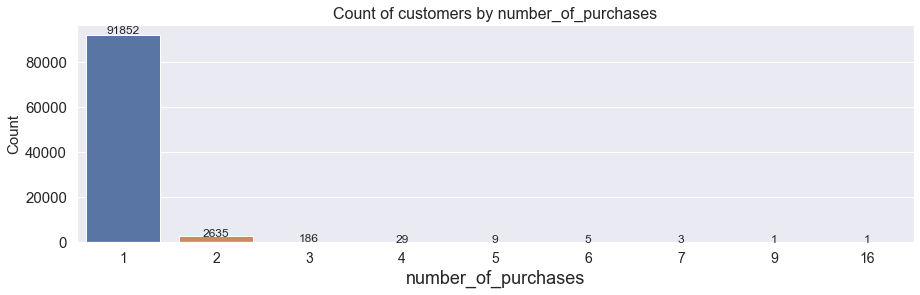

In [172]:
# Count number_of_purchases

plt.figure(figsize = (15,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "number_of_purchases", data = data)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 14)

plt.xlabel("number_of_purchases",  size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of customers by number_of_purchases", fontsize = 16)

show_values(g);

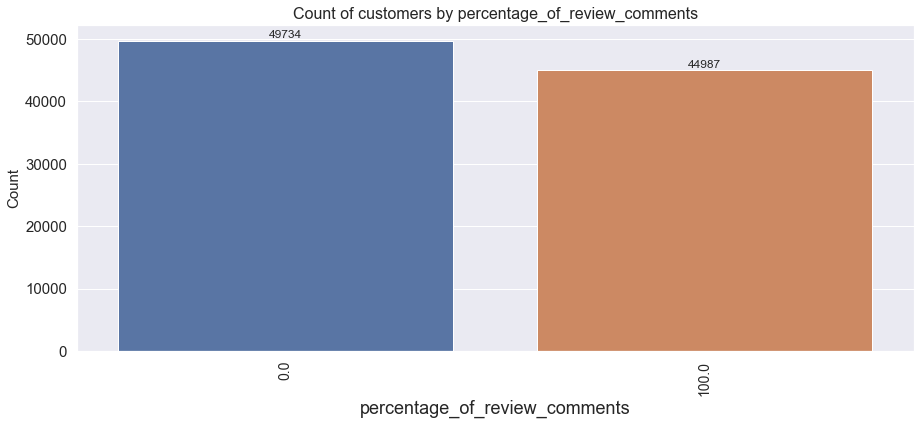

In [173]:
# Count percentage_of_review_comments

plt.figure(figsize = (15,6))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "percentage_of_review_comments", 
                  data = data)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 14, rotation = 90)

plt.xlabel("percentage_of_review_comments", size = 18)
plt.ylabel("Count", size = 15)

plt.title("Count of customers by percentage_of_review_comments", size = 16)

show_values(g);

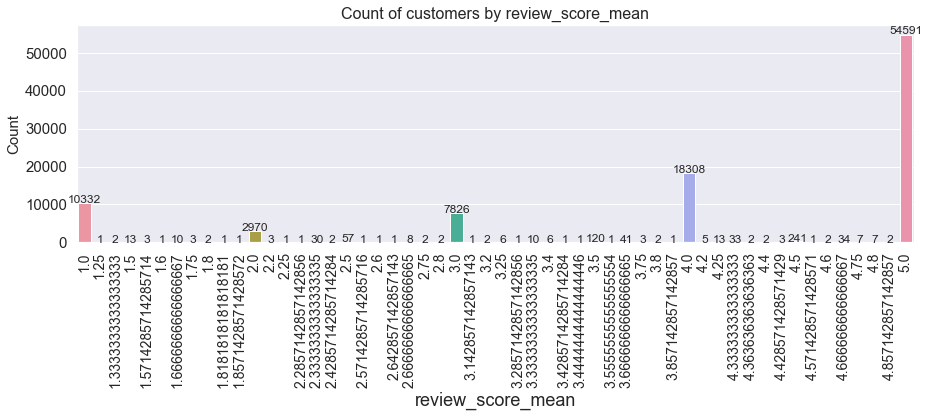

In [174]:
# Count review_score_mean

plt.figure(figsize = (15,4))

sns.set_theme(style = "darkgrid")

g = sns.countplot(x = "review_score_mean", 
                  data = data)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 14, rotation=90)

plt.xlabel("review_score_mean", size=18)
plt.ylabel("Count", size=15)

plt.title("Count of customers by review_score_mean", size=16)

show_values(g);

### Corrélations entre les différentes variables numériques

In [175]:
data.columns

Index(['Customer', 'deliveries', 'last_order_days', 'payments_total',
       'review_score_mean', 'number_of_review_comments', 'number_of_purchases',
       'Number_of_products', 'percentage_deliveries',
       'percentage_of_review_comments', 'mean_payment_by_purchase'],
      dtype='object')

In [176]:
# Create the list of quantitative features
quant_feat = ['deliveries',
              'percentage_deliveries',
              'last_order_days', 
              'payments_total',
              'mean_payment_by_purchase',
              'review_score_mean', 
              'number_of_review_comments', 
              'percentage_of_review_comments', 
              'number_of_purchases',
              'Number_of_products']

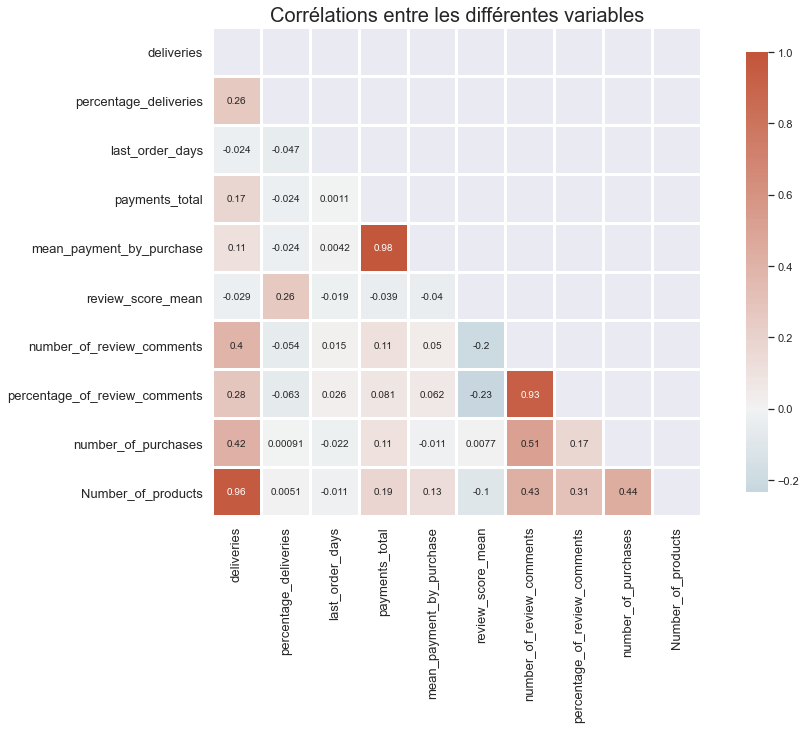

In [177]:
# compute the correlation matrix
corr = data[quant_feat].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(16,9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
colormap = sns.heatmap(corr, 
                       annot=True, 
                       annot_kws ={'size':10}, 
                       mask=mask, 
                       cmap=cmap, 
                       vmax=1, 
                       center=0,
                       square=True, 
                       linewidths=2, 
                       cbar_kws={"shrink": .9})

plt.gca().set_yticklabels(quant_feat)

plt.gca().set_xticklabels(quant_feat)

colormap.set_xticklabels(colormap.get_xmajorticklabels(), size = 13, rotation = 90)
colormap.set_yticklabels(colormap.get_ymajorticklabels(), size = 13)

plt.title('Corrélations entre les différentes variables', size = 20);

-> Relevant features for the survey :  
- last_order_days : not correlated with other features  
- payments_total : lowly correlated with a few features   
- review_score_mean : lowly correlated with a few features   
- percentage_of_review_comments : lowly correlated with a few features
- number_of_purchases : lowly correlated with previously selected features

In [178]:
# Create the list of selected features
sel_feat = ['last_order_days',
            'payments_total',
            'review_score_mean',
            'percentage_of_review_comments',
            'number_of_purchases']

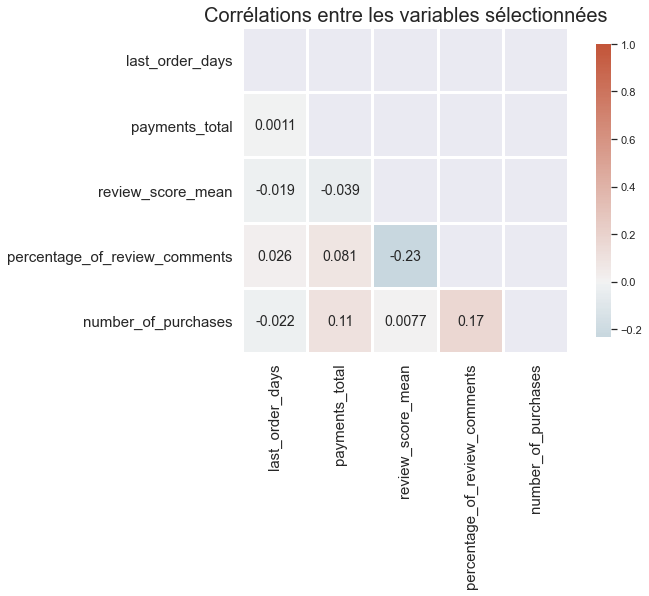

In [179]:
# compute the correlation matrix
corr = data[sel_feat].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(10,6))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
colormap = sns.heatmap(corr, 
                       annot=True, 
                       annot_kws ={'size':14}, 
                       mask=mask, 
                       cmap=cmap, 
                       vmax=1, 
                       center=0,
                       square=True, 
                       linewidths=2, 
                       cbar_kws={"shrink": .9})

plt.gca().set_yticklabels(sel_feat)

plt.gca().set_xticklabels(sel_feat)

colormap.set_xticklabels(colormap.get_xmajorticklabels(), size = 15, rotation = 90)
colormap.set_yticklabels(colormap.get_ymajorticklabels(), size = 15)

plt.title('Corrélations entre les variables sélectionnées', size = 20);

# 3) Réductions dimensionnelles

## 3) a) With only 3 features - orders features :
- last_order_days
- number_of_purchases
- payments_total

In [358]:
data.columns

Index(['Customer', 'deliveries', 'last_order_days', 'payments_total',
       'review_score_mean', 'number_of_review_comments', 'number_of_purchases',
       'Number_of_products', 'percentage_deliveries',
       'percentage_of_review_comments', 'mean_payment_by_purchase'],
      dtype='object')

In [359]:
data_1 = data[['Customer', 
               'number_of_purchases', 
               'payments_total', 
               'last_order_days']]

data_1 = data_1.set_index('Customer')

In [360]:
data_1

,number_of_purchases,payments_total,last_order_days
Customer,,,
8c446b198f0c92d5db58d3c8eacd3a11,1,196.80,1270
0c7f5da7d9d33d16ddc25dfafcc513ce,1,89.00,1285
8b27e23ca14dc7d4d8e429abda30b5fb,1,99.80,1288
3c068da825c04776514f05089b83ef6b,1,99.80,1292
3cc1026f5863d3b5fc44bd92bad50cee,1,94.60,1302
...,...,...,...
2e15add79c76241beffe812a24ad3a31,1,129.80,1961
a9530b74fe56ca4be9e5f2c7e7c4175a,1,119.80,1961
f176923a0a4ab546c7287791ccb82193,1,47.80,1961


In [361]:
data_1.dtypes

number_of_purchases      int64
payments_total         float64
last_order_days          int32
dtype: object

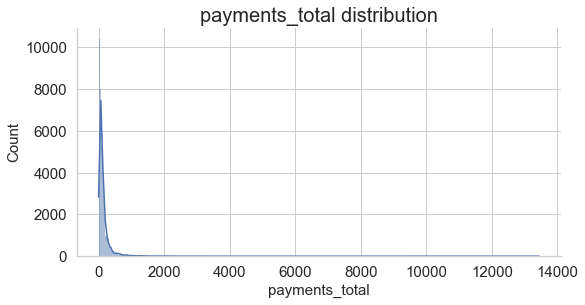

In [401]:
# Displot payments_total

sns.set_theme(style="whitegrid")

sns.displot(data_1, 
            x = "payments_total", 
            bins = 1000, 
            kde = True, 
            height = 4, 
            aspect = 2)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("payments_total", size=15)
plt.ylabel("Count", size=15)

plt.title("payments_total distribution", size=20);

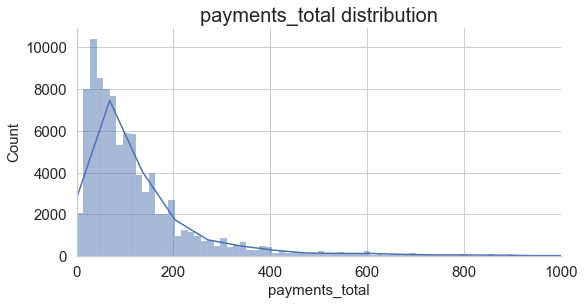

In [402]:
# Displot payments_total (zoom)

sns.set_theme(style="whitegrid")

sns.displot(data_1, 
            x = "payments_total", 
            bins = 1000, 
            kde = True, 
            height = 4, 
            aspect = 2)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("payments_total", size=15)
plt.ylabel("Count", size=15)

plt.xlim(0,1000)

plt.title("payments_total distribution", size=20);

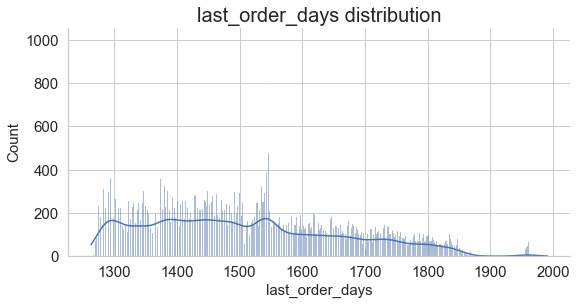

In [403]:
# Displot last_order_days

sns.set_theme(style="whitegrid")

sns.displot(data_1, 
            x = "last_order_days", 
            bins = 1000, 
            kde = True, 
            height = 4, 
            aspect = 2)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("last_order_days", size=15)
plt.ylabel("Count", size=15)

plt.title("last_order_days distribution", size=20);

In [408]:
data_1['last_order_days'].min()

1263

In [409]:
data_1['last_order_days_min'] = data_1['last_order_days'] - data_1['last_order_days'].min() + 1

In [410]:
# Passage au log des features 'last_order_days' et 'payments_total'
data_1['last_order_days_log'] = np.log10(data_1['last_order_days'])
data_1['payments_total_log'] = np.log10(data_1['payments_total'])
data_1['last_order_days_min_log'] = np.log10(data_1['last_order_days_min'])

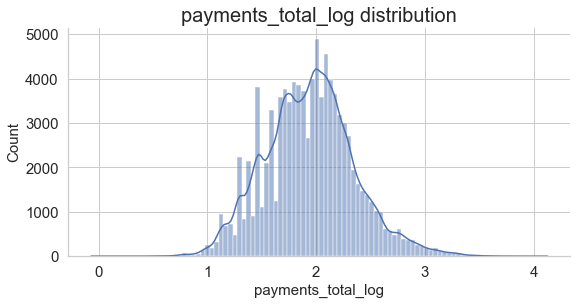

In [406]:
# Displot payments_total

sns.set_theme(style="whitegrid")

sns.displot(data_1, 
            x = "payments_total_log", 
            bins = 100, 
            kde = True, 
            height = 4, 
            aspect = 2)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("payments_total_log", size=15)
plt.ylabel("Count", size=15)

plt.title("payments_total_log distribution", size=20);

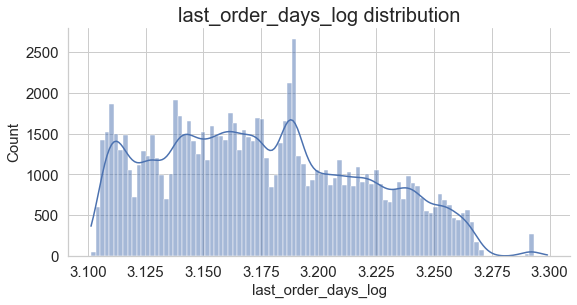

In [407]:
# Displot payments_total

sns.set_theme(style="whitegrid")

sns.displot(data_1, 
            x = "last_order_days_log", 
            bins = 100, 
            kde = True, 
            height = 4, 
            aspect = 2)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("last_order_days_log", size=15)
plt.ylabel("Count", size=15)

plt.title("last_order_days_log distribution", size=20);

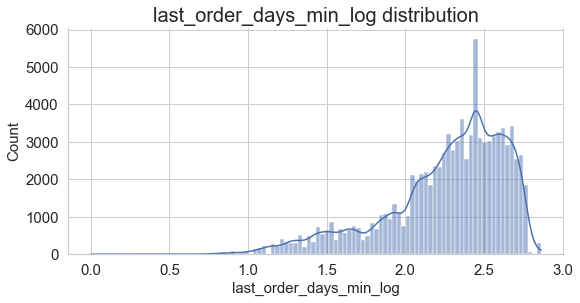

In [411]:
# Displot payments_total

sns.set_theme(style="whitegrid")

sns.displot(data_1, 
            x = "last_order_days_min_log", 
            bins = 100, 
            kde = True, 
            height = 4, 
            aspect = 2)

plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)

plt.xlabel("last_order_days_min_log", size=15)
plt.ylabel("Count", size=15)

plt.title("last_order_days_min_log distribution", size=20);

In [412]:
data_1.columns

Index(['number_of_purchases', 'payments_total', 'last_order_days',
       'last_order_days_log', 'payments_total_log', 'last_order_days_min',
       'last_order_days_min_log'],
      dtype='object')

In [413]:
# Create list of features for correlation matrix
sel_feat_log = ['number_of_purchases', 'payments_total', 'last_order_days',
                'last_order_days_log', 'payments_total_log', 'last_order_days_min',
                'last_order_days_min_log']

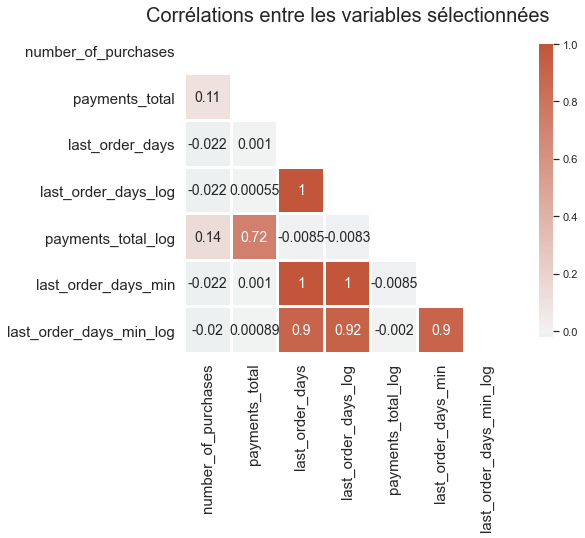

In [415]:
# compute the correlation matrix
corr = data_1[sel_feat_log].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(10,6))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
colormap = sns.heatmap(corr, 
                       annot=True, 
                       annot_kws ={'size':14}, 
                       mask=mask, 
                       cmap=cmap, 
                       vmax=1, 
                       center=0,
                       square=True, 
                       linewidths=2, 
                       cbar_kws={"shrink": .9})

plt.gca().set_yticklabels(sel_feat_log)

plt.gca().set_xticklabels(sel_feat_log)

colormap.set_xticklabels(colormap.get_xmajorticklabels(), size = 15, rotation = 90)
colormap.set_yticklabels(colormap.get_ymajorticklabels(), size = 15)

plt.title('Corrélations entre les variables sélectionnées', size = 20);

### PCA on entire dataset

In [362]:
X = data_1[['number_of_purchases', 'payments_total', 'last_order_days']].values

In [363]:
X.shape

(94721, 3)

In [364]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

# Calcul des composantes principales
from sklearn import decomposition

pca = decomposition.PCA(n_components=3)

# Fit sur le jeu de données standardisées
pca.fit(X_scaled)

PCA(n_components=3)

In [365]:
# Pourcentage de variance expliquée
print(pca.explained_variance_ratio_)

# Pourcentage de variance expliquée cumulées
print(pca.explained_variance_ratio_.cumsum())

[0.36936965 0.33347079 0.29715956]
[0.36936965 0.70284044 1.        ]


In [366]:
# Projection de X sur les composantes principales
X_projected = pca.transform(X_scaled)

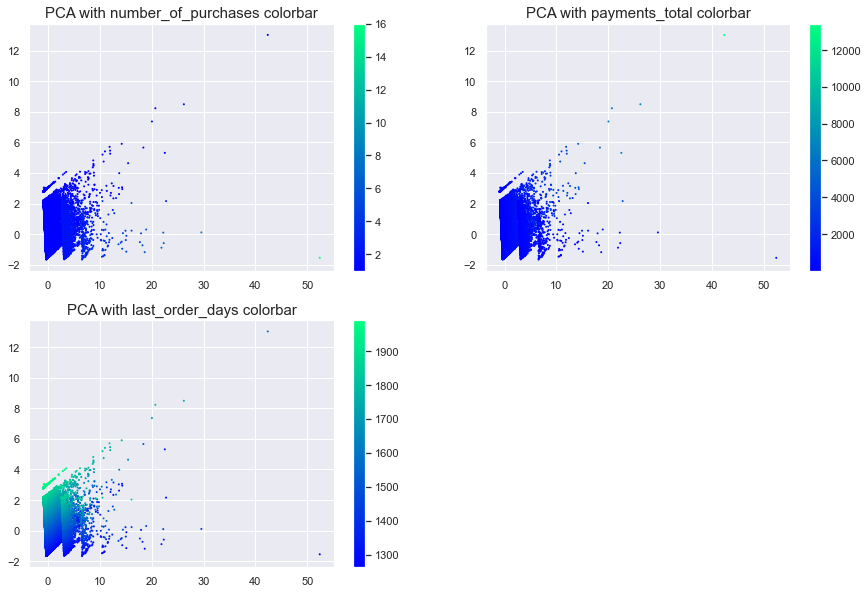

In [376]:
plt.figure(figsize = (15,10))

list_feat_3 = ['number_of_purchases', 'payments_total', 'last_order_days']

for index, feat in enumerate(list_feat_3):
    # Afficher chaque observation
    plt.subplot(2,2,index + 1)
    plt.scatter(X_projected[:, 0],
                X_projected[:, 1],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_1.get(feat),
                cmap = "winter")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.show()

In [377]:
# Contribution de chaque variable aux composantes principales
pcs = pca.components_

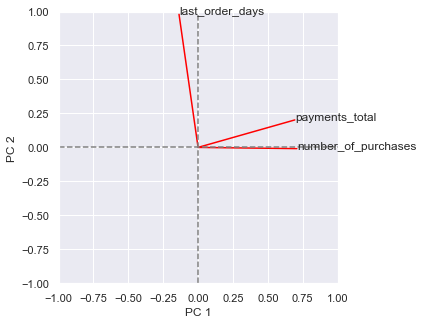

In [378]:
fig = plt.figure(figsize=(5, 5))

for i, (x, y) in enumerate(zip(pcs[0, :], pcs[1, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='red')
    # Afficher le nom(data_1.columns[i]) de la performance
    plt.text(x, y, data_1.columns[i])

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

plt.xlabel('PC 1')
plt.ylabel('PC 2')

plt.show()

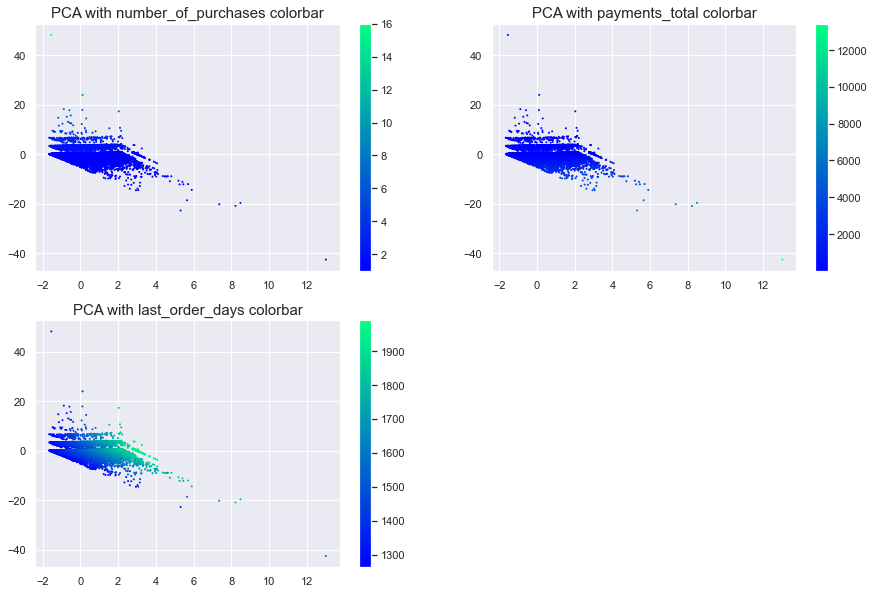

In [379]:
plt.figure(figsize = (15,10))

list_feat_3 = ['number_of_purchases', 'payments_total', 'last_order_days']

for index, feat in enumerate(list_feat_3):
    # Afficher chaque observation
    plt.subplot(2,2,index + 1)
    plt.scatter(X_projected[:, 1],
                X_projected[:, 2],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_1.get(feat),
                cmap = "winter")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.show()

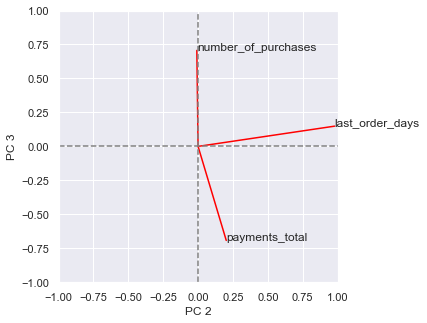

In [380]:
fig = plt.figure(figsize=(5, 5))

for i, (x, y) in enumerate(zip(pcs[1, :], pcs[2, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='red')
    # Afficher le nom(data_1.columns[i]) de la performance
    plt.text(x, y, data_1.columns[i])

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

plt.xlabel('PC 2')
plt.ylabel('PC 3')

plt.show()

### t-SNE (t-Stochastic Neighbour Embedding) on entire dataset

In [381]:
from sklearn.manifold import TSNE

In [382]:
# We want to get TSNE embedding with 2 dimensions
n_components = 2
tsne = TSNE(n_components)
tsne_result = tsne.fit_transform(X_scaled)
tsne_result.shape

(94721, 2)

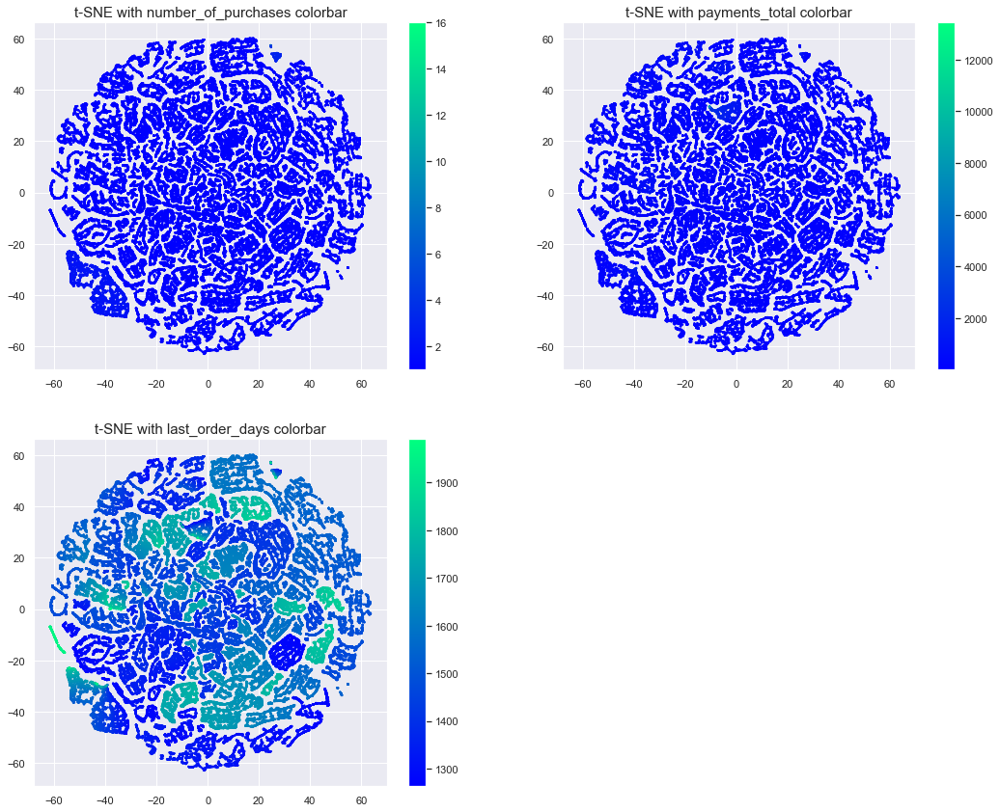

In [385]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results = pd.DataFrame(tsne_result, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_3):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], 
                tsne_results['tsne2'], 
                c = data_1.get(feat), 
                s = 2, 
                cmap = 'winter')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 30', size = 13)
    plt.colorbar()

plt.show()

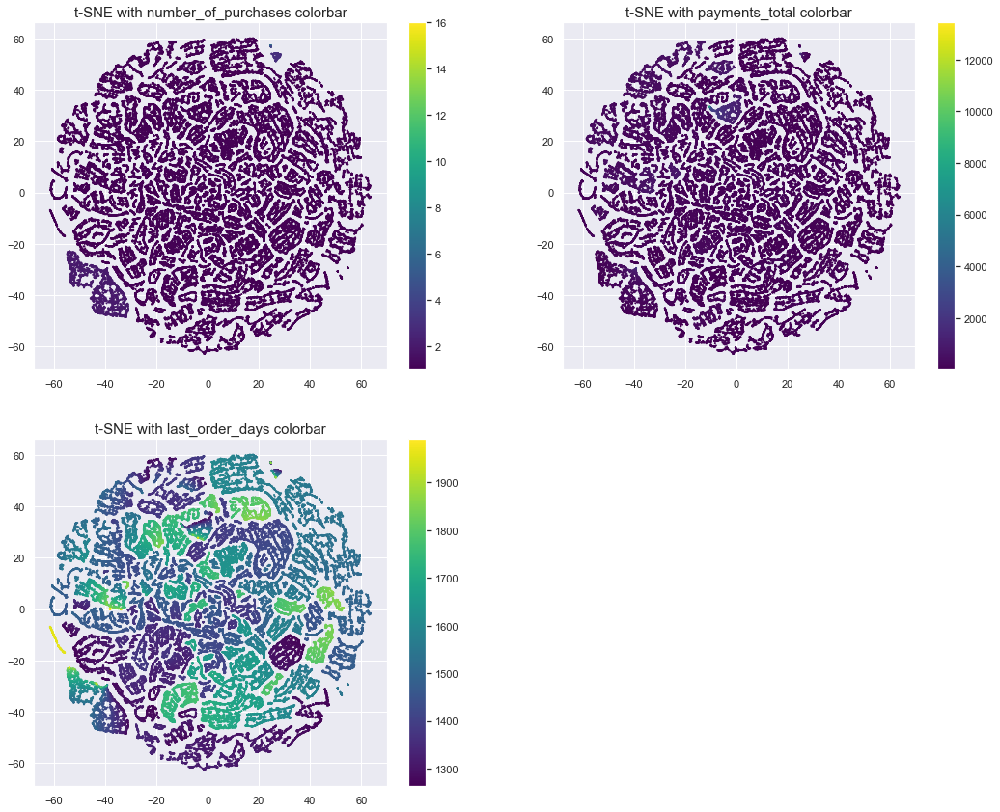

In [387]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results = pd.DataFrame(tsne_result, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_3):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], 
                tsne_results['tsne2'], 
                c = data_1.get(feat), 
                s = 1, 
                cmap = 'viridis')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 30', size = 13)
    plt.colorbar()

plt.show()

In [388]:
# Other test : perplexity = 75 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 75,
            n_iter = 1000,
            random_state = 0)
tsne_result_p75 = tsne.fit_transform(X_scaled)
tsne_result_p75.shape

(94721, 2)

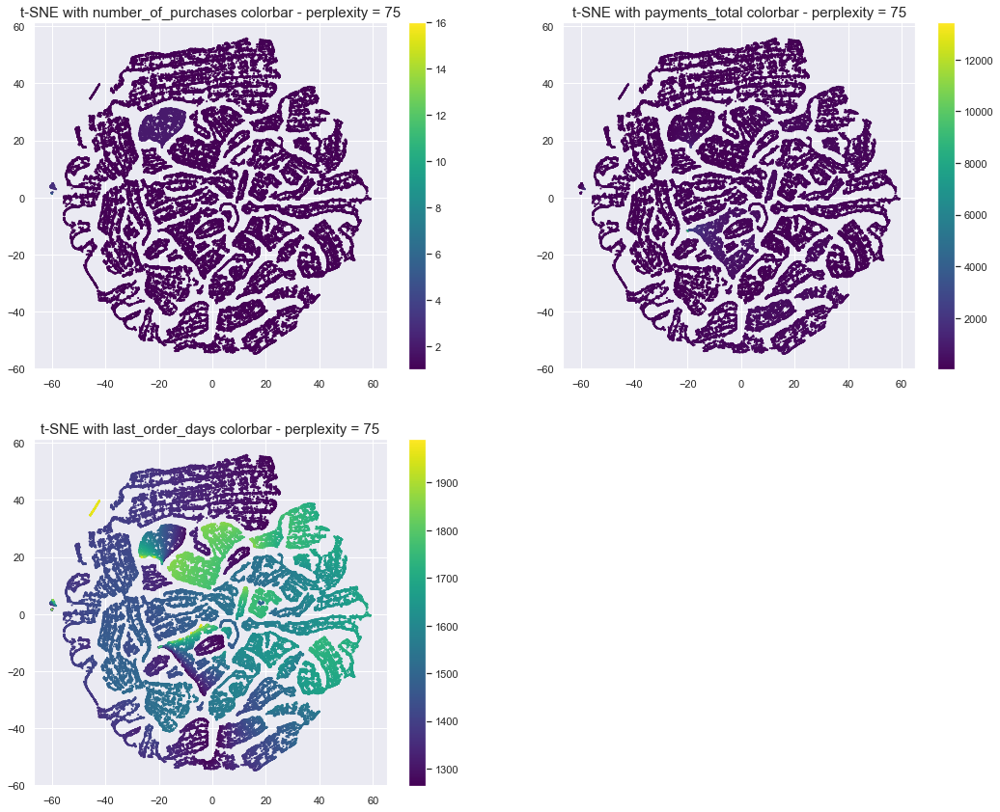

In [390]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results_p75 = pd.DataFrame(tsne_result_p75, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_3):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p75['tsne1'], 
                tsne_results_p75['tsne2'], 
                c = data_1.get(feat), 
                s = 1, 
                cmap = 'viridis')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 75', size = 15)
    plt.colorbar()

plt.show()

In [391]:
# Other test : perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100 = tsne.fit_transform(X_scaled)
tsne_result_p100.shape

(94721, 2)

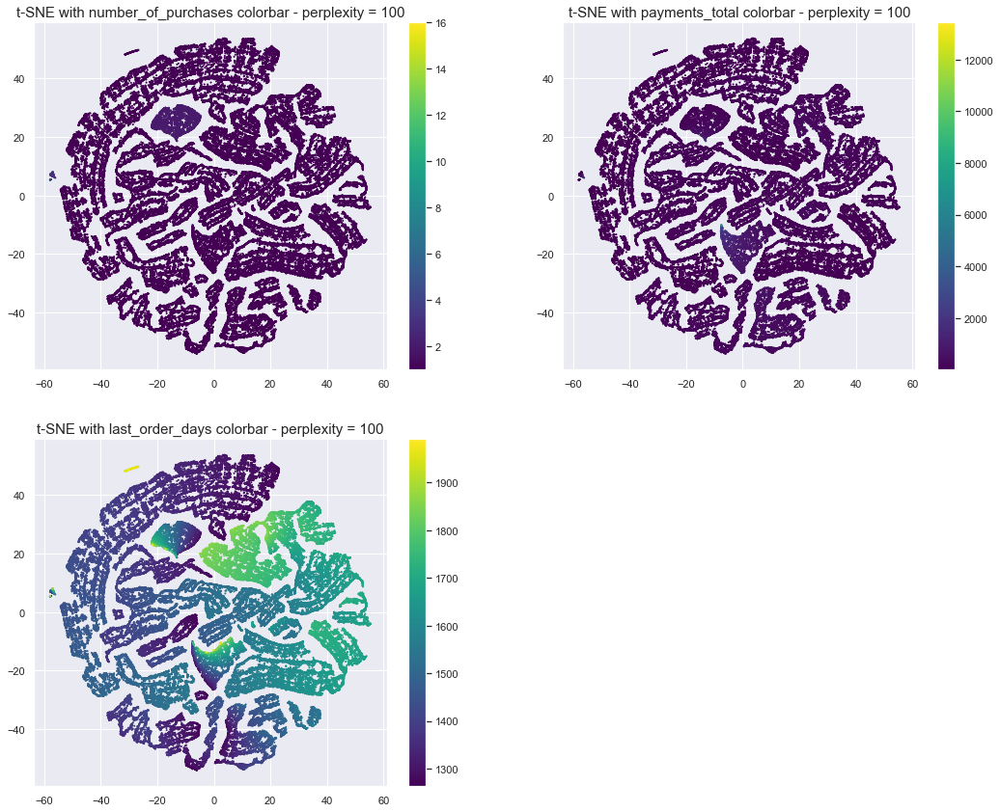

In [393]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_3):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_1.get(feat), 
                s = 1, 
                cmap = 'viridis')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100', size = 15)
    plt.colorbar()

plt.show()

In [416]:
# Other test : perplexity = 100, init = 'pca' (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'pca',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_pca = tsne.fit_transform(X_scaled)
tsne_result_p100_pca.shape

(94721, 2)

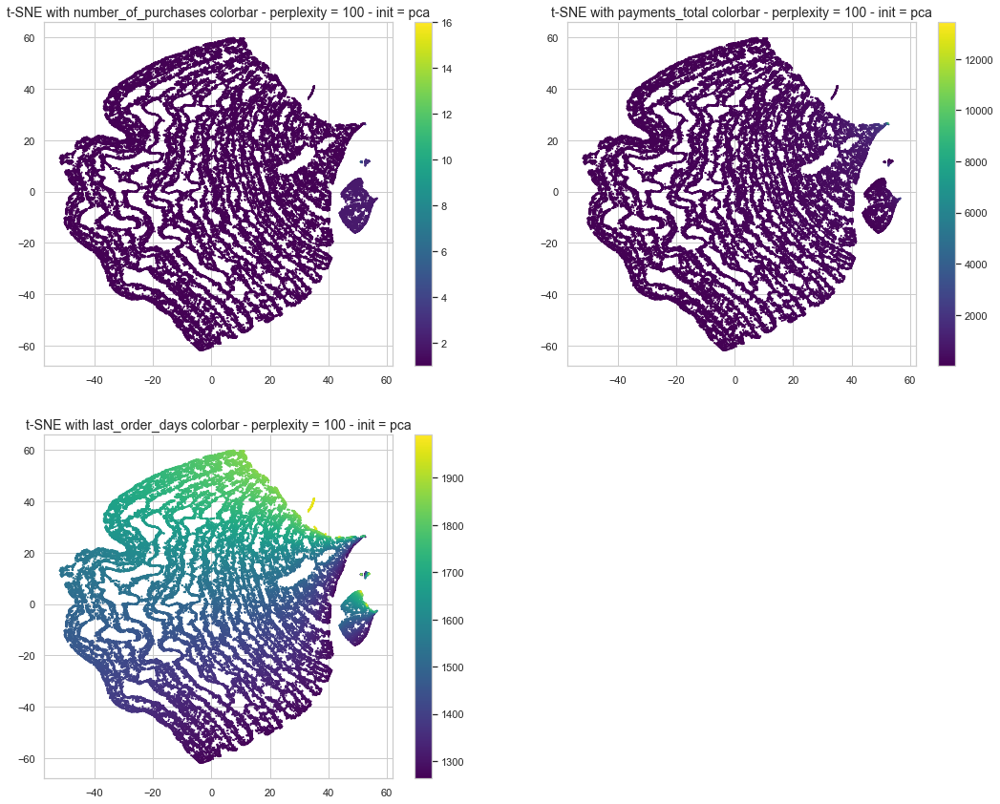

In [417]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_pca = pd.DataFrame(tsne_result_p100_pca, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_3):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_pca['tsne1'], 
                tsne_results_p100_pca['tsne2'], 
                c = data_1.get(feat), 
                s = 1, 
                cmap = 'viridis')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100 - init = pca', size = 14)
    plt.colorbar()

plt.show()

### PCA on reduced dataset (several purchases)

In [422]:
data_2 = data_1.loc[data_1['number_of_purchases'] > 1]

In [423]:
data_2

,number_of_purchases,payments_total,last_order_days,last_order_days_log,payments_total_log,last_order_days_min,last_order_days_min_log
Customer,,,,,,,
ff22e30958c13ffe219db7d711e8f564,2,290.00,1263,3.101403,2.462398,1,0.000000
1041688b50cfd8ef6df6086a1746a30c,2,41.80,1268,3.103119,1.621176,6,0.778151
fb7e29c65321441231990afc201c1b14,2,268.69,1268,3.103119,2.429252,6,0.778151
34b0cd95480e55c2a701293a2b9671b3,3,263.63,1268,3.103119,2.420995,6,0.778151
41d57ab847e5ccbe403f46b07ee577d6,2,131.90,1269,3.103462,2.120245,7,0.845098
...,...,...,...,...,...,...,...
728e4a7d0db4845270091ded0923c71f,3,20.70,1868,3.271377,1.315970,606,2.782473
f7b981e8a280e455ac3cbe0d5d171bd1,2,21.80,1868,3.271377,1.338456,606,2.782473
0ecf7f65b5ff3b9e61b637e59f495e0a,2,126.69,1955,3.291147,2.102742,693,2.840733


In [424]:
X2 = data_2[['number_of_purchases', 'payments_total', 'last_order_days']].values
X2.shape

(2869, 3)

In [425]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X2)
X2_scaled = std_scale.transform(X2)

# Calcul des composantes principales
from sklearn import decomposition

pca = decomposition.PCA(n_components=3)

# Fit sur le jeu de données standardisées
pca.fit(X2_scaled)

PCA(n_components=3)

In [426]:
# Pourcentage de variance expliquée
print(pca.explained_variance_ratio_)

# Pourcentage de variance expliquée cumulées
print(pca.explained_variance_ratio_.cumsum())

[0.39637196 0.32834181 0.27528623]
[0.39637196 0.72471377 1.        ]


In [427]:
# Projection de X2 sur les composantes principales
X2_projected = pca.transform(X2_scaled)

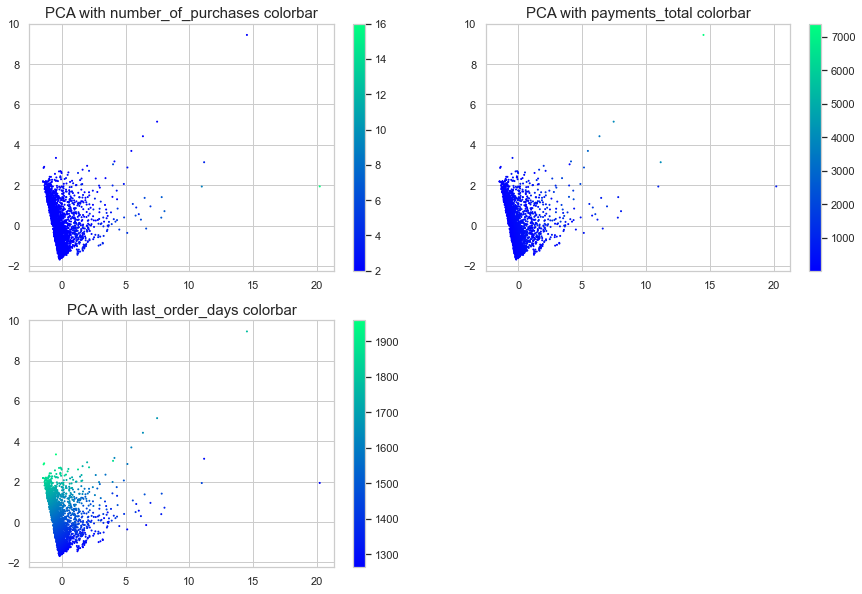

In [428]:
plt.figure(figsize = (15,10))

list_feat_3 = ['number_of_purchases', 'payments_total', 'last_order_days']

for index, feat in enumerate(list_feat_3):
    # Afficher chaque observation
    plt.subplot(2,2,index + 1)
    plt.scatter(X2_projected[:, 0],
                X2_projected[:, 1],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_2.get(feat),
                cmap = "winter")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.show()

In [429]:
# Contribution de chaque variable aux composantes principales
pcs = pca.components_

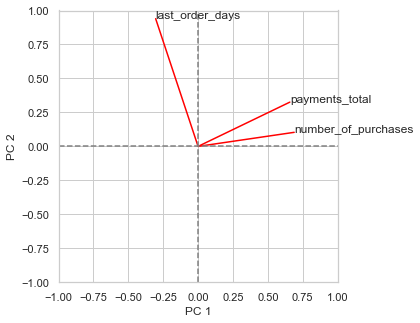

In [430]:
fig = plt.figure(figsize=(5, 5))

for i, (x, y) in enumerate(zip(pcs[0, :], pcs[1, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='red')
    # Afficher le nom(data_1.columns[i]) de la performance
    plt.text(x, y, data_2.columns[i])

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

plt.xlabel('PC 1')
plt.ylabel('PC 2')

plt.show()

### t-SNE (t-Stochastic Neighbour Embedding) on reduced dataset (number of purchases > 1)

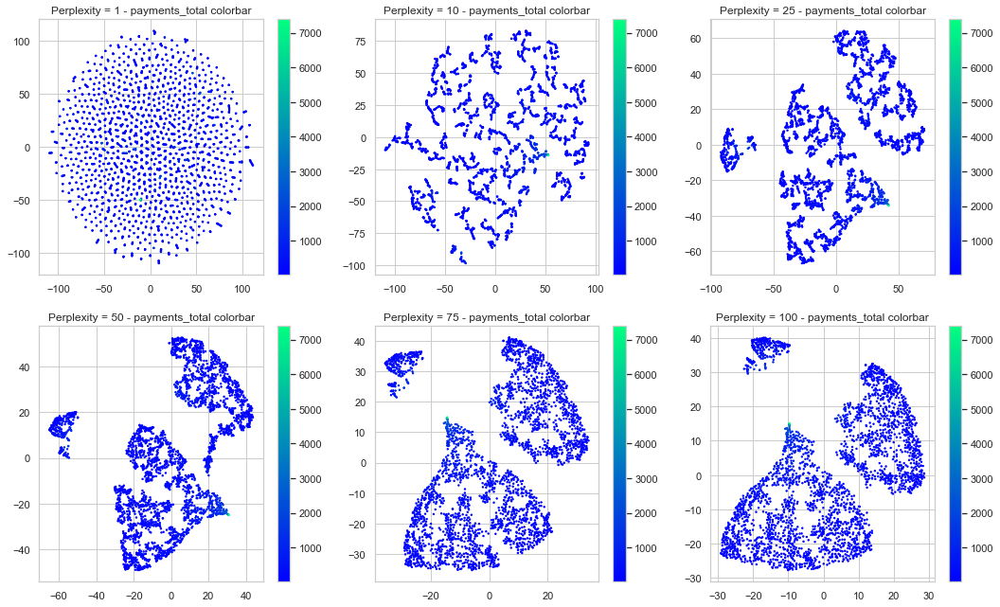

In [434]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 50, 75, 100]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=0)
    tsne_results = tsne.fit_transform(X2_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,3,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=data_2.get('payments_total'), s=2, cmap = 'winter')
    plt.title('Perplexity = '+ str(p) + ' - ' + 'payments_total colorbar', size = 12)
    plt.colorbar()
    
plt.show()

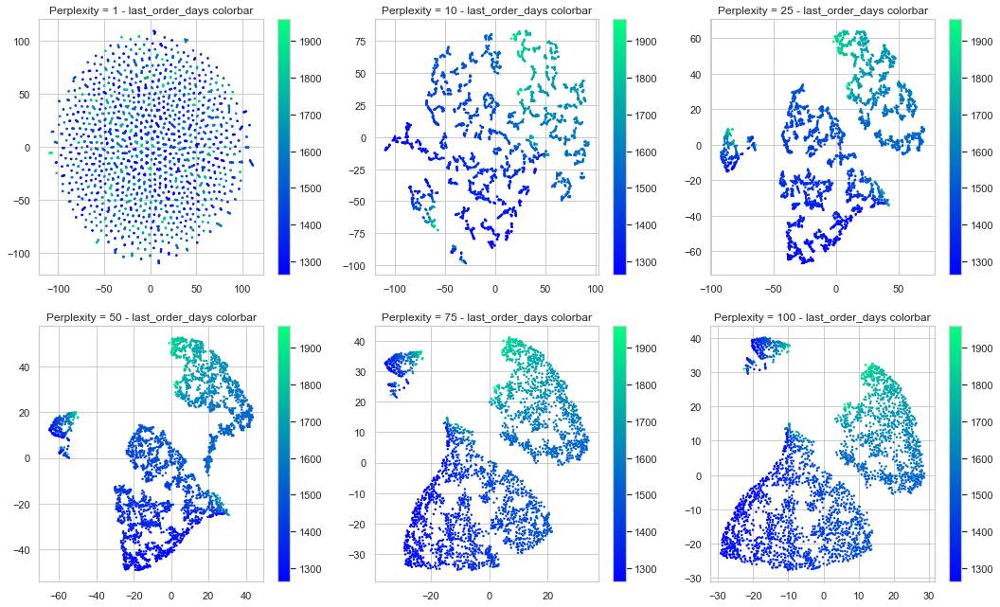

In [435]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 50, 75, 100]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=0)
    tsne_results = tsne.fit_transform(X2_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,3,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=data_2.get('last_order_days'), s=2, cmap = 'winter')
    plt.title('Perplexity = '+ str(p) + ' - ' + 'last_order_days colorbar', size = 12)
    plt.colorbar()
    
plt.show()

In [436]:
data.columns

Index(['Customer', 'deliveries', 'last_order_days', 'payments_total',
       'review_score_mean', 'number_of_review_comments', 'number_of_purchases',
       'Number_of_products', 'percentage_deliveries',
       'percentage_of_review_comments', 'mean_payment_by_purchase'],
      dtype='object')

## 3) b) With 5 features - orders, satisfaction and comment features :
- last_order_days
- number_of_purchases
- payments_total
- review_score_mean
- percentage_of_review_comments

In [437]:
data_5 = data[['Customer', 
               'number_of_purchases', 
               'payments_total', 
               'last_order_days',
               'review_score_mean',
               'percentage_of_review_comments']]

data_5 = data_5.set_index('Customer')

In [438]:
data_5.dtypes

number_of_purchases                int64
payments_total                   float64
last_order_days                    int32
review_score_mean                float64
percentage_of_review_comments    float64
dtype: object

### PCA on entire dataset

In [442]:
X5 = data_5.values
X5.shape

(94721, 5)

In [443]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X5)
X5_scaled = std_scale.transform(X5)

# Calcul des composantes principales
from sklearn import decomposition

pca = decomposition.PCA(n_components=5)

# Fit sur le jeu de données standardisées
pca.fit(X5_scaled)

PCA(n_components=5)

In [444]:
# Pourcentage de variance expliquée
print(pca.explained_variance_ratio_)

# Pourcentage de variance expliquée cumulées
print(pca.explained_variance_ratio_.cumsum())

[0.26656704 0.21190611 0.19749674 0.18274771 0.1412824 ]
[0.26656704 0.47847315 0.67596989 0.8587176  1.        ]


In [446]:
# Projection de X sur les composantes principales
X5_projected = pca.transform(X5_scaled)

In [448]:
# Contribution de chaque variable aux composantes principales
pcs = pca.components_

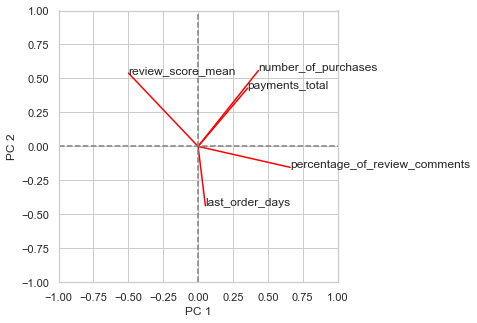

In [449]:
fig = plt.figure(figsize=(5, 5))

for i, (x, y) in enumerate(zip(pcs[0, :], pcs[1, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='red')
    # Afficher le nom(data_5.columns[i]) de la performance
    plt.text(x, y, data_5.columns[i])

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

plt.xlabel('PC 1')
plt.ylabel('PC 2')

plt.show()

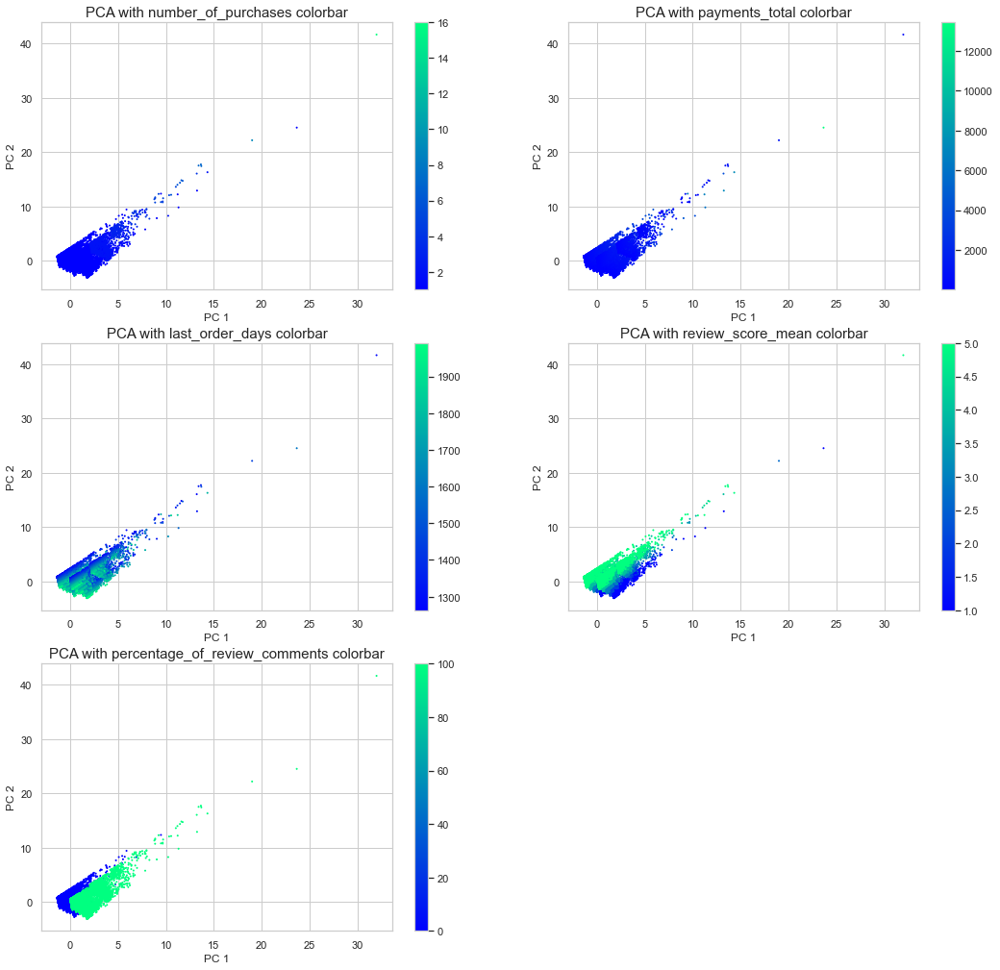

In [453]:
plt.figure(figsize = (18,15))
plt.subplots_adjust(top = 1)

list_feat_5 = ['number_of_purchases', 'payments_total', 'last_order_days',
               'review_score_mean', 'percentage_of_review_comments']

for index, feat in enumerate(list_feat_5):
    # Afficher chaque observation
    plt.subplot(3,2,index + 1)
    plt.scatter(X5_projected[:, 0],
                X5_projected[:, 1],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_5.get(feat),
                cmap = "winter")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.xlabel('PC 1')
    plt.ylabel('PC 2')
    plt.colorbar()

plt.show()

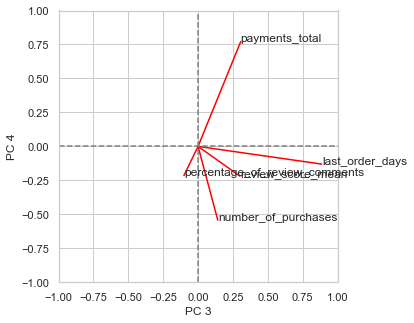

In [450]:
fig = plt.figure(figsize=(5, 5))

for i, (x, y) in enumerate(zip(pcs[2, :], pcs[3, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='red')
    # Afficher le nom(data_5.columns[i]) de la performance
    plt.text(x, y, data_5.columns[i])

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

plt.xlabel('PC 3')
plt.ylabel('PC 4')

plt.show()

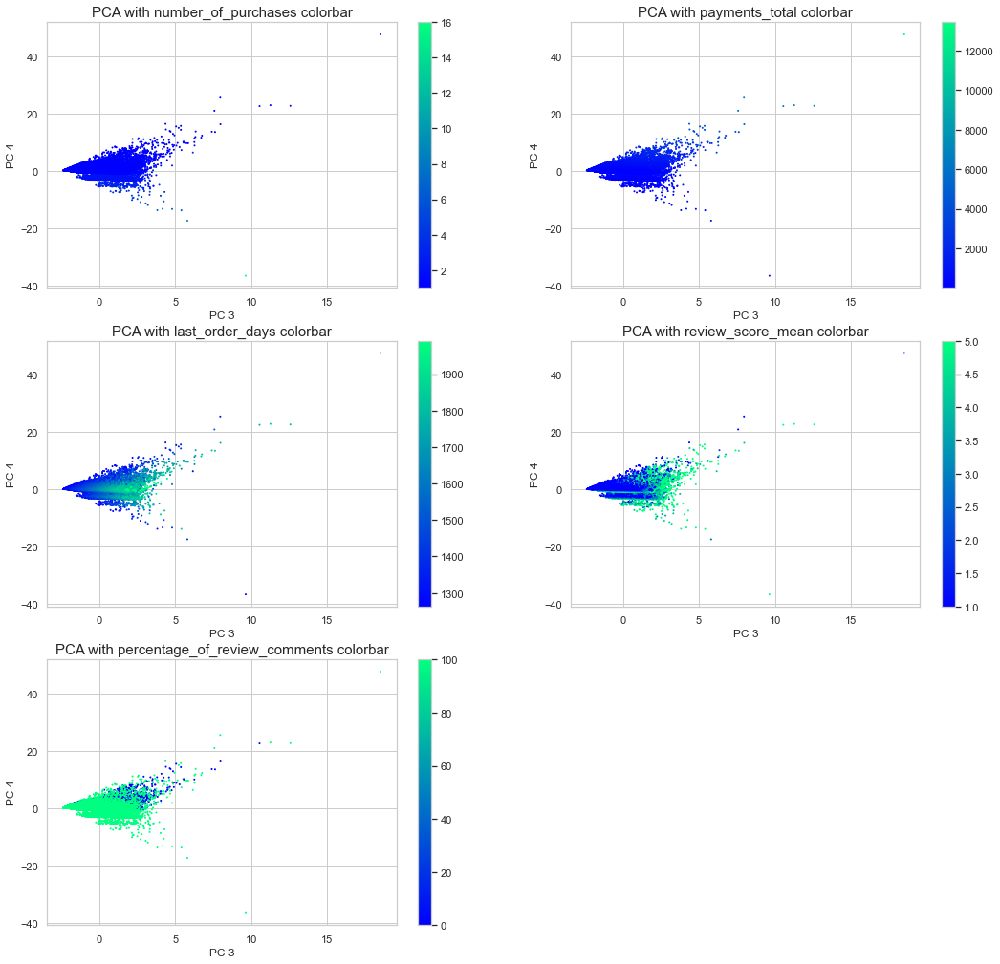

In [454]:
plt.figure(figsize = (18,15))
plt.subplots_adjust(top = 1)

list_feat_5 = ['number_of_purchases', 'payments_total', 'last_order_days',
               'review_score_mean', 'percentage_of_review_comments']

for index, feat in enumerate(list_feat_5):
    # Afficher chaque observation
    plt.subplot(3,2,index + 1)
    plt.scatter(X5_projected[:, 2],
                X5_projected[:, 3],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_5.get(feat),
                cmap = "winter")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.xlabel('PC 3')
    plt.ylabel('PC 4')
    plt.colorbar()

plt.show()

### t-SNE (t-Stochastic Neighbour Embedding) on entire dataset

In [455]:
# Perplexity = 75 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 75,
            n_iter = 1000,
            random_state = 0)
tsne_result_p75 = tsne.fit_transform(X5_scaled)
tsne_result_p75.shape

(94721, 2)

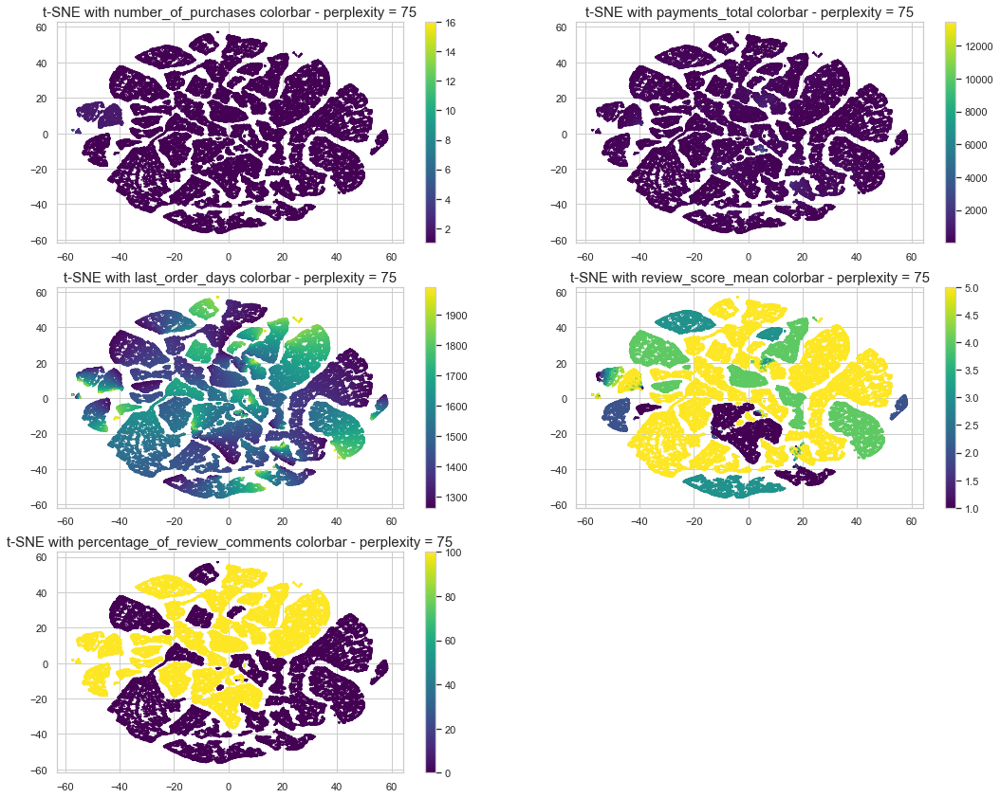

In [457]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results_p75 = pd.DataFrame(tsne_result_p75, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_5):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p75['tsne1'], 
                tsne_results_p75['tsne2'], 
                c = data_5.get(feat), 
                s = 1, 
                cmap = 'viridis')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 75', size = 15)
    plt.colorbar()

plt.show()

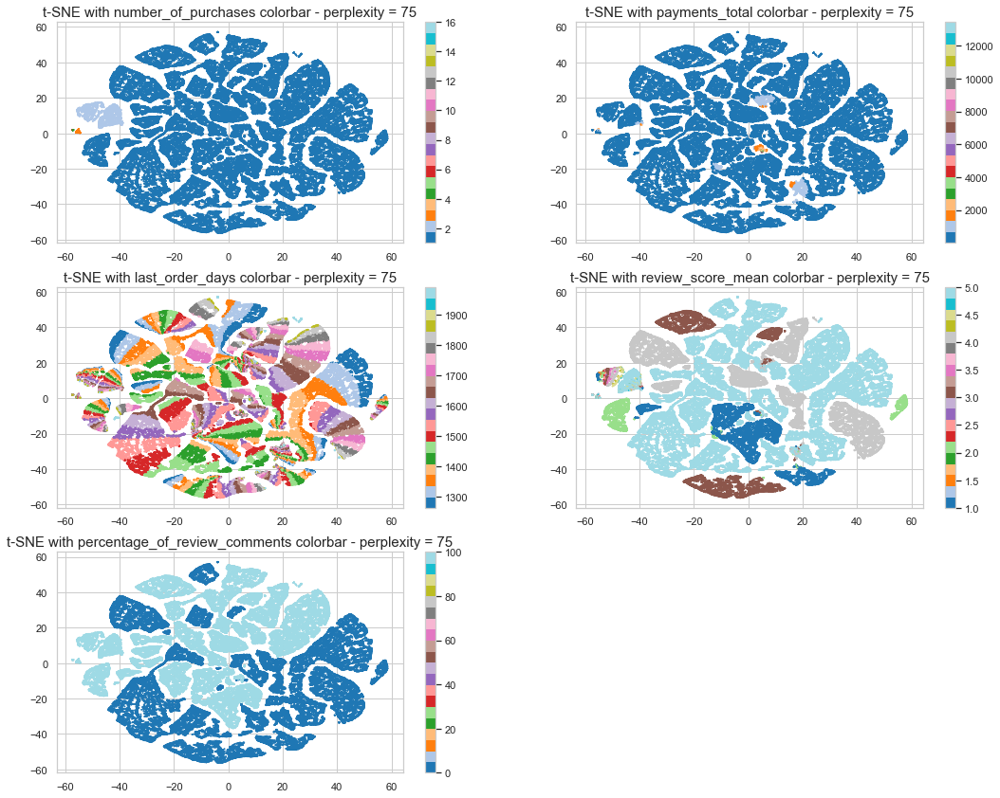

In [461]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results_p75 = pd.DataFrame(tsne_result_p75, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_5):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p75['tsne1'], 
                tsne_results_p75['tsne2'], 
                c = data_5.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 75', size = 15)
    plt.colorbar()

plt.show()

In [458]:
# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100 = tsne.fit_transform(X5_scaled)
tsne_result_p100.shape

(94721, 2)

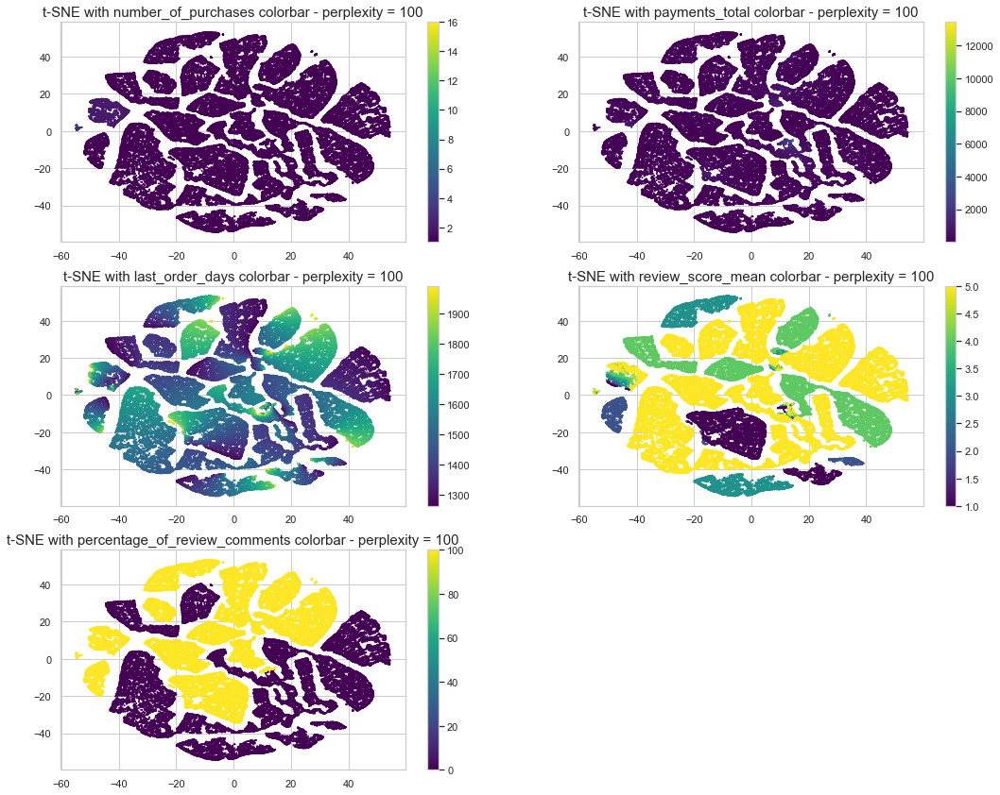

In [459]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_5):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_5.get(feat), 
                s = 1, 
                cmap = 'viridis')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100', size = 15)
    plt.colorbar()

plt.show()

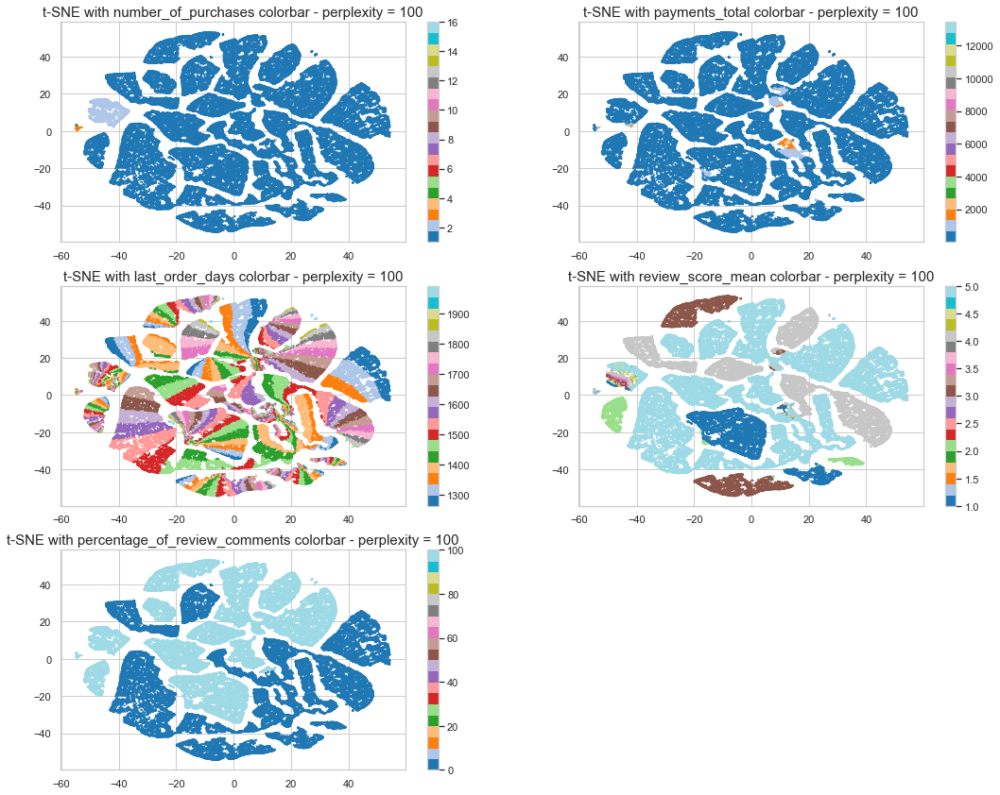

In [460]:
plt.figure(figsize = (18,8))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_5):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_5.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100', size = 15)
    plt.colorbar()

plt.show()

## 3) c) With 4 features - orders and satisfaction features :
- last_order_days
- number_of_purchases
- payments_total
- review_score_mean

In [180]:
data_4 = data[['Customer', 
               'number_of_purchases', 
               'payments_total', 
               'last_order_days',
               'review_score_mean']]

data_4 = data_4.set_index('Customer')

In [181]:
X4 = data_4.values
X4.shape

(94721, 4)

### PCA on entire dataset

In [182]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4)
X4_scaled = std_scale.transform(X4)

# Calcul des composantes principales
from sklearn import decomposition

pca = decomposition.PCA(n_components=4)

# Fit sur le jeu de données standardisées
pca.fit(X4_scaled)

PCA(n_components=4)

In [183]:
# Pourcentage de variance expliquée
print(pca.explained_variance_ratio_)

# Pourcentage de variance expliquée cumulées
print(pca.explained_variance_ratio_.cumsum())

[0.27789049 0.2569094  0.24430218 0.22089793]
[0.27789049 0.53479989 0.77910207 1.        ]


In [184]:
# Projection de X sur les composantes principales
X4_projected = pca.transform(X4_scaled)

In [185]:
# Contribution de chaque variable aux composantes principales
pcs = pca.components_

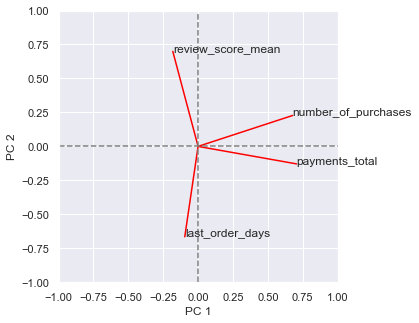

In [186]:
fig = plt.figure(figsize=(5, 5))

for i, (x, y) in enumerate(zip(pcs[0, :], pcs[1, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='red')
    # Afficher le nom(data_5.columns[i]) de la performance
    plt.text(x, y, data_4.columns[i])

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

plt.xlabel('PC 1')
plt.ylabel('PC 2')

plt.show()

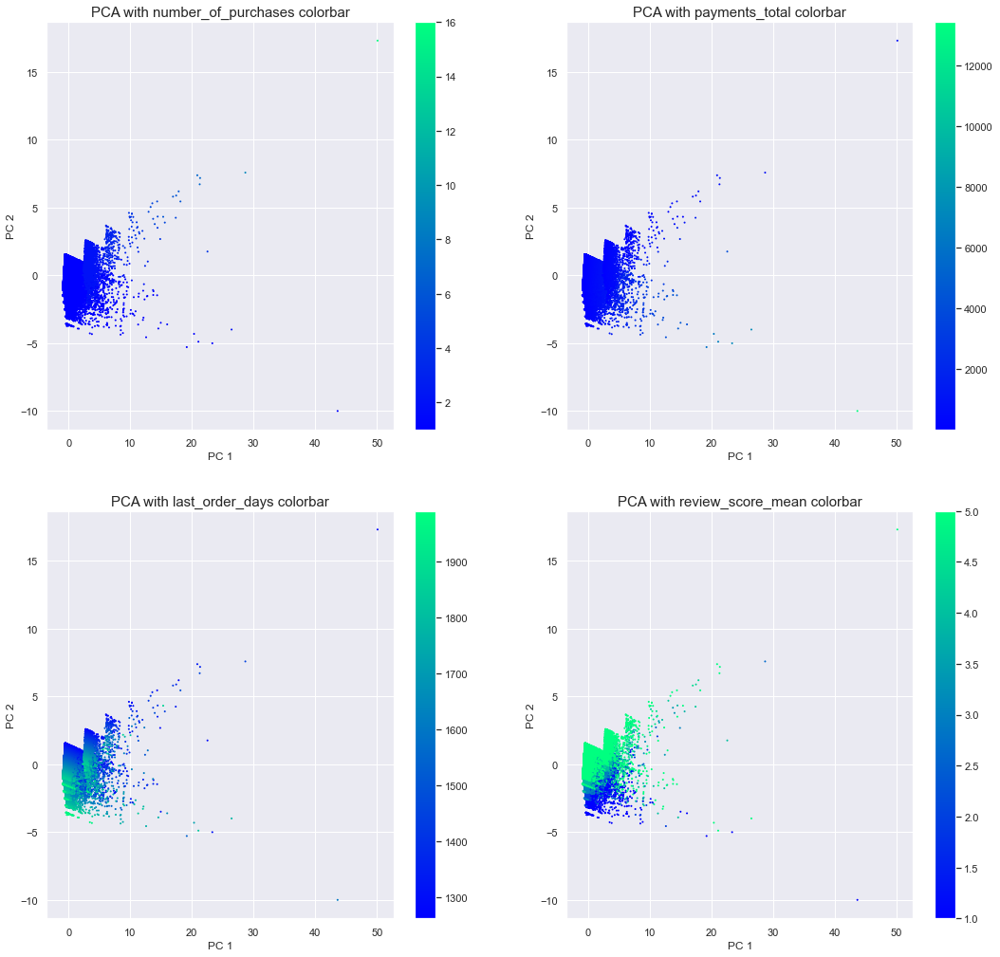

In [187]:
plt.figure(figsize = (18,15))
plt.subplots_adjust(top = 1)

list_feat_4 = ['number_of_purchases', 'payments_total', 
               'last_order_days', 'review_score_mean']

for index, feat in enumerate(list_feat_4):
    # Afficher chaque observation
    plt.subplot(2,2,index + 1)
    plt.scatter(X4_projected[:, 0],
                X4_projected[:, 1],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_4.get(feat),
                cmap = "winter")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.xlabel('PC 1')
    plt.ylabel('PC 2')
    plt.colorbar()

plt.show()

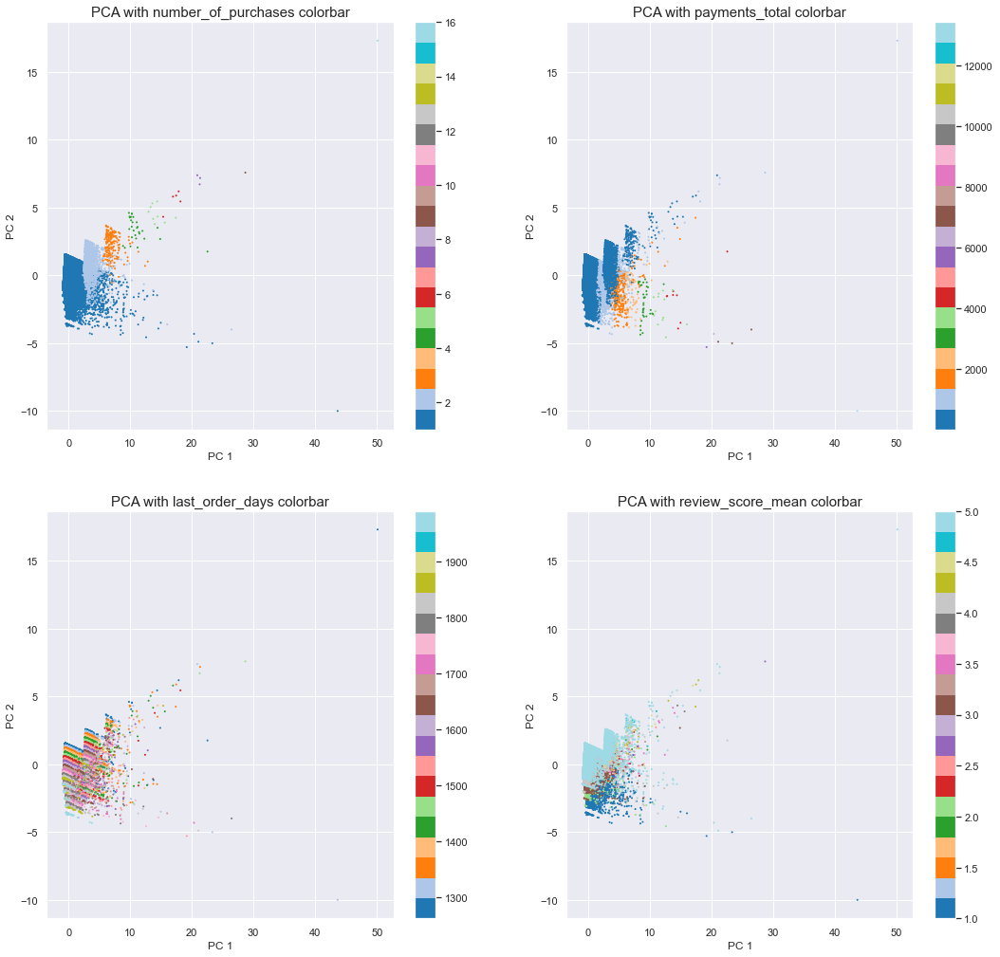

In [188]:
plt.figure(figsize = (18,15))
plt.subplots_adjust(top = 1)

list_feat_4 = ['number_of_purchases', 'payments_total', 
               'last_order_days', 'review_score_mean']

for index, feat in enumerate(list_feat_4):
    # Afficher chaque observation
    plt.subplot(2,2,index + 1)
    plt.scatter(X4_projected[:, 0],
                X4_projected[:, 1],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_4.get(feat),
                cmap = "tab20")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.xlabel('PC 1')
    plt.ylabel('PC 2')
    plt.colorbar()

plt.show()

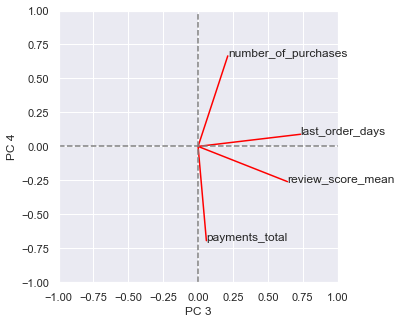

In [189]:
fig = plt.figure(figsize=(5, 5))

for i, (x, y) in enumerate(zip(pcs[2, :], pcs[3, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='red')
    # Afficher le nom(data_5.columns[i]) de la performance
    plt.text(x, y, data_4.columns[i])

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

plt.xlabel('PC 3')
plt.ylabel('PC 4')

plt.show()

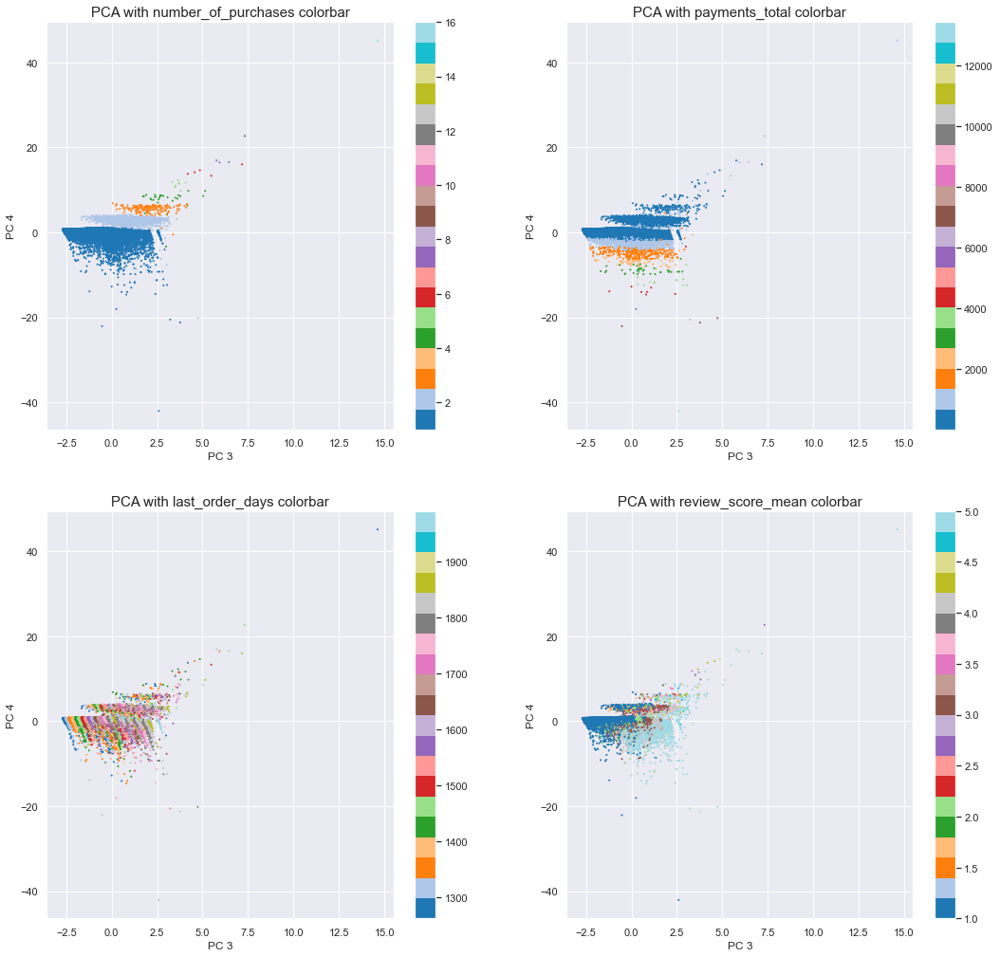

In [190]:
plt.figure(figsize = (18,15))
plt.subplots_adjust(top = 1)

list_feat_4 = ['number_of_purchases', 'payments_total', 
               'last_order_days', 'review_score_mean']

for index, feat in enumerate(list_feat_4):
    # Afficher chaque observation
    plt.subplot(2,2,index + 1)
    plt.scatter(X4_projected[:, 2],
                X4_projected[:, 3],
                s = 1,
                # Colorer en utilisant la variable 'feat'
                c = data_4.get(feat),
                cmap = "tab20")
    plt.title('PCA with '+ feat + ' colorbar', size = 15)
    plt.xlabel('PC 3')
    plt.ylabel('PC 4')
    plt.colorbar()

plt.show()

### t-SNE (t-Stochastic Neighbour Embedding) on entire dataset

In [192]:
from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100 = tsne.fit_transform(X4_scaled)
tsne_result_p100.shape

(94721, 2)

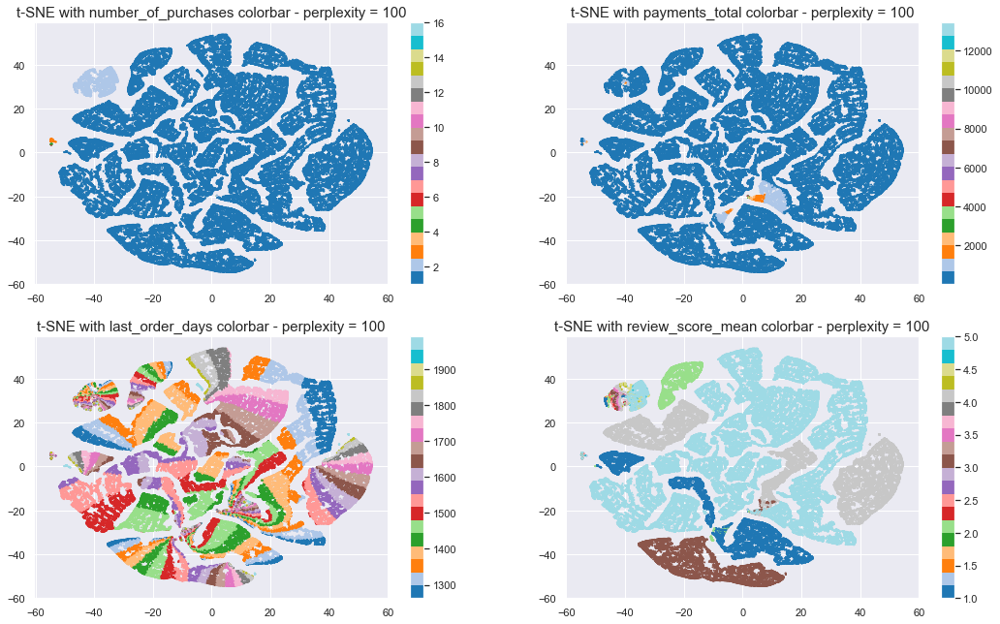

In [193]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100', size = 15)
    plt.colorbar()

plt.show()

# 4) Clustering

## 4) a) clustering With 4 features dataframe - orders and satisfaction features :

### KMeans clustering

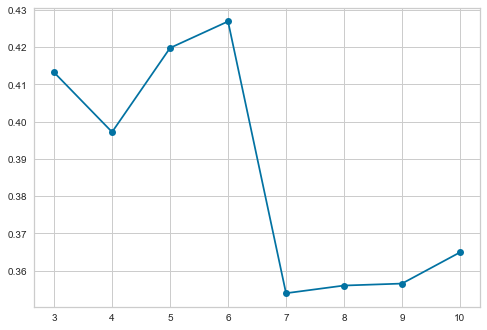

In [513]:
# Calculate silhouette scores for different number of clusters with Kmeans clustering
# on entire dataset
from sklearn.cluster import KMeans
from sklearn import metrics

silhouettes = []

for num_clusters in range(3, 11):
    cls = KMeans(n_clusters = num_clusters,
                 n_init = 10, 
                 init = 'k-means++')
    cls.fit(X4_scaled)
    silh = metrics.silhouette_score(X4_scaled, cls.labels_)
    silhouettes.append(silh)

plt.plot(range(3,11), silhouettes, marker = 'o');

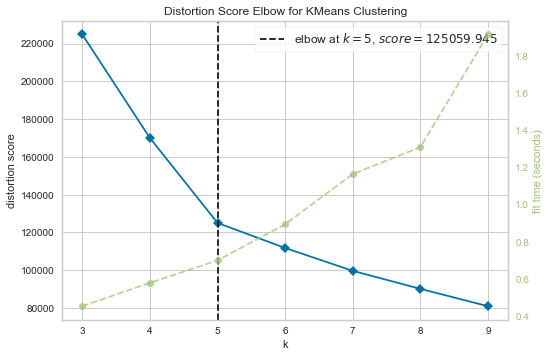

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [515]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = KMeans(n_clusters = num_clusters,
               n_init = 10,
               init = 'k-means++')
visualizer = KElbowVisualizer(model, k=(3,10))

visualizer.fit(X4_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

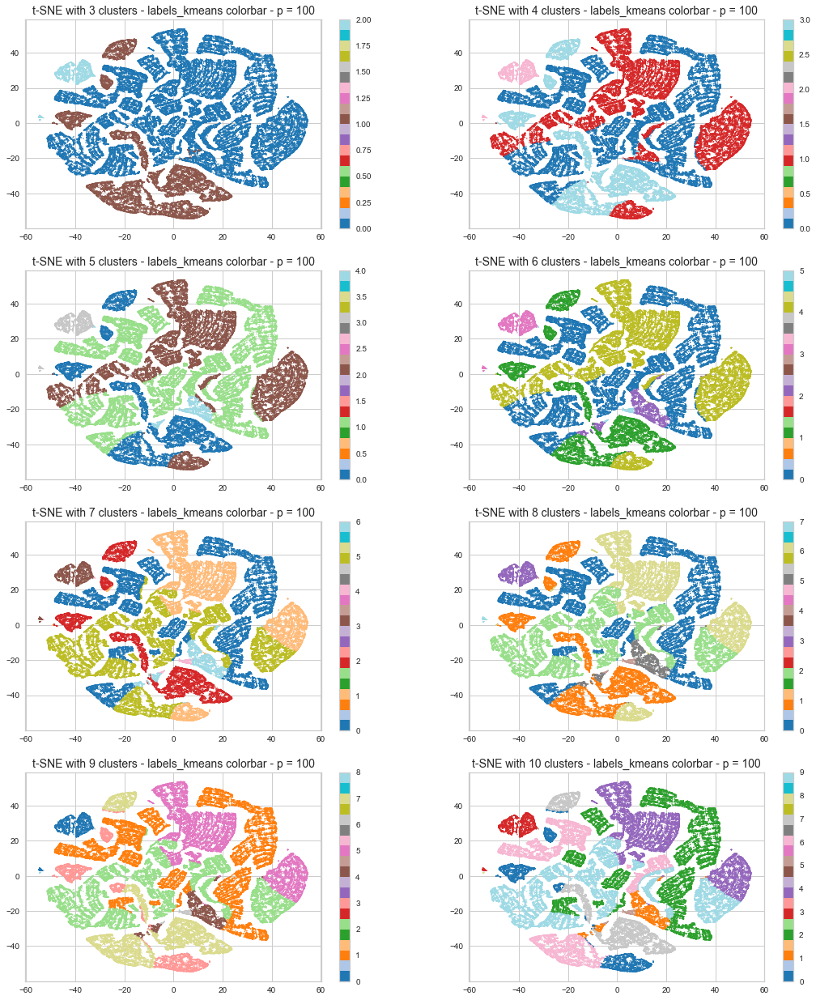

In [517]:
plt.figure(figsize = (18, 12))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, num_clusters in enumerate(range(3, 11)):
    km = KMeans(n_clusters = num_clusters,
                 max_iter = 300,
                 n_init = 10, 
                 init = 'k-means++')
    km.fit(X4_scaled)
    labels_k_means = km.labels_
    data_4['labels_kmeans'] = labels_k_means
    plt.subplot(4,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ str(num_clusters) + ' clusters - labels_kmeans colorbar - p = 100', size = 14)
    plt.colorbar()

plt.show()

In [523]:
# Run local implementation of kmeans with 4 clusters
km = KMeans(n_clusters = 4, 
            max_iter = 100,
            n_init = 10,
            init = 'k-means++')
km.fit(X4_scaled)

labels_kmeans_4_clusters = km.labels_
data_4['labels_kmeans'] = labels_kmeans_4_clusters

In [526]:
list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_kmeans']

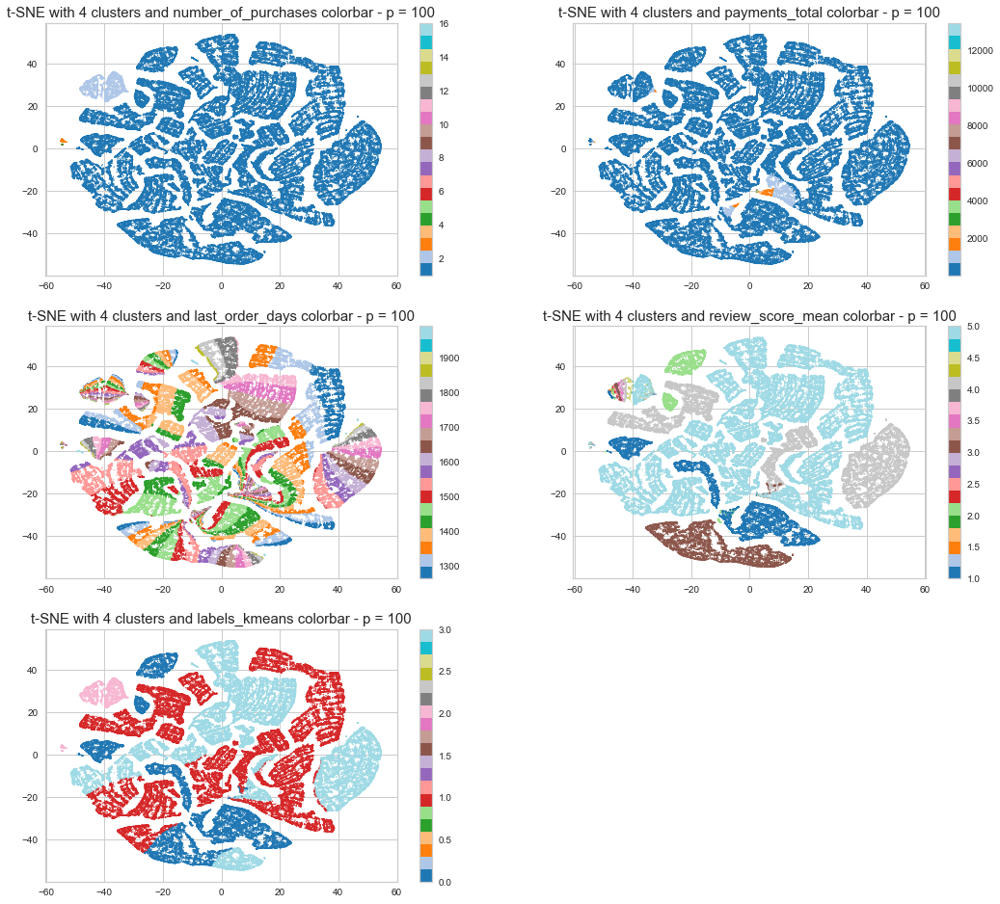

In [527]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 4 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

In [528]:
# Run local implementation of kmeans with 5 clusters
km = KMeans(n_clusters = 5, 
            max_iter = 100,
            n_init = 10,
            init = 'k-means++')
km.fit(X4_scaled)

labels_kmeans_5_clusters = km.labels_
data_4['labels_kmeans'] = labels_kmeans_5_clusters

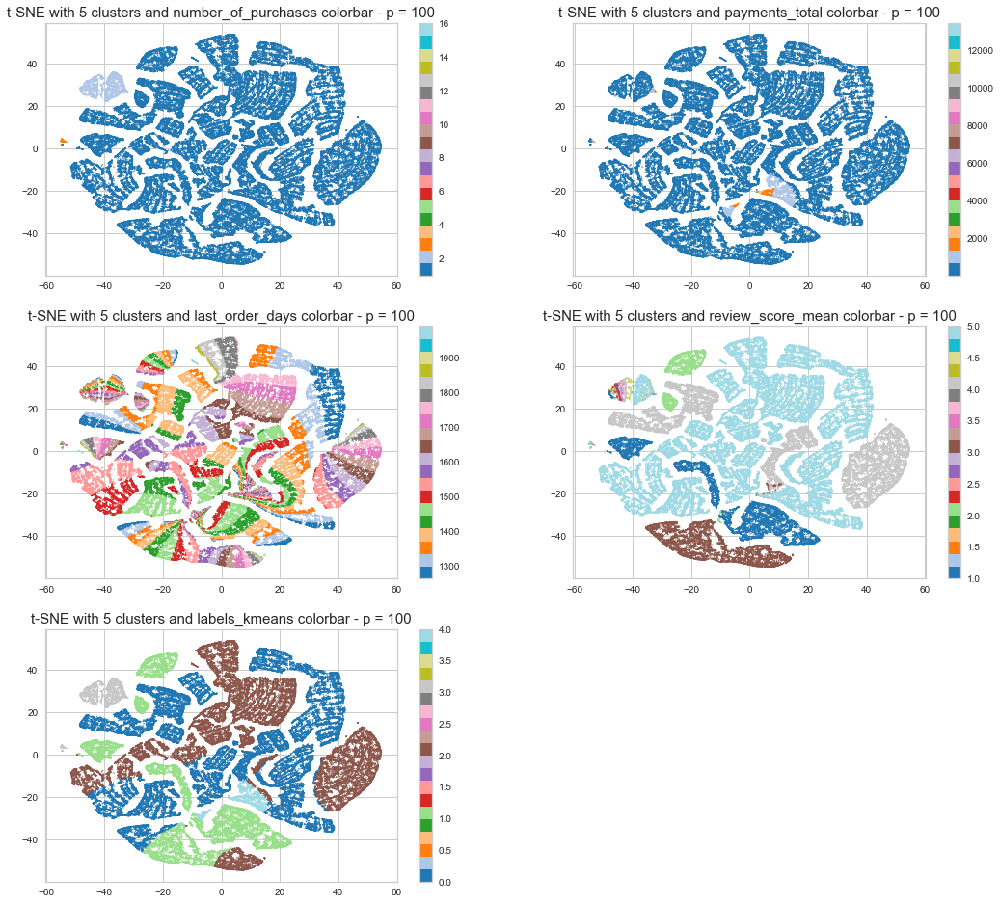

In [529]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 5 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

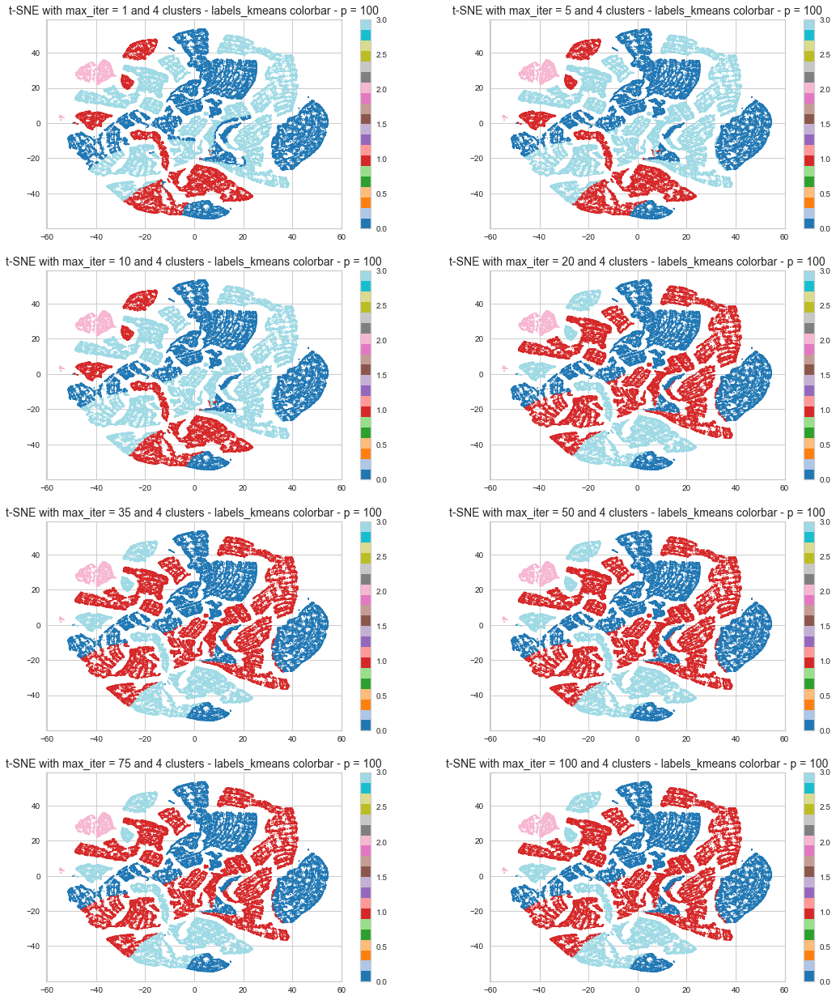

In [532]:
plt.figure(figsize = (18, 12))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, max_iterations in enumerate([1, 5, 10, 20, 35, 50, 75, 100]):
    km = KMeans(n_clusters = 4,
                 max_iter = max_iterations,
                 n_init = 10, 
                 init = 'k-means++',
                random_state = 0)
    km.fit(X4_scaled)
    labels_k_means = km.labels_
    data_4['labels_kmeans'] = labels_k_means
    plt.subplot(4,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with max_iter = '+ str(max_iterations) + ' and 4 clusters - labels_kmeans colorbar - p = 100', size = 14)
    plt.colorbar()

plt.show()

-> Le clustering n'évolue plus après 10 itérations

### Conclusion du clustering KMeans
- best choice would be 4 or 5 clusters
- low number of iteration (10) is sufficient
- to be compared with other clustering models

### Hierarchical clustering

In [534]:
# Dendrogram on reduced dataset (number of purchases > 1)

from scipy.cluster.hierarchy import dendrogram, linkage

# Linkage Matrix
Z = linkage(X4_scaled, method = 'ward')
 
# plotting dendrogram
plt.figure(figsize = (18,8))
dendro = dendrogram(Z)
plt.title('Dendrogram')
plt.ylabel('Euclidean distance')
plt.show()

MemoryError: Unable to allocate 33.4 GiB for an array with shape (4485986560,) and data type float64

### DBSCAN Clustering

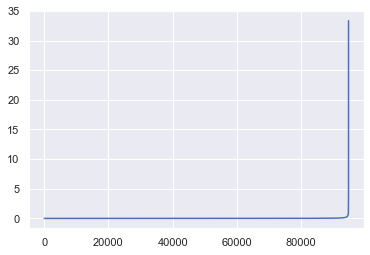

In [195]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=3)
nbrs = neigh.fit(X4_scaled)
distances, indices = nbrs.kneighbors(X4_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances);

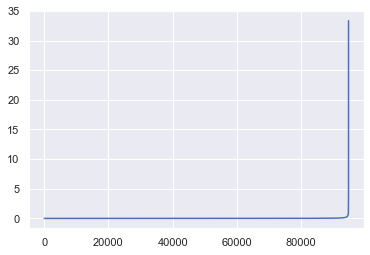

In [196]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=5)
nbrs = neigh.fit(X4_scaled)
distances, indices = nbrs.kneighbors(X4_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances);

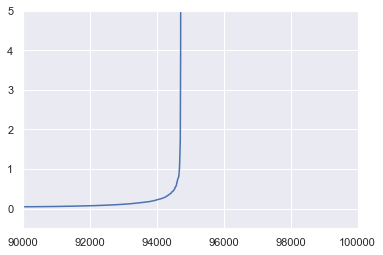

In [197]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=5)
nbrs = neigh.fit(X4_scaled)
distances, indices = nbrs.kneighbors(X4_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.ylim(-0.5, 5)
plt.xlim(90000, 100000)
plt.plot(distances);

In [ ]:
from sklearn.cluster import DBSCAN

labels = DBSCAN(eps = 1, min_samples=5).fit_predict(X4_scaled)

In [ ]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 5 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

## 4) b) clustering With 5 features dataframe - orders, satisfaction and comments features :

### KMeans clustering

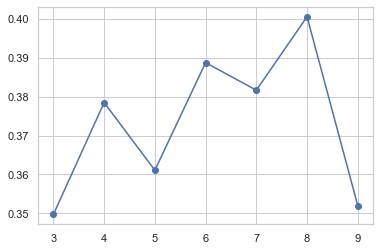

In [462]:
# Calculate silhouette scores for different number of clusters with Kmeans clustering
# on entire dataset
from sklearn.cluster import KMeans
from sklearn import metrics

silhouettes = []

for num_clusters in range(3, 11):
    cls = KMeans(n_clusters = num_clusters,
                 n_init = 10, 
                 init = 'k-means++')
    cls.fit(X5_scaled)
    silh = metrics.silhouette_score(X5_scaled, cls.labels_)
    silhouettes.append(silh)

plt.plot(range(3,11), silhouettes, marker = 'o');

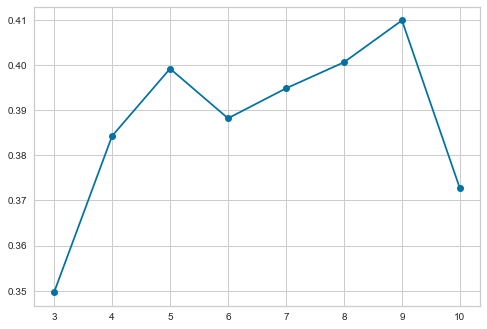

In [497]:
# Calculate silhouette scores for different number of clusters with Kmeans clustering
# on entire dataset
from sklearn.cluster import KMeans
from sklearn import metrics

silhouettes = []

for num_clusters in range(3, 11):
    cls = KMeans(n_clusters = num_clusters,
                 n_init = 10, 
                 init = 'k-means++')
    cls.fit(X5_scaled)
    silh = metrics.silhouette_score(X5_scaled, cls.labels_)
    silhouettes.append(silh)

plt.plot(range(3,11), silhouettes, marker = 'o');

In [463]:
pip install yellowbrick

Note: you may need to restart the kernel to use updated packages.


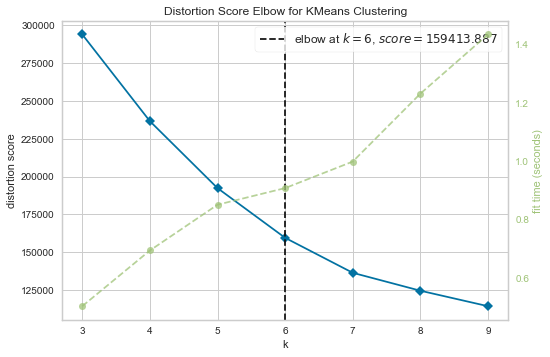

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [464]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(3,10))

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

In [468]:
# Run local implementation of kmeans
km = KMeans(n_clusters = 6, 
            max_iter = 300,
            n_init = 10,
            init = 'k-means++')
km.fit(X5_scaled)

KMeans(n_clusters=6)

In [469]:
labels_k_means = km.labels_
data_5['labels_kmeans'] = labels_k_means

In [ ]:
plt.figure(figsize = (15,10))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 50, 75, 100]):
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results['tsne1'], 
                tsne_results['tsne2'], 
                c = data_5.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('Perplexity = '+ str(p))
    plt.colorbar()

plt.show()

In [475]:
list_feat_5

['number_of_purchases',
 'payments_total',
 'last_order_days',
 'review_score_mean',
 'percentage_of_review_comments']

In [476]:
list_feat_5_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'percentage_of_review_comments',
                         'labels_kmeans']

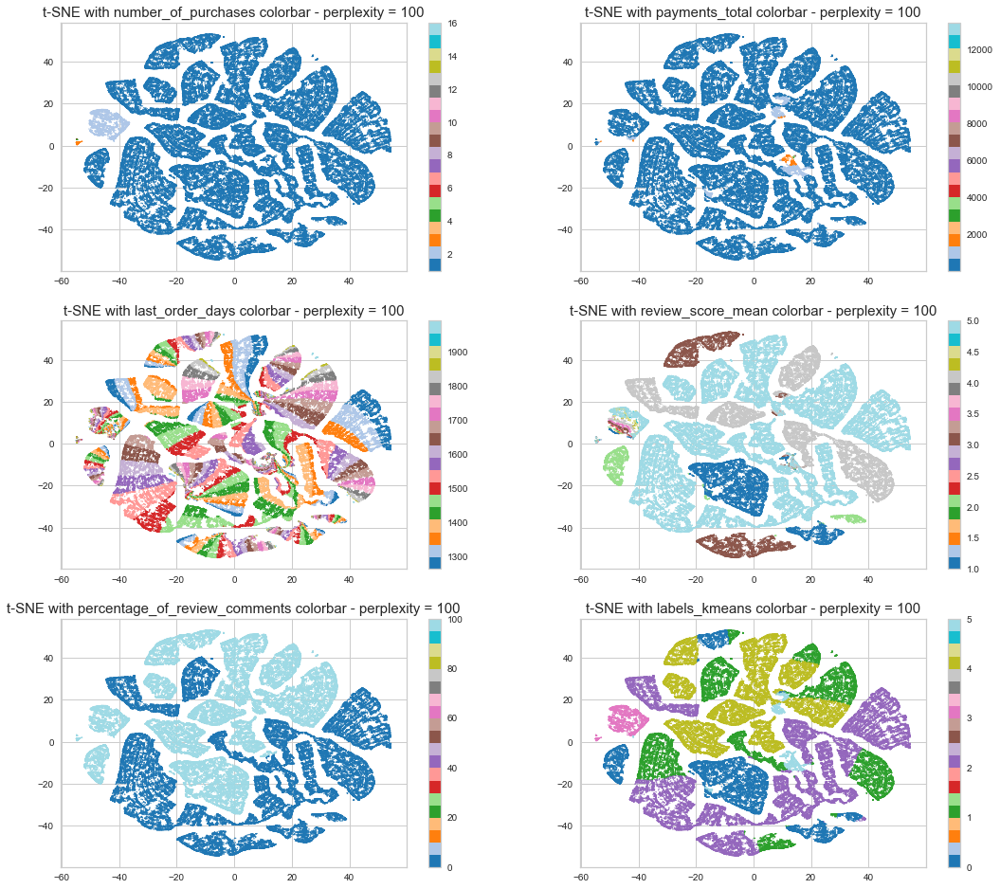

In [478]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_5_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_5.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100', size = 15)
    plt.colorbar()

plt.show()

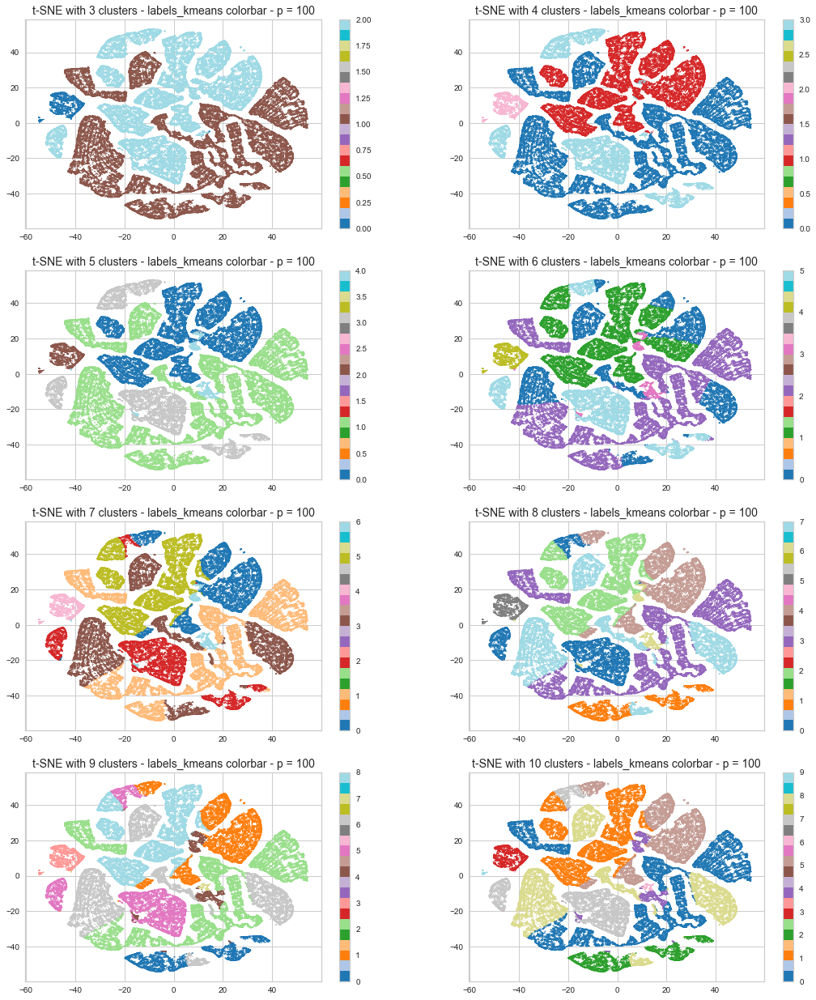

In [487]:
plt.figure(figsize = (18, 12))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, num_clusters in enumerate(range(3, 11)):
    km = KMeans(n_clusters = num_clusters,
                 max_iter = 300,
                 n_init = 10, 
                 init = 'k-means++')
    km.fit(X5_scaled)
    labels_k_means = km.labels_
    data_5['labels_kmeans'] = labels_k_means
    plt.subplot(4,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_5.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ str(num_clusters) + ' clusters - labels_kmeans colorbar - p = 100', size = 14)
    plt.colorbar()

plt.show()

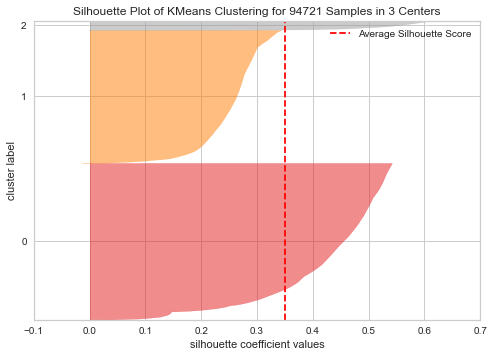

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 94721 Samples in 3 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [491]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 3,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 3 clusters - silhouette_score = ', visualizer.silhouette_score_)

In [493]:
visualizer.silhouette_score_

0.349684978133537

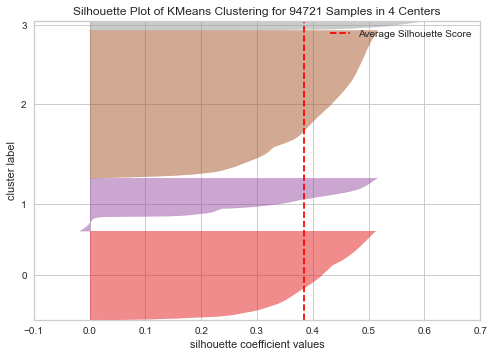

kmeans - 4 clusters - silhouette_score =  0.38426423700568674


In [494]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 4,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 4 clusters - silhouette_score = ', visualizer.silhouette_score_)

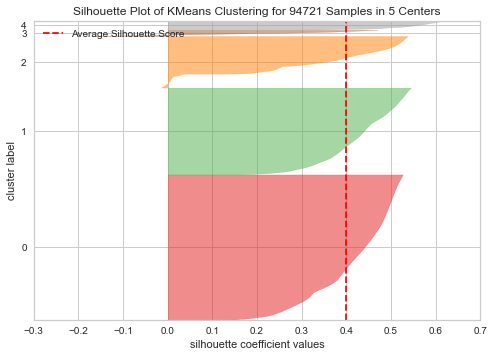

kmeans - 5 clusters - silhouette_score =  0.3991718767250251


In [495]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 5,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 5 clusters - silhouette_score = ', visualizer.silhouette_score_)

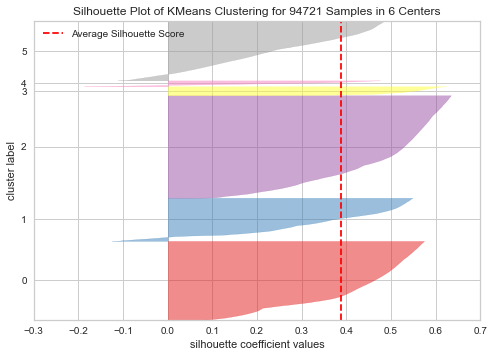

kmeans - 6 clusters - silhouette_score =  0.38877335271987995


In [496]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 6,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 6 clusters - silhouette_score = ', visualizer.silhouette_score_)

## 4) b) Hierarchical clustering

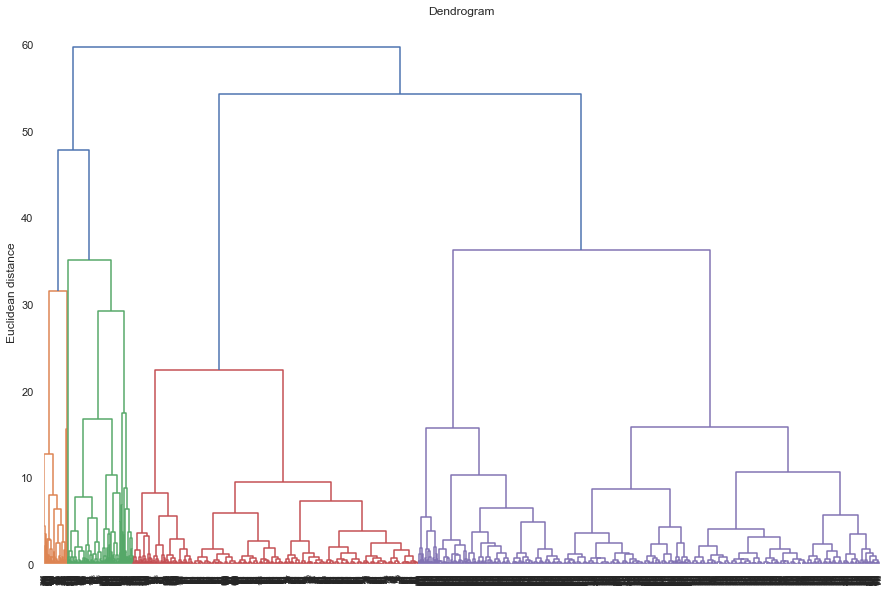

In [423]:
# Dendrogram on reduced dataset (number of purchases > 1)

from scipy.cluster.hierarchy import dendrogram , linkage

# Linkage Matrix
Z = linkage(X5_scaled, method = 'ward')
 
# plotting dendrogram
plt.figure(figsize = (18,8))
dendro = dendrogram(Z)
plt.title('Dendrogram')
plt.ylabel('Euclidean distance')
plt.show()

In [ ]:
# Dendrogram on entire dataset

from scipy.cluster.hierarchy import dendrogram , linkage

# Linkage Matrix
Z = linkage(X_scaled, method = 'ward')
 
# plotting dendrogram
plt.figure(figsize = (15,10))
dendro = dendrogram(Z)
plt.title('Dendrogram')
plt.ylabel('Euclidean distance')
plt.show()

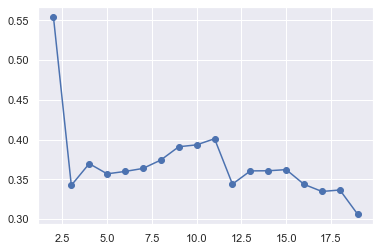

In [430]:
# Calculate silhouette scores for different number of clusters with AgglomerativeClustering
# On reduced dataset
from sklearn.cluster import AgglomerativeClustering

silhouettes = []

for num_clusters in range(2, 11):
    agg_clustering = AgglomerativeClustering(n_clusters = num_clusters, 
                                             affinity = 'euclidean', 
                                             linkage = 'ward')
    # predicting the labels
    agg_clustering = agg_clustering.fit(X5_scaled)
    silh = metrics.silhouette_score(X5_scaled, agg_clustering.labels_)
    silhouettes.append(silh)

plt.plot(range(2,11), silhouettes, marker='o');

In [227]:
agg_clustering = AgglomerativeClustering(n_clusters = 3,
                                         affinity = 'euclidean',
                                         linkage = 'ward')

# predicting the labels
agg_clustering = agg_clustering.fit(X_scaled)

labels = agg_clustering.labels_

In [228]:
labels

array([0, 1, 0, ..., 2, 1, 2], dtype=int64)

In [229]:
df['labels'] = labels

In [230]:
df

,number_of_purchases,payments_total,last_order_days,review_score_mean,percentage_of_review_comments,labels,labels2,labels3,labels4
customer,,,,,,,,,
00053a61a98854899e70ed204dd4bafe,2,382.0,1447,1.0,100.0,0,0,1,1
000bfa1d2f1a41876493be685390d6d3,2,70.0,1599,4.5,50.0,1,5,0,0
000de6019bb59f34c099a907c151d855,2,229.8,1642,2.0,100.0,0,0,1,1
000fbf0473c10fc1ab6f8d2d286ce20c,4,285.8,1299,5.0,0.0,1,5,0,0
001147e649a7b1afd577e873841632dd,2,170.0,1628,4.0,0.0,1,4,0,0
...,...,...,...,...,...,...,...,...,...
ffe96201d466b0e0dc8139850be29d5d,2,59.8,1309,5.0,0.0,1,5,0,0
fff22793223fe80c97a8fd02ac5c6295,3,66.0,1329,5.0,0.0,1,5,0,0
fff5eb4918b2bf4b2da476788d42051c,6,1050.0,1323,5.0,100.0,2,1,2,2


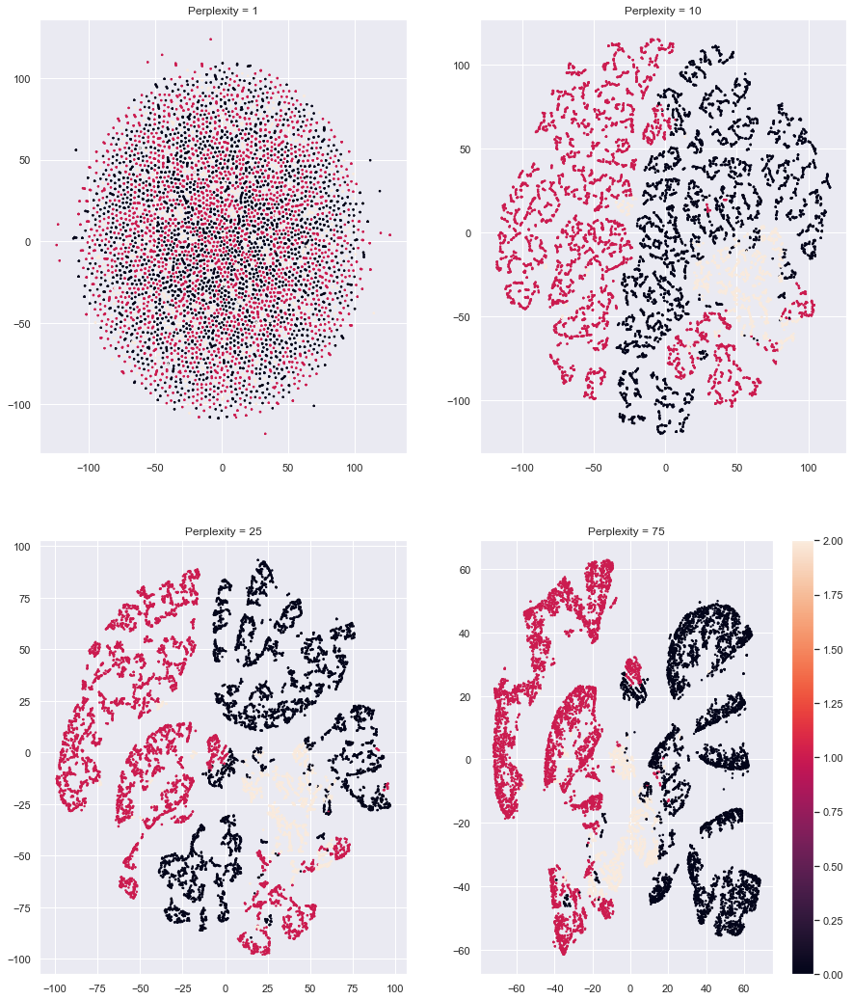

In [183]:
plt.figure(figsize = (15,10))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=0)
    tsne_results = tsne.fit_transform(X_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df.get('labels'), s=2)
    plt.title('Perplexity = '+ str(p))

plt.colorbar()
    
plt.show()

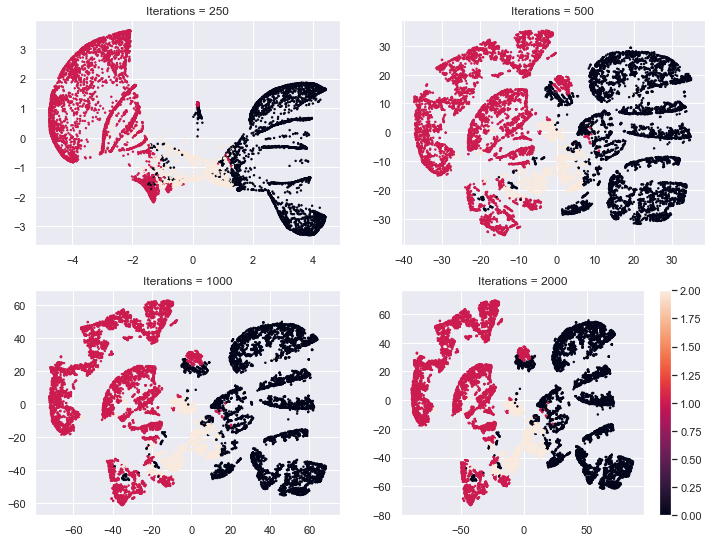

In [234]:
plt.figure(figsize = (12,5))
plt.subplots_adjust(top = 1.5)

for index, n_iter in enumerate([250, 500, 1000, 2000]):

    tsne = TSNE(n_components = 2, perplexity = 75, n_iter = n_iter, random_state=0)
    tsne_results = tsne.fit_transform(X_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df.get('labels'), s=2)
    plt.title('Iterations = '+ str(n_iter))

plt.colorbar()
    
plt.show()

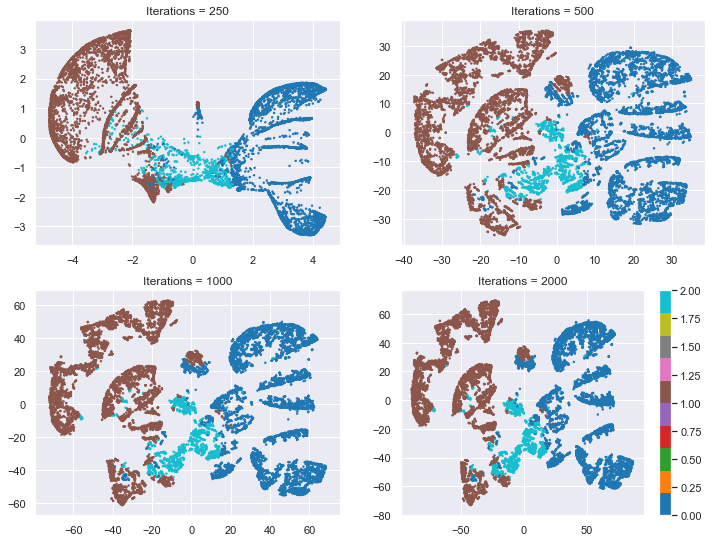

In [237]:
plt.figure(figsize = (12,5))
plt.subplots_adjust(top = 1.5)

for index, n_iter in enumerate([250, 500, 1000, 2000]):

    tsne = TSNE(n_components = 2, perplexity = 75, n_iter = n_iter, random_state=0)
    tsne_results = tsne.fit_transform(X_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df.get('labels'), cmap = 'tab10', s=2)
    plt.title('Iterations = '+ str(n_iter))

plt.colorbar()
    
plt.show()

In [184]:
from sklearn.cluster import AgglomerativeClustering

agg_clustering = AgglomerativeClustering(n_clusters = 10, affinity = 'euclidean', linkage = 'ward')
 
#predicting the labels
 
agg_clustering = agg_clustering.fit(X_scaled)
 
labels = agg_clustering.labels_

In [185]:
labels

array([0, 5, 0, ..., 1, 4, 3], dtype=int64)

In [186]:
df['labels2'] = labels

In [187]:
df

,number_of_purchases,payments_total,last_order_days,review_score_mean,percentage_of_review_comments,labels,labels2
customer,,,,,,,
00053a61a98854899e70ed204dd4bafe,2,382.0,1447,1.0,100.0,0,0
000bfa1d2f1a41876493be685390d6d3,2,70.0,1599,4.5,50.0,1,5
000de6019bb59f34c099a907c151d855,2,229.8,1642,2.0,100.0,0,0
000fbf0473c10fc1ab6f8d2d286ce20c,4,285.8,1299,5.0,0.0,1,5
001147e649a7b1afd577e873841632dd,2,170.0,1628,4.0,0.0,1,4
...,...,...,...,...,...,...,...
ffe96201d466b0e0dc8139850be29d5d,2,59.8,1309,5.0,0.0,1,5
fff22793223fe80c97a8fd02ac5c6295,3,66.0,1329,5.0,0.0,1,5
fff5eb4918b2bf4b2da476788d42051c,6,1050.0,1323,5.0,100.0,2,1


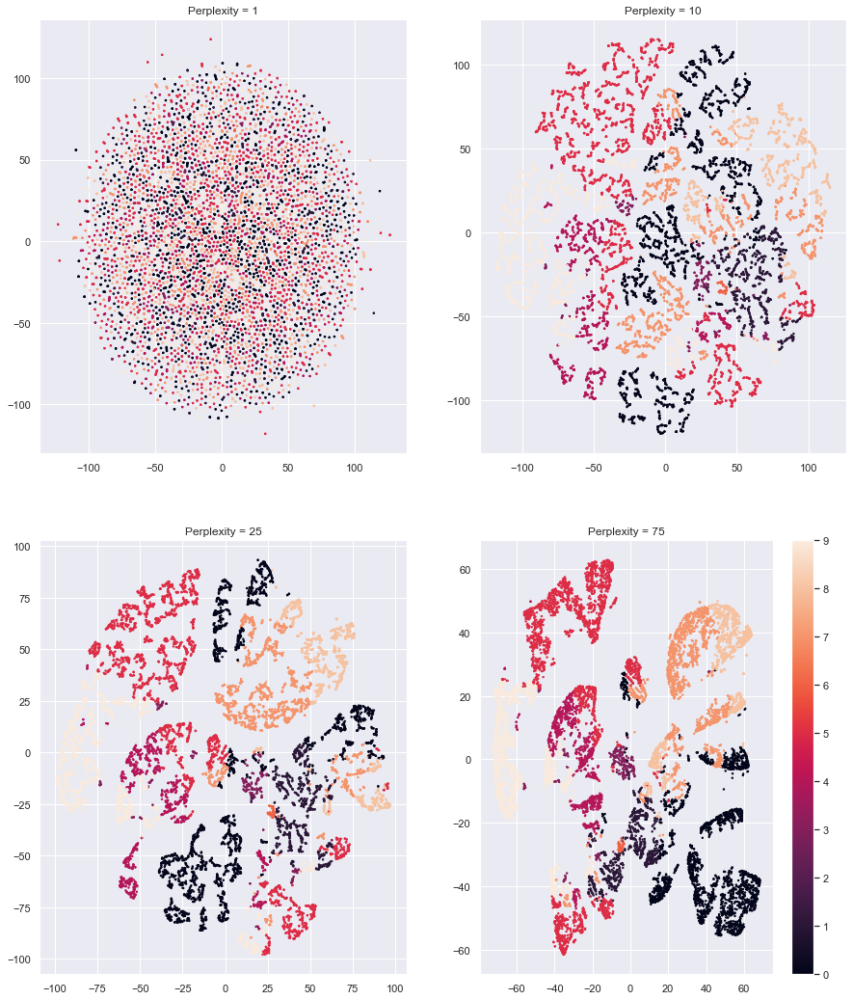

In [188]:
plt.figure(figsize = (15,10))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=0)
    tsne_results = tsne.fit_transform(X_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df.get('labels2'), s=2)
    plt.title('Perplexity = '+ str(p))

plt.colorbar()
    
plt.show()

### k-means

In [191]:
from sklearn.cluster import KMeans, SpectralClustering
from sklearn.metrics import silhouette_samples, silhouette_score

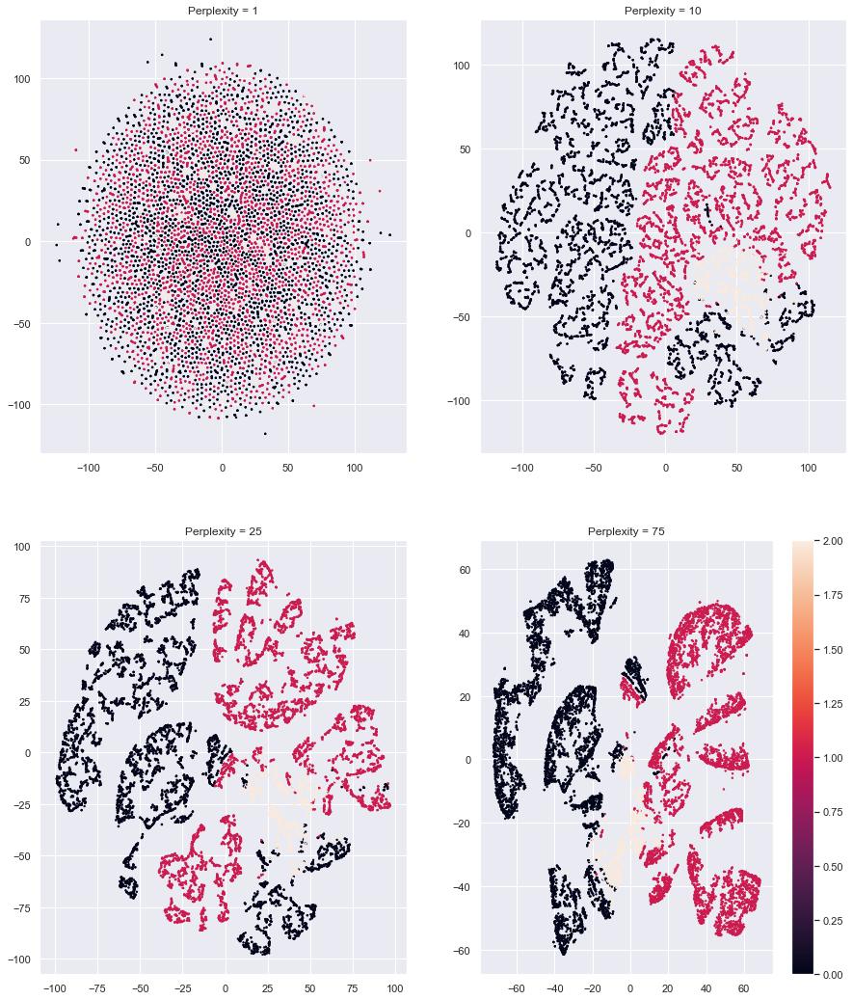

In [201]:
# Run local implementation of kmeans
km = KMeans(n_clusters=3, max_iter=100, init = 'k-means++')
km.fit(X_scaled)

labels_k_means2 = km.labels_

df['labels4'] = labels_k_means2

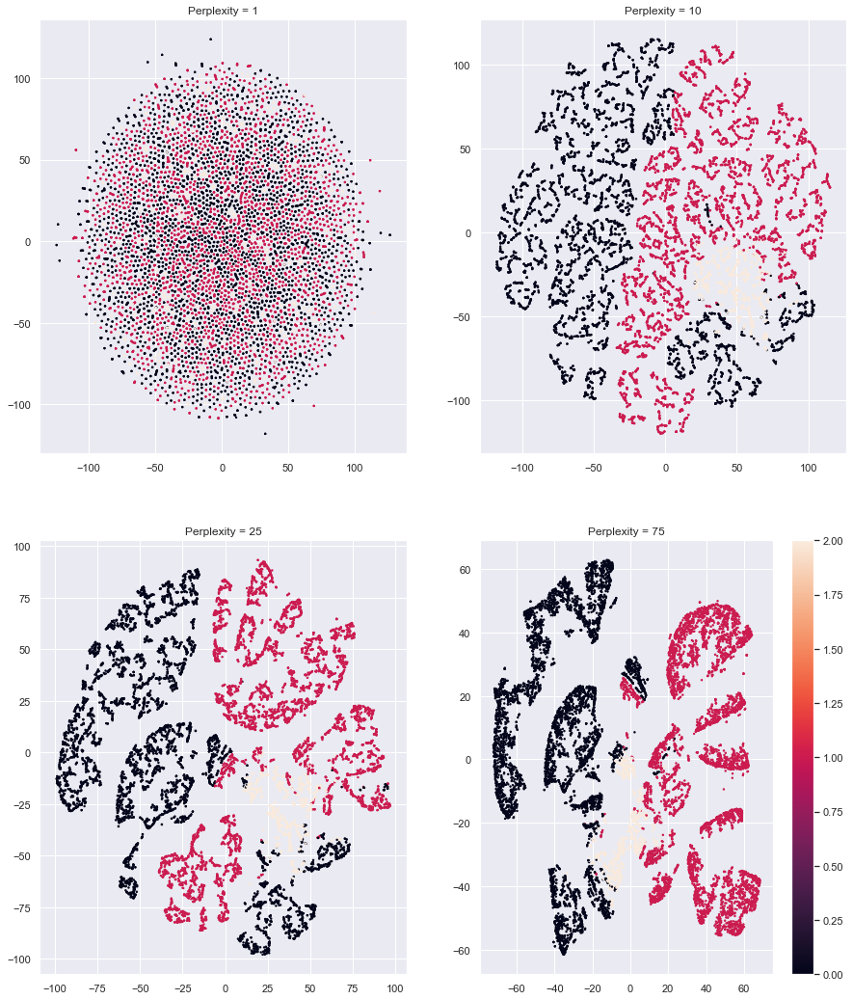

In [202]:
plt.figure(figsize = (15,10))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=0)
    tsne_results = tsne.fit_transform(X_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df.get('labels4'), s=2)
    plt.title('Perplexity = '+ str(p))

plt.colorbar()
    
plt.show()

### DBSCAN

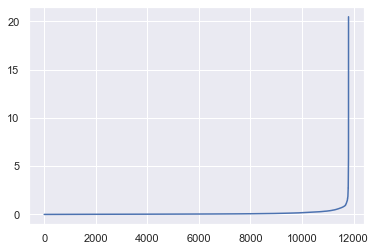

In [208]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_scaled)
distances, indices = nbrs.kneighbors(X_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances);

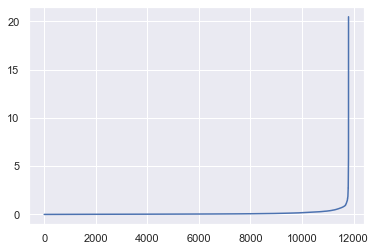

In [209]:
neigh = NearestNeighbors(n_neighbors=3)
nbrs = neigh.fit(X_scaled)
distances, indices = nbrs.kneighbors(X_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances);

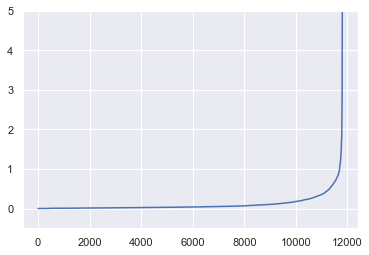

In [212]:
neigh = NearestNeighbors(n_neighbors=5)
nbrs = neigh.fit(X_scaled)
distances, indices = nbrs.kneighbors(X_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.ylim(-0.5, 5)
plt.plot(distances);

In [213]:
from sklearn.cluster import DBSCAN

labels = DBSCAN(eps = 1, min_samples=5).fit_predict(X_scaled)

In [214]:
labels

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

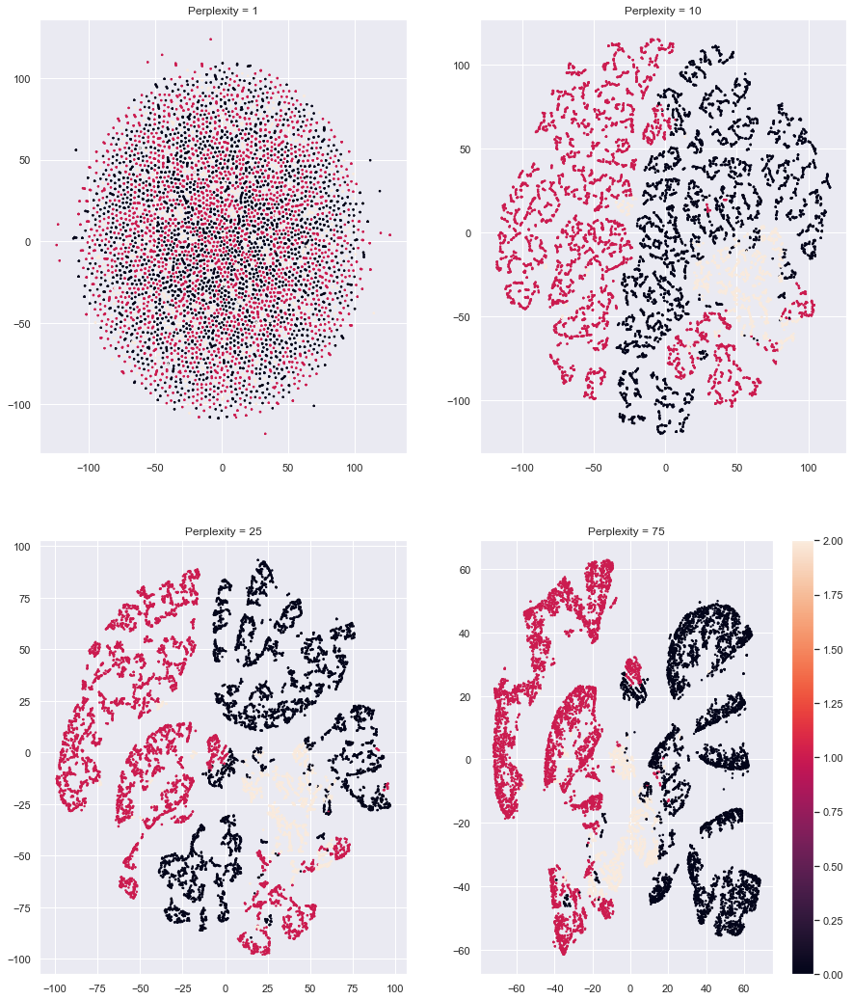

In [217]:
plt.figure(figsize = (15,10))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=0)
    tsne_results = tsne.fit_transform(X_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df.get('labels'), s=2)
    plt.title('Perplexity = '+ str(p))

plt.colorbar()
    
plt.show()

TypeError: text() missing 1 required positional argument: 's'

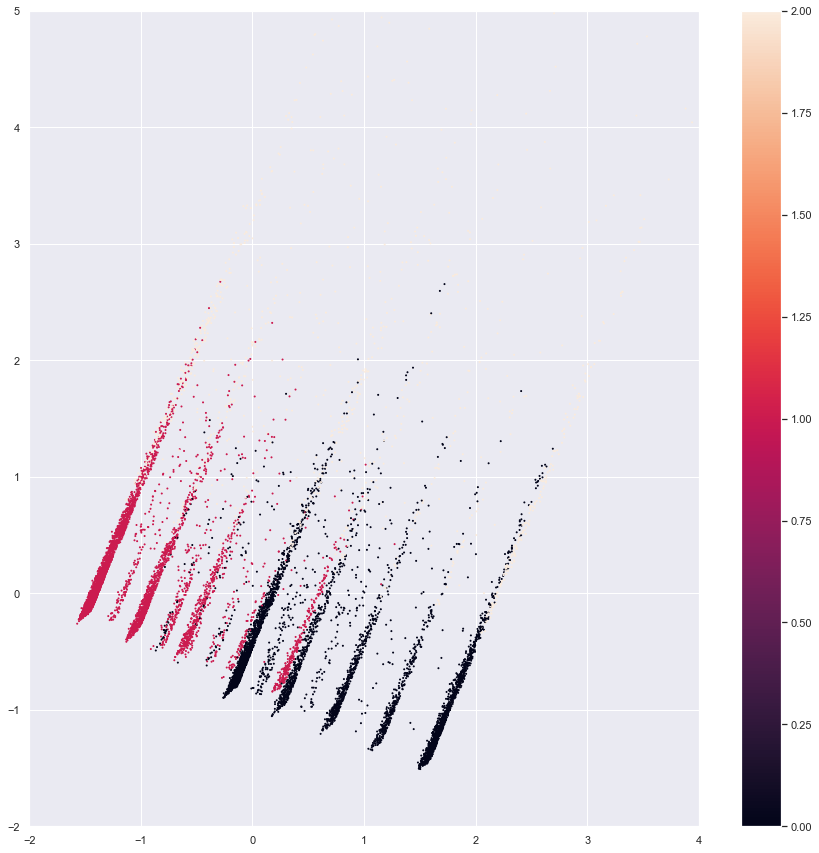

In [218]:
fig = plt.figure(figsize=(15, 15))

# Afficher chaque observation
plt.scatter(X_projected[:, 0], 
            X_projected[:, 1],
            s = 1,
            # Colorer en utilisant la variable 'last_order_days'
            c = df.get('labels'))

plt.colorbar()

plt.xlim([-2, 4])
plt.ylim([-2, 5])

for i, (x, y) in enumerate(zip(X_projected[:, 0],
                               X_projected[:, 1])):
    plt.text(x, y)

In [219]:
# 3. Évaluation
# Pour l’évaluation intrinsèque, je choisis le coefficient de silhouette :
from sklearn import metrics
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_scaled, labels))

Silhouette Coefficient: 0.360


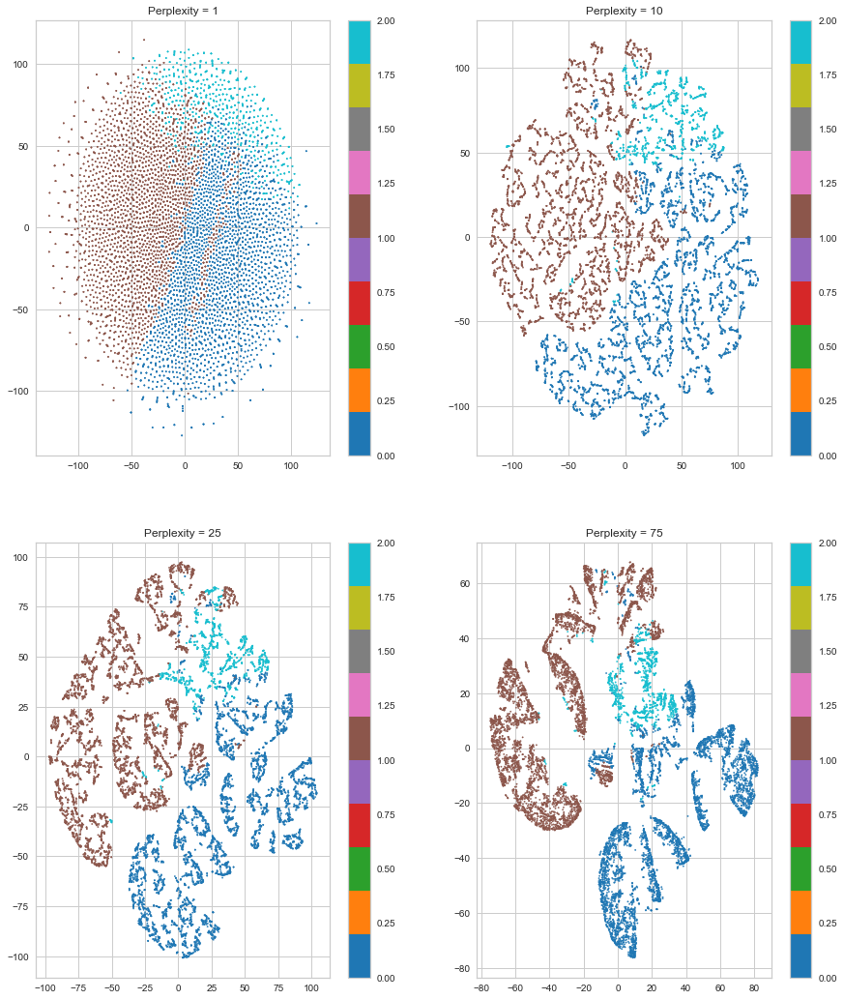

In [253]:
# tSNE initialisée par pca
plt.figure(figsize = (15,10))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, init = 'pca', random_state=0)
    tsne_results = tsne.fit_transform(X_scaled)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df.get('labels'), cmap = 'tab10', s=2)
    plt.title('Perplexity = '+ str(p))
    plt.colorbar()
    
plt.show()

### Locally Linear Embedding

In [256]:
from sklearn.manifold import LocallyLinearEmbedding as LLE # for LLE dimensionality reduction

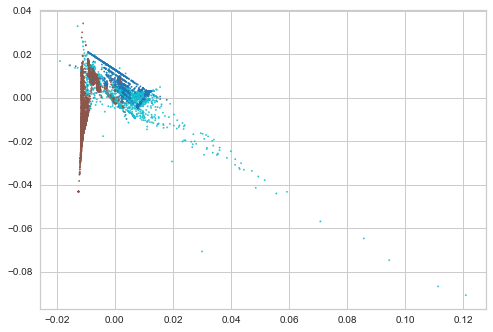

In [265]:
embedding = LLE(n_components=2)

X_transformed = embedding.fit_transform(X_scaled)

plt.scatter(X_transformed[:, 0], X_transformed[:, 1], c=df.get('labels'), cmap='tab10', s=2)

plt.show()